![no smoking](https://images.unsplash.com/photo-1570039227212-8f057f4751e4?ixlib=rb-4.0.3&ixid=MnwxMjA3fDB8MHxwaG90by1wYWdlfHx8fGVufDB8fHx8&auto=format&fit=crop&w=1170&q=80)

# Signal of Smoking Classification  [WORK IN PROGRESS]

## The Objective

The reason for correctly classifying smokers and non-smokers generally is to better understand the relationship between smoking and various health outcomes. Smoking is a significant risk factor for a range of health conditions, including lung cancer, heart disease, stroke, respiratory diseases, and many others. Accurately identifying smokers and non-smokers allows researchers to study the impact of smoking on health outcomes in a more accurate and precise manner. This, in turn, can help guide public health interventions aimed at reducing smoking rates and preventing related health problems.

In addition to the health implications, correctly classifying smokers and non-smokers can also have practical implications. For example, insurance companies may charge higher premiums to smokers due to their increased risk of health problems, and employers may choose not to hire smokers due to concerns about productivity etc.

It is generally more important to correctly identify smokers than non-smokers, because the health risks associated with smoking are much greater than the risks associated with not smoking. However, it is also important to minimize the number of false alarms (misclassifying non-smokers as smokers). False alarms can have negative consequences, such as stigmatizing individuals who do not smoke or causing unnecessary anxiety.

Therefore, the ideal approach would be to aim for high accuracy in both identifying smokers and non-smokers, while also minimizing false alarms. This can be achieved through the use of machine learning algorithms that are optimized to balance sensitivity or recall (identifying true smokers) and specificity (avoiding false alarms).

## Problem Statement and Motivation

I believe the reason why I picked this particular dataset was the fact that I was genuinely interested in what it is about the person that reveals whether they are a smoker or not with so many smokers around nowadays. Throughout the whole process of exploring the dataset I was questioning myself whether the characteristics that caught my eye would make sense in general, not just for a  given dataset. It turned out that some of them are not quite representative since we have an unbalanced dataset and we can not really tell whether the dataset is to blame or is it something unique to this particular population of people or, hopefully, something even more general that points to much deeper relationships than these that we know of. Yet, fortunately, most of the signals are in accord with what we know and do make sense. The end goal was to build a good model, which recognizes the habit of smoking in people. 

The outline of my work looked roughly like this.
First of all, it was exploring the data using visualization tools, checking its sanity and drawing conclusions from the plots. Then, I performed the spot-checking to get a grasp of what type of classification models might be a good match for the problem at hand. Finally, I've done some fine-tuning for chosen models and compared them at the very end of the notebook. 

## Brief Summary

**The highest accuracy that was reached is 77.34% using Random Forest model at 0.732 recall and 0.677 precision.**  This model turns out to perform better than any other presented, though all the accuracies actually are roughly in the range from 73% to 78%. That said,  **Random Forest**  outperforms any other model, followed right after by Extra Trees, KNN, and Bagging Classifier.

## Table of Contents:

1. [Imports and Essential Functions](#imports)
2. [Loading the Data](#load)
3. [Exploratory Data Analysis](#eda)
   * Correlation plot, Pie charts, Distribution plots, Box and Whisker plots, Histograms, Violin plots, Strip plots, Bar plots.
4. [Train-Test Split](#split)
5. [Spot-Checking](#spotcheck)
    1. [Baseline Models](#basemodel)
    2. [Outlier Detection](#outlier)
    3. [Scaling the Data](#scale)
    4. [Removal of High-correlated Features](#corr)
    5. [Feature Importances](#imp)
6. [Building and Fine-Tuning the Models](#tune)
    1. [Logistic Regression](#logreg)
        * Performance Measures: accuracy, precision/recall curves, the ROC curve, confusion matrix
        * Learning Сurves
        * Calculating and Setting Thresholds to Optimise Logistic Regression Performance
    2. [Stochastic Gradient Descent](#sgd)
        * Performance Measures: accuracy, precision/recall curves, the ROC curve, confusion matrix
        * Learning Сurves
        * Adjusting the Threshold to Optimise SGD Performance
    3. [K-Nearest Neighbors](#knn)
        * Performance Measures: accuracy, precision/recall curves, the ROC curve, confusion matrix
        * Learning Сurves
        * Recursive Feature Elimination
        * Choosing the Optimal Number of Neighbors
    4. [CART (Classification And Regression Trees)](#cart)
        * Performance Measures: accuracy, precision/recall curves, the ROC curve, confusion matrix
        * Learning Curves
        * Recursive Feature Elimination
        * Pruning CART to Optimise the Performance
    5. [AdaBoost](#ada)
        * Performance Measures: accuracy, precision/recall curves, the ROC curve, confusion matrix
        * Learning Curves
        * Exploring the Hyperparameters
    6. [Random Forest](#rf)
        * Performance Measures: accuracy, precision/recall curves, the ROC curve, confusion matrix
        * Learning Curves
        * Exploring the Hyperparameters using the OOB Error Rate
        * Recursive Feature Elimination
    7. [Extra-Trees](#et)
        * Performance Measures: accuracy, precision/recall curves, the ROC curve, confusion matrix
        * Learning Curves
        * Recursive Feature Elimination
        * Exploring the Hyperparameters
        * Adjusting the Threshold
    8. [Bagging Classifier](#bagging)
        * Performance Measures: accuracy, precision/recall curves, the ROC curve, confusion matrix
        * Learning Curves
        * Recursive Feature Elimination
        * Exploring the Hyperparameters    
7. [Conclusions](#conclude)
8. [Limitations and Future Work](#limits_future)

## About the [Dataset](https://www.kaggle.com/datasets/kukuroo3/body-signal-of-smoking)

<!-- Health checkup information is open data consisting of the results of general health checkups of employees of the National Health Insurance, dependents over the age of 40, regional members who are heads of households, and regional members over the age of 40, and basic information (sex, age range, trial code, etc.) and checkup details (height, weight, total cholesterol, hemoglobin, etc.) of 40 million people who have a history of life-changing health checkups that those who have reached the age of 66 and 100 among those subject to general health checkups. -->

This dataset is a collection of basic health biological signal data from results of general health checkups.
The goal is to determine the presence or absence of smoking habit through bio-signals.

data shape : (55692, 27)

The features of the dataset:

* ID : serial number given to a person.
* gender: the gender of a person being either female(0) or male(1).
* age : 5-years gap age groups.
* height(cm)
* weight(kg)
* waist(cm) : Waist circumference length
* eyesight(left): Denoted by a value between 0.1-2.5, or 9.9
* eyesight(right): Denoted by a value between 0.1-2.5, or 9.9
* hearing(left): hearing of the person's ear (1 - normal, 2 - abnormal)
* hearing(right): hearing of the person's ear (1 - normal, 2 - abnormal)
* systolic : blood pressure.
* relaxation : blood pressure.
* fasting blood sugar: blood sugar before meals level
* Cholesterol : total
* triglyceride
* HDL : cholesterol type
* LDL : cholesterol type
* hemoglobin
* Urine protein
* serum creatinine
* AST : glutamic oxaloacetic transaminase type
* ALT : glutamic oxaloacetic transaminase type
* Gtp : γ-GTP
* oral : Oral Examination status (s whether the examinee accepted the oral examination).
* dental caries
* tartar : tartar status
* smoking: smoking status of a person (1 - smoking, 0 - non-smoking) 

<a id="imports"></a>
# 1. Imports and Essential Functions

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib as mpl
import seaborn as sns
import sklearn
import tensorflow
import plotly.offline as py
import plotly.graph_objs as go
import warnings

# Import models
from sklearn.linear_model import LogisticRegression, SGDClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import SVC
from sklearn.naive_bayes import GaussianNB
from sklearn.ensemble import AdaBoostClassifier, RandomForestClassifier
from sklearn.ensemble import ExtraTreesClassifier, GradientBoostingClassifier
from sklearn.ensemble import IsolationForest
from sklearn.ensemble import BaggingClassifier

# Import metrics etc.
from sklearn.model_selection import GridSearchCV, learning_curve, StratifiedShuffleSplit
from sklearn.model_selection import StratifiedKFold, cross_val_score,cross_val_predict
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.pipeline import Pipeline
from sklearn.decomposition import PCA
from sklearn.metrics import confusion_matrix, accuracy_score, precision_score 
from sklearn.metrics import f1_score, recall_score, precision_recall_curve
from sklearn.metrics import roc_curve, roc_auc_score
from sklearn.metrics import classification_report
from collections import OrderedDict
from sklearn.feature_selection import RFECV, RFE
from sklearn.linear_model import Perceptron
from abc import ABC, abstractmethod
from sklearn.base import BaseEstimator, ClassifierMixin

# Visualizations
plt.style.use('bmh')
mpl.rc('axes', labelweight='ultralight', titleweight='bold', labelsize=10, )

# Configure Plotly to be rendered inline in the notebook.
py.init_notebook_mode()

# Supressing Depreciation Warning that arises when 'bmh' style is used.
warnings.filterwarnings("ignore", category=DeprecationWarning)

# Stable results across multiple notebook runs.
SEED = 19
cv = StratifiedKFold(n_splits=10, shuffle=True, random_state=SEED)

def description(data):
    '''
    Returns the DataFrame representing a thorough description of the data.
    '''
    dtypes = data.dtypes
    counts = data.apply(lambda col: col.count())
    nulls = data.apply(lambda col: col.isnull().sum())
    nan_ratio = nulls / counts
    uniques = data.apply(lambda col: col.unique())
    n_uniques = data.apply(lambda col: col.nunique())
    maxs = data.apply(lambda col: col.max())
    mins = data.apply(lambda col: col.min())
    
    cols = {'dtypes':dtypes, 'counts':counts, 'nulls' : nulls, 'nan_ratio': nan_ratio,
            'max':maxs, 'min':mins,'n_uniques':n_uniques, 'uniques':uniques}
    return pd.DataFrame(data=cols)

<a id="load"></a>
# 2. Loading the Data

In [2]:
smoking_ = pd.read_csv("/kaggle/input/body-signal-of-smoking/smoking.csv", index_col='ID')

# Make a copy of the original dataset.
smoking = smoking_.copy()

In [3]:
smoking.T

ID,0,1,2,3,4,5,6,7,9,10,...,55655,55663,55666,55671,55673,55676,55681,55683,55684,55691
gender,F,F,M,M,F,M,M,M,F,M,...,M,M,M,M,F,F,F,F,M,M
age,40,40,55,40,40,30,40,45,50,45,...,20,40,40,40,60,40,45,55,60,55
height(cm),155,160,170,165,155,180,160,165,150,175,...,175,180,170,170,150,170,160,160,165,160
weight(kg),60,60,60,70,60,75,60,90,60,75,...,75,85,65,80,50,65,50,50,60,65
waist(cm),81.3,81.0,80.0,88.0,86.0,85.0,85.5,96.0,85.0,89.0,...,85.0,86.5,85.0,90.5,75.0,75.0,70.0,68.5,78.0,85.0
eyesight(left),1.2,0.8,0.8,1.5,1.0,1.2,1.0,1.2,0.7,1.0,...,0.9,1.2,1.2,1.2,1.0,0.9,1.2,1.0,0.8,0.9
eyesight(right),1.0,0.6,0.8,1.5,1.0,1.2,1.0,1.0,0.8,1.0,...,1.5,1.2,1.2,1.5,1.2,0.9,1.2,1.2,1.0,0.7
hearing(left),1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,...,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
hearing(right),1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,...,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
systolic,114.0,119.0,138.0,100.0,120.0,128.0,116.0,153.0,115.0,113.0,...,118.0,116.0,106.0,130.0,102.0,110.0,101.0,117.0,133.0,124.0


In [4]:
# Change the column names to the more convinient ones.
smoking.rename(columns={'height(cm)':'height', 'weight(kg)':'weight','waist(cm)':'waist',
                        'eyesight(left)':'eyesight_left', 'eyesight(right)':'eyesight_right',
                        'hearing(left)':'hearing_left', 'hearing(right)':'hearing_right',
                        'fasting blood sugar':'fasting_blood_sugar',  'Cholesterol':'cholesterol', 
                        'HDL':'hdl','LDL':'ldl','Urine protein':'urine_protein', 
                        'serum creatinine':'serum_creatinine', 'AST':'ast','ALT':'alt',
                        'Gtp':'gtp', 'dental caries' : 'dental_caries'}, inplace=True)

In [5]:
smoking.shape

(55692, 26)

In [6]:
smoking.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 55692 entries, 0 to 55691
Data columns (total 26 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   gender               55692 non-null  object 
 1   age                  55692 non-null  int64  
 2   height               55692 non-null  int64  
 3   weight               55692 non-null  int64  
 4   waist                55692 non-null  float64
 5   eyesight_left        55692 non-null  float64
 6   eyesight_right       55692 non-null  float64
 7   hearing_left         55692 non-null  float64
 8   hearing_right        55692 non-null  float64
 9   systolic             55692 non-null  float64
 10  relaxation           55692 non-null  float64
 11  fasting_blood_sugar  55692 non-null  float64
 12  cholesterol          55692 non-null  float64
 13  triglyceride         55692 non-null  float64
 14  hdl                  55692 non-null  float64
 15  ldl                  55692 non-null 

In [7]:
description(smoking)

,dtypes,counts,nulls,nan_ratio,max,min,n_uniques,uniques
gender,object,55692,0,0.0,M,F,2,"[F, M]"
age,int64,55692,0,0.0,85,20,14,"[40, 55, 30, 45, 50, 35, 60, 25, 65, 20, 80, 7..."
height,int64,55692,0,0.0,190,130,13,"[155, 160, 170, 165, 180, 150, 175, 140, 185, ..."
weight,int64,55692,0,0.0,135,30,22,"[60, 70, 75, 90, 65, 45, 55, 50, 85, 80, 100, ..."
waist,float64,55692,0,0.0,129.0,51.0,566,"[81.3, 81.0, 80.0, 88.0, 86.0, 85.0, 85.5, 96...."
eyesight_left,float64,55692,0,0.0,9.9,0.1,19,"[1.2, 0.8, 1.5, 1.0, 0.7, 0.9, 0.3, 0.2, 0.1, ..."
eyesight_right,float64,55692,0,0.0,9.9,0.1,17,"[1.0, 0.6, 0.8, 1.5, 1.2, 0.7, 0.4, 0.9, 0.3, ..."
hearing_left,float64,55692,0,0.0,2.0,1.0,2,"[1.0, 2.0]"
hearing_right,float64,55692,0,0.0,2.0,1.0,2,"[1.0, 2.0]"
systolic,float64,55692,0,0.0,240.0,71.0,130,"[114.0, 119.0, 138.0, 100.0, 120.0, 128.0, 116..."


In [8]:
smoking.describe().T

,count,mean,std,min,25%,50%,75%,max
age,55692.0,44.182917,12.071418,20.0,40.0,40.0,55.0,85.0
height,55692.0,164.649321,9.194597,130.0,160.0,165.0,170.0,190.0
weight,55692.0,65.864936,12.820306,30.0,55.0,65.0,75.0,135.0
waist,55692.0,82.046418,9.274223,51.0,76.0,82.0,88.0,129.0
eyesight_left,55692.0,1.012623,0.486873,0.1,0.8,1.0,1.2,9.9
eyesight_right,55692.0,1.007443,0.485964,0.1,0.8,1.0,1.2,9.9
hearing_left,55692.0,1.025587,0.157902,1.0,1.0,1.0,1.0,2.0
hearing_right,55692.0,1.026144,0.159564,1.0,1.0,1.0,1.0,2.0
systolic,55692.0,121.494218,13.675989,71.0,112.0,120.0,130.0,240.0
relaxation,55692.0,76.004830,9.679278,40.0,70.0,76.0,82.0,146.0


So far our data contains no null values among all 55692 rows. The dataset consists of 26 features (excluding the ID column) with majority of them having numerical values. There are 3 categorical features, namely `gender`, `oral`, and `tartar`. In this specific dataset, the `oral` column has the same value for any row in the dataset, so we'll drop this column, because it won't give our future models any helpful information.

Then, there are some features such as `age`, `height`, `width` that represent the groups of the corresponding characteristics. There is nothing eye-catching about other features, at this stage at least.

In [9]:
smoking.drop('oral', axis=1,inplace=True)

To get the most of our data in EDA part, let's replace categorical values in `gender`, `tartar` columns with dummies.

In [10]:
from sklearn.preprocessing import LabelEncoder

for col in ['gender','tartar']:
    smoking[col] = LabelEncoder().fit_transform(smoking[col])

smoking.head(10)

,gender,age,height,weight,waist,eyesight_left,eyesight_right,hearing_left,hearing_right,systolic,...,ldl,hemoglobin,urine_protein,serum_creatinine,ast,alt,gtp,dental_caries,tartar,smoking
ID,,,,,,,,,,,,,,,,,,,,,
0,0,40,155,60,81.3,1.2,1.0,1.0,1.0,114.0,...,126.0,12.9,1.0,0.7,18.0,19.0,27.0,0,1,0
1,0,40,160,60,81.0,0.8,0.6,1.0,1.0,119.0,...,127.0,12.7,1.0,0.6,22.0,19.0,18.0,0,1,0
2,1,55,170,60,80.0,0.8,0.8,1.0,1.0,138.0,...,151.0,15.8,1.0,1.0,21.0,16.0,22.0,0,0,1
3,1,40,165,70,88.0,1.5,1.5,1.0,1.0,100.0,...,226.0,14.7,1.0,1.0,19.0,26.0,18.0,0,1,0
4,0,40,155,60,86.0,1.0,1.0,1.0,1.0,120.0,...,107.0,12.5,1.0,0.6,16.0,14.0,22.0,0,0,0
5,1,30,180,75,85.0,1.2,1.2,1.0,1.0,128.0,...,129.0,16.2,1.0,1.2,18.0,27.0,33.0,0,1,0
6,1,40,160,60,85.5,1.0,1.0,1.0,1.0,116.0,...,157.0,17.0,1.0,0.7,21.0,27.0,39.0,1,1,1
7,1,45,165,90,96.0,1.2,1.0,1.0,1.0,153.0,...,134.0,15.0,1.0,1.3,38.0,71.0,111.0,0,1,0
9,0,50,150,60,85.0,0.7,0.8,1.0,1.0,115.0,...,149.0,13.7,1.0,0.8,31.0,31.0,14.0,0,0,0


<a id="eda"></a>
# 3. Exploratory Data Analysis

* __Correlation plot__

In a large datasets, it becomes awfully difficult to manually examine each variable and its relationship to other variables. Fortunately, we can use correlation plots which provide a visual summary of the pairwise relationships between all variables, making it much easier to spot correlations and identify interesting areas for further analysis. Let's take a look at the correlation plot for our dataset.

Text(0.5, 1.0, 'Correlation Plot')

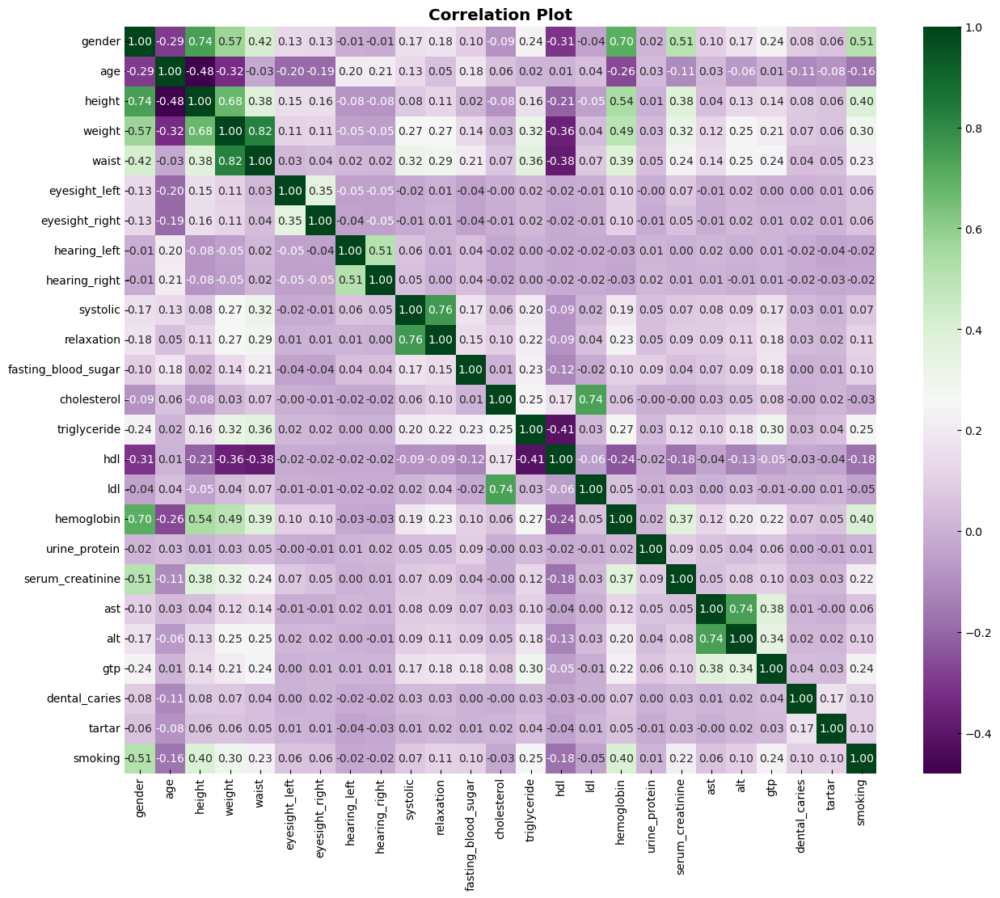

In [11]:
plt.figure(figsize=(15,12))

sns.heatmap(smoking.corr(), annot=True, cmap='PRGn', fmt='.2f',)
plt.title('Correlation Plot')

Alright, this plot indeed tells us a lot about the relationships between features in the dataset. There are some features that are quite highly correlated with other. Some of these are:

* `gender` |-> `height`,`weight`,`waist`,`hemoglobin`
* `height` |-> `gender`,`weight`,`hemoglobin`, 
* `weight` |-> `gender`,`weight`,`waist`,`hemoglobin` 
* `eyesight_left` |-> `eyesight_right` and vice versa.
* `systolic` |-> `relaxation` and vice versa.
* `cholesterol` |-> `ldl` and vice versa.
* `ast` |-> `alt` and vice versa.

After looking at the correlation plot and the basic characteristics of data printed earlier, also after asking a person who is an expert in the field of medicine for an opinion on the matter, I came to the conclusion that, most likely, our data contains some outliers. It seems to me that some of the values are slightly off and it won't benefit our models, not a bit. 

However, some of the correlations do make sense, e.g. commonly the greater the weight is, the higher is the level of hemoglobin, or the greater the weight is, the lower is the HDL. Also, the level of hemoglobin depends on a gender, usually men tend to have a higher level, and the plot confirms this.



* __Pie Charts__

Let's create two piecharts of two features containing categorical data, namely `smoking` and `gender`.

Text(0.5, 1.0, 'Gender of Patients')

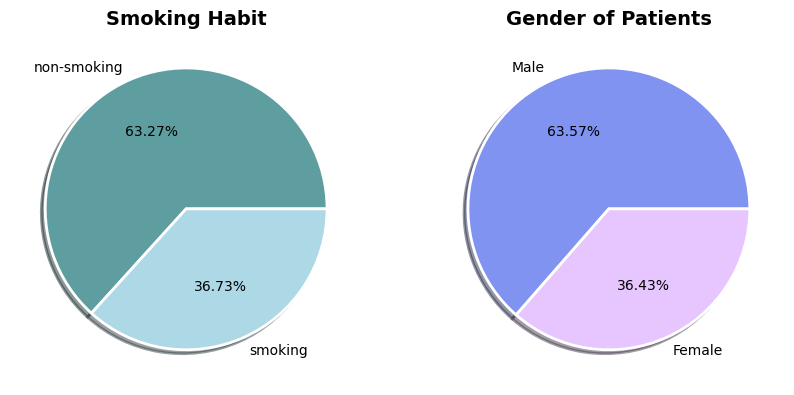

In [12]:
plt.figure(figsize=(10,5))
plt.subplot(121)
plt.pie(smoking['smoking'].value_counts(), labels=['non-smoking','smoking'],
        autopct="%1.2f%%", colors = ["#5F9EA0", "#ADD8E6"], 
        wedgeprops=dict(width=1, edgecolor='w',linewidth=2), shadow=True,)
plt.title('Smoking Habit', fontsize=14)


plt.subplot(122)
plt.pie(smoking['gender'].value_counts(), labels=['Male','Female'],
        autopct="%1.2f%%", colors = ["#8093f1", "#e7c6ff"],
        wedgeprops=dict(width=1, edgecolor='white',linewidth=2), shadow=True,)
plt.title('Gender of Patients', fontsize=14,)

We can see that almost 2/3 of the people are males and 1/3 are females. Not only that, our target consists mainly of non-smokers, with 36% of people bearing the habit of smoking.

* __Distributions of some continuous variables w.r.t. the target variable__

The distribution plots allow us to compare the distributions of different variables, f.e. by plotting multiple density plots on the same axis, we can easily compare the distributions of different variables and identify similarities, relationships or dependencies.

Text(0.5, 1.0, 'Distribution of Gender')

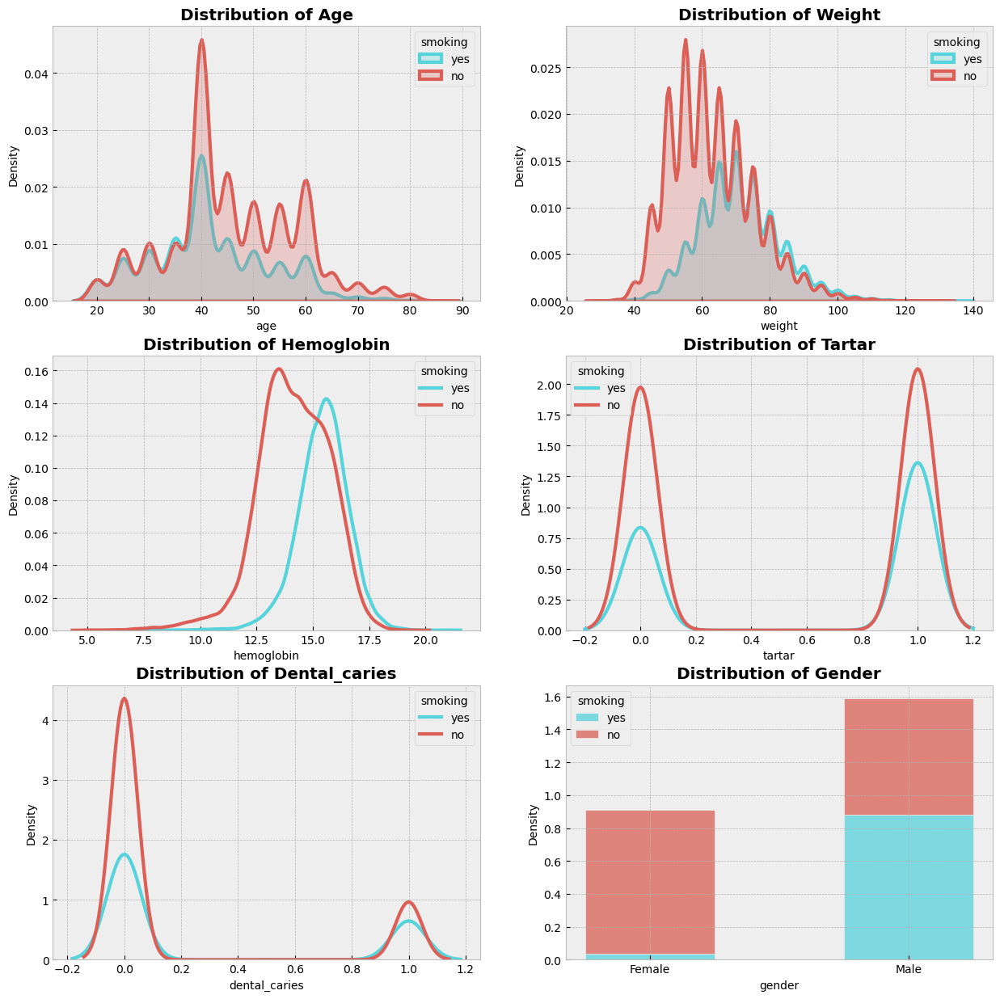

In [13]:
fig = plt.figure(figsize=(15,15))

plt.subplot(321)
sns.kdeplot(data=smoking, x='age', hue='smoking', palette='hls', linewidth=3, fill=True,)
plt.title('Distribution of Age')
plt.legend(labels=['yes','no'], title='smoking')    
    
plt.subplot(322)
sns.kdeplot(data=smoking, x='weight', hue='smoking', palette='hls', linewidth=3, fill=True)
plt.legend(labels=['yes','no'], title='smoking')  
plt.title('Distribution of Weight')

plt.subplot(323)
sns.kdeplot(data=smoking, x='hemoglobin', hue='smoking', palette='hls', linewidth=3, )
plt.legend(labels=['yes','no'], title='smoking')  
plt.title('Distribution of Hemoglobin')

plt.subplot(324)
sns.kdeplot(data=smoking, x='tartar', hue='smoking', palette='hls', linewidth=3, )
plt.legend(labels=['yes','no'], title='smoking') 
plt.title('Distribution of Tartar')

plt.subplot(325)
sns.kdeplot(data=smoking, x='dental_caries', hue='smoking', palette='hls', linewidth=3, )
plt.legend(labels=['yes','no'], title='smoking') 
plt.title('Distribution of Dental_caries')

plt.subplot(326)
ax= sns.histplot(data=smoking, x='gender', hue='smoking', palette='hls', multiple='stack',
                 stat='density', binwidth=.4)
ax.set_xticks([0.2,1])
ax.set_xticklabels(['Female','Male'])
plt.legend(labels=['yes','no'], title='smoking') 
plt.title('Distribution of Gender')

From these plots we can see that our dataset contains a lot more smokers in their 40s or younger while the non-smokers are usually a bit older than that. What's important, the smokers group consists mainly of males with a few female smoker, that leaves us with about one half of all men in the dataset being non-smokers, and a lot of non-smoking females. Also, the dataset contains roughly the same number of smoking and non-smoking males. Smokers tend to have a greater overall weight than non-smokers, and higher hemoglobin levels (probably it is because most of the smokers in the dataset are males, and generally men have a higher hemoglobin level, therefore that's the possible explanation to why we see a difference between the curves). 

Other features are either evenly distributed or highly imbalanced/skewed (such as `hearing_left`,`hearning_right`, `ast`, `alt`) that we are going to need other plots to explore them.

* __Distributions of some continuous features w.r.t. gender__

The distribution (density) plots not only provide a visual representation of the distribution of a variable, but also help us identify the presence of outliers, which can affect the performance of the model. By examining the tails of density plots we can identify them and take appropriate measures, be it a removal or transformation of outliers. Moreover, they help us determine whether the distribution of a particular variable is skewed or normal.

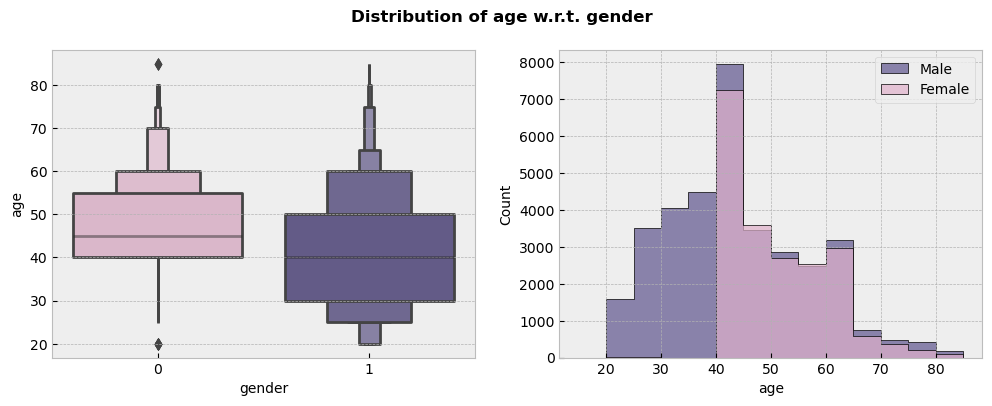

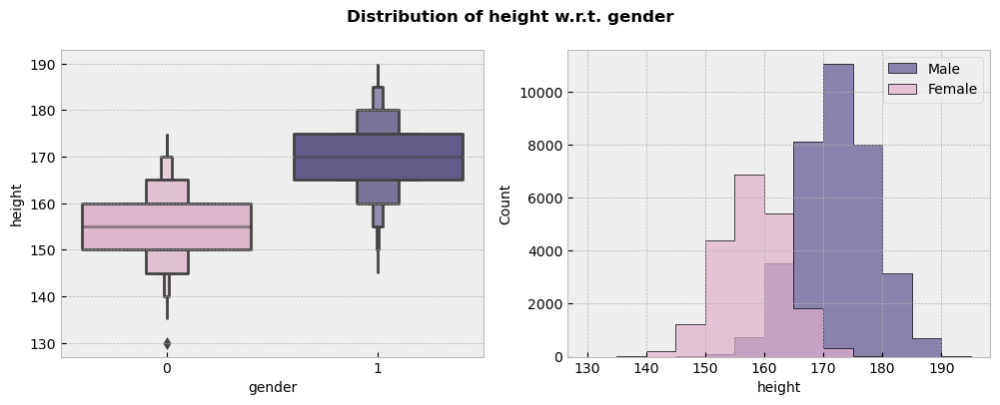

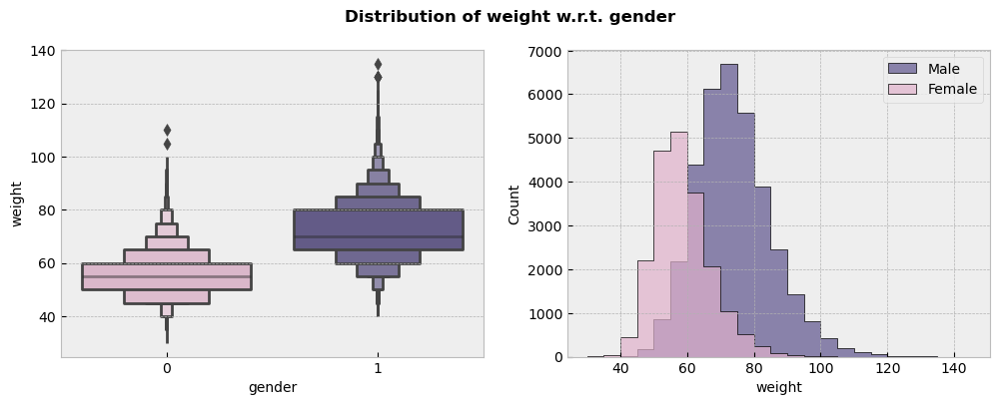

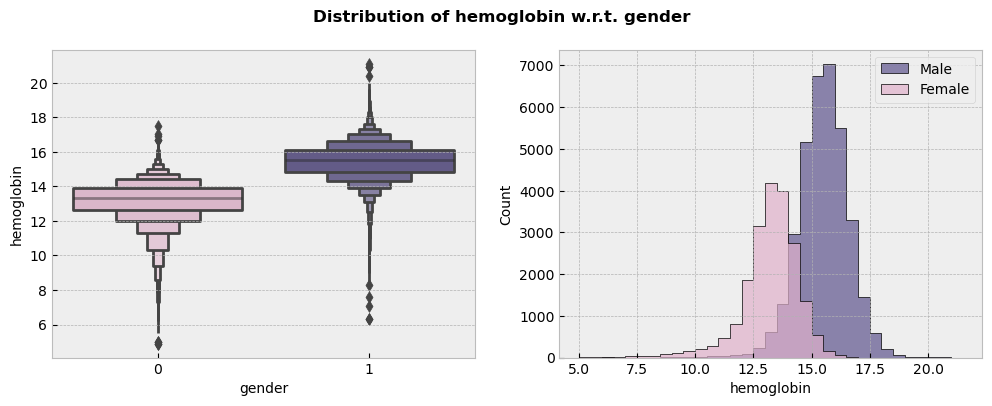

In [14]:
cols_bins = {
    'age': np.arange(15,90,5),
    'height': np.arange(130,200,5),
    'weight': np.arange(30,150,5),
    'hemoglobin':np.arange(5,22,0.5),
}
colors = ['#e0b1cb','#5e548e']

for col, bins in cols_bins.items():
    fig, ax = plt.subplots(1,2,figsize=(12,4))

    sns.boxenplot(x=smoking['gender'], y=smoking[col], palette=colors, ax=ax[0])
    sns.histplot(data=smoking,x=col, hue='gender', element='step', linewidth=.5, edgecolor='black',
                 bins=bins, palette=colors, alpha=.7, ax=ax[1])
    plt.legend(labels=['Male','Female'])
    plt.suptitle('Distribution of {} w.r.t. gender'.format(col), fontweight='bold')

According to these graphs, we see that females in the dataset are in the age from 40 to 80 with median age equal to 45, meanwhile for men the age range is 20 to 80 with the median age equal to 40. 

As expected, the average height for women is 155 cm, and for men around 170 cm. Also, men usually have a slighly greater weight (70 kg) than women (55 kg).

Generally, men and women have different mean hemoglobin levels - women have mean levels approximately 12% lower than men. And we see the apparent difference between the curves in the plot that confirms the statement. Furthermore, a higher than average hemoglobin level occurs most commonly when the body requires an increased oxygen-carrying capacity usually due to the smoking habit, living at a high altitude (red blood cell production naturally increases to compensate for the lower oxygen supply there) or other reasons.

* __Violin plots__

A violin plot is a hybrid of a box plot and a kernel density plot, which shows peaks in the data. It is used to visualize the distribution of numerical data. Unlike a box plot that can only show summary statistics, violin plots depict summary statistics and the density of each variable.

In [15]:
for cat_col in ['smoking','gender','hearing_left','hearing_right','urine_protein','dental_caries','tartar']:
    smoking[cat_col] = smoking[cat_col].astype('category')

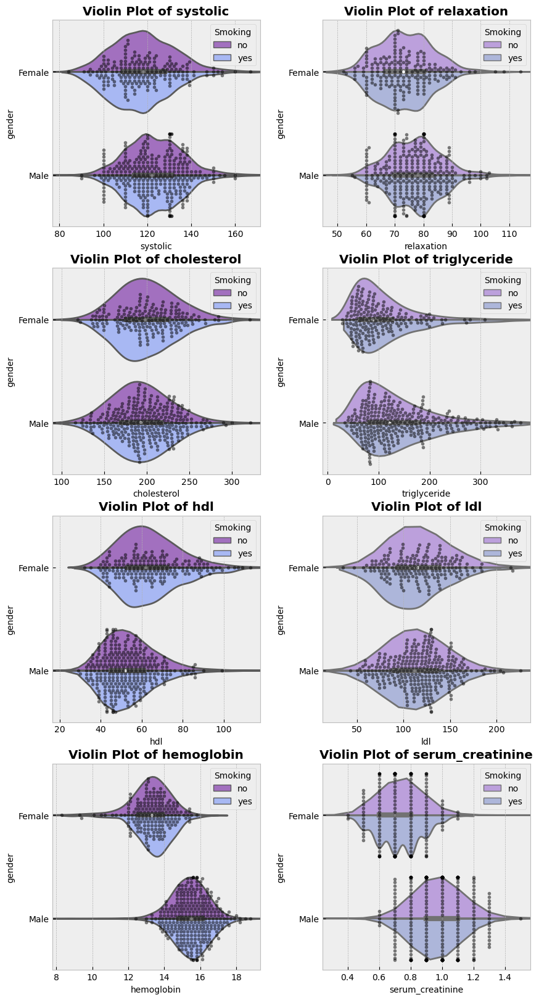

In [16]:
warnings.filterwarnings('ignore')

colors=['#a663cc','#9bb1ff', '#bc96e6', '#a6b1e1']
cols = ['systolic','relaxation', 'cholesterol', 'triglyceride', 'hdl', 'ldl', 'hemoglobin', 
        'serum_creatinine',]

n_cols = 2
n_rows = (len(cols) - 1) // n_cols + 1

# Create a figure.
fig, ax = plt.subplots(n_rows, n_cols, figsize=(10,20), )
plt.subplots_adjust(wspace=0.3)
ax = ax.flatten()

for i, col in enumerate(cols):
    # Choose the colors for the plots
    palette = colors[2:] if (i+1)%2 == 0 else colors[:2]
    
    # Plot.
    ax[i] = sns.violinplot(data=smoking, x=col, y='gender', hue='smoking',
                           bw=.25, cut=0, split=True, palette=palette, ax=ax[i])
    sns.swarmplot(data=smoking.head(500), x=col, y='gender', color='black',
                  marker='o', size=4, alpha=.5,ax = ax[i], )
    ax[i].set_yticklabels(labels=['Female', 'Male'])
    
    h,l = ax[i].get_legend_handles_labels()
    ax[i].legend(h[0:2],['no','yes'],title='Smoking', )  # 0 - no, 1 - yes
    ax[i].set_title('Violin Plot of {}'.format(col),)

__Let me remind you of some of the key takeaways from before: our data contains mostly male smokers and a few female smokers, and non-smokers are split roughly in half, with slightly more non-smoking females. Moreover, the dataset consists of 65% of non-smokers and 35% of smokers, and the same percentages are true for the number of males (65%) and females (35%), as we have already deduced.__

Here we see that the `systolic` distribution for men is pretty much the same for smokers and non-smokers, whilst non-smoking females have higher `systolic` more often than non-smoking women. As for `relaxation` we can't differentiate between smoking and non-smoking men or women just by looking at that feature.

We can't really make a statement that smoking doesn't influence the cholesterol levels because the dataset contains much less smoking than non-smoking females, still they might be a bit lower than the levels for non-smoking females. On the other hand, men tend to have a bit lower cholesterol levels when bearing the habit of smoking.

Usually, smoking is assosiated with high levels of triglyceride, and we can see that the lower curves for both men and women have more instances to the right, i.e. the instances indicating the possible influence of the smoking habit.

Additionally, smokers often have lower levels of the “good” cholesterol HDL and higher levels of the “bad” cholesterol LDL. Besides, taking the ages from 20 to 55 years, men tend to have higher LDL and lower HDL cholesterol levels than women. Also, after the age of 55, women's HDL cholesterol levels decrease rapidly, and LDL levels rise. 

Recall that most of the females in our dataset are in the age of 40 and older, while the age range for males is wider and is from 20 to 80. And so we see that for men and women HDL levels tend to get only a bit lower if they are smoking. As for LDL, there is an apparent difference in levels for females: we see that smoking females, contarary to statistics, tend to have lower LDL in our dataset than these not smoking. Besides, the same can be said about the plot for men, though the difference between the levels is not really visible there. In general, if we compare the levels for women and men separately without considering smoking habits, we see that indeed men have lower HDL levels than women (since the age range is wider), but not necessarily the higher LDL, probably because the dataset contains adult females older than 40 and they are known to have rises in LDL in that age.

Here again we see the distribution of hemoglobin, and the plot actually shows us that smokers have higher median hemoglobin levels than non-smokers, as well as, tells us that males have higher hemoglobin levels than females, as we expected it to be.

About the last plot, creatinine levels may vary due to factors like by age, sex, race, hydration, or body mass, and so we see for the gender in the graph here, however, smoking doesn't seem to affect it that much.


<!-- However, in the plots above we have the data saying the opposite, because the HDL for smoking women increases and LDL decreases instead. Moreover, there is not much of the difference between the distributions for HDL or LDL, regardless is the person smoking or not. However, for smoking men the HDL is slightly lower than for those not smoking, and LDL increases a bit.  -->


* __Stripplots__

Stripplots are a type of plot used in data visualization to display the distribution of a continuous variable in a dataset grouped by a categorical variable. They are similar to scatterplots, but instead of showing individual points, stripplots display the values of the continuous variable as vertical or horizontal lines or "strips" along the categorical axis.

Stripplots are useful for detecting patterns and outliers in the distribution of a variable across different categories. They can also be used to compare the distribution of the variable in different groups. That are some of the reasons we are going to use them to plot variables with possible outliers.

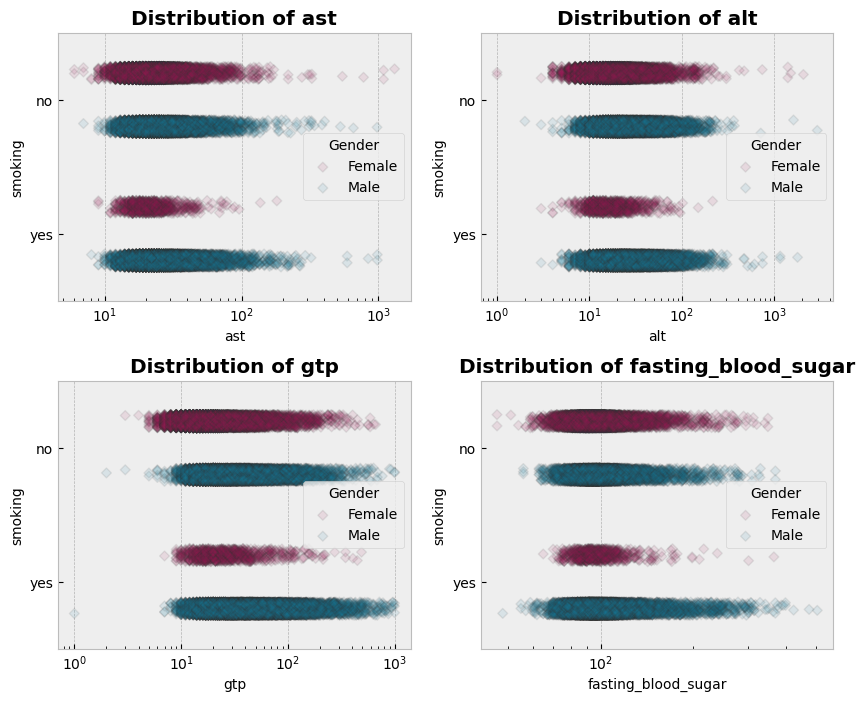

In [17]:
# Choose the columns which distribution we'd like to check.
cols = ['ast','alt','gtp','fasting_blood_sugar',]

# Define the properties of a plot.
n_cols = 2
n_rows = (len(cols) - 1) // n_cols + 1
colors=['#a01a58','#1780a1']

# Create a figure.
fig, ax = plt.subplots(n_rows, n_cols, figsize=(10,8), )
plt.subplots_adjust(hspace=0.3)  
ax = ax.flatten()

for i, col in enumerate(cols):
    
    # Plot the distribution.
    sns.stripplot(data=smoking, x=col,y='smoking', hue='gender', marker='D', s=5, alpha=.1,
                  linewidth=1, jitter=True, dodge=True, palette=colors, ax=ax[i])
    
    # Set the yticks.
    ax[i].yaxis.set_major_locator(mpl.ticker.FixedLocator([0,1]))
    ax[i].yaxis.set_major_formatter(mpl.ticker.FixedFormatter(['no', 'yes']))
    
    # Set the legend, title. Aslo, let the xaxis be of a log scale (because of possible outliers).
    ax[i].legend(labels=['Female','Male'], title='Gender')
    ax[i].set_xscale('log')
    ax[i].set_title('Distribution of {}'.format(col))

Generally speaking, there is no positive association between smoking and ALT or AST, but both ALT and AST levels can depend on gender, among other factors such as age, weight, and underlying medical conditions. Generally, males tend to have higher levels of ALT and AST compared to females and our data is in accord with that description. 

GTP levels can be affected by various factors including gender and smoking. In general, men tend to have higher γ-GTP levels than women. Smoking is also a known risk factor for elevated γ-GTP levels. However, there can be other factors that affect γ-GTP levels, such as alcohol consumption.

As for fasting blood sugar levels, they may depend on many factors such as age, weight, physical activity, and gender, smoking habits included. Commonly, males have slightly higher fasting blood sugar levels than females, and also smoking can be one of the reasons why they vary from average results. The stripplot shows us that for non-smokers they stay roughly the same, but for those bearing the smoking habit, women have much lower levels than men.

* __Bar plots__

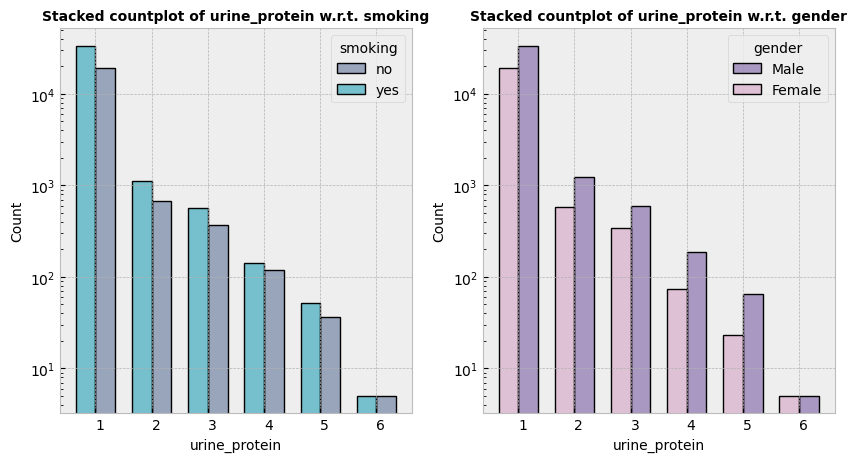

In [18]:
colors=['#d295bf','#654597', '#0091ad', '#455e89']

fig, ax = plt.subplots(1,2,figsize=(10,5))
ax= ax.flatten()

# Plot the countplots for urine_protein.
for i,(hue_col, labels) in enumerate(zip(['smoking','gender'], [['no','yes'], ['Male','Female']])):
    palette = colors[:2] if i==1 else colors[2:]
    
    sns.histplot(data=smoking, x='urine_protein', hue=hue_col, ax=ax[i], multiple='dodge', 
                 shrink=0.7, bins=np.arange(1,8,1), palette=palette, linewidth=1, 
                 edgecolor='black', alpha=.5)

    # Offset the xticks.
    ax[i].xaxis.set_major_locator(mpl.ticker.FixedLocator(np.arange(0,7,1)))
    for tick in ax[i].get_xticklabels():
        tick.set_horizontalalignment("left")
    # Set the scale, a legend, a title.
    ax[i].set_yscale('log')
    ax[i].legend(labels=labels, title=hue_col)
    ax[i].set_title('Stacked countplot of urine_protein w.r.t. {}'.format(hue_col), fontsize=10)

The plots above show that urine protein levels are not significantly affected by neither smoking nor gender. The most common value for `urine_protein` is 1.

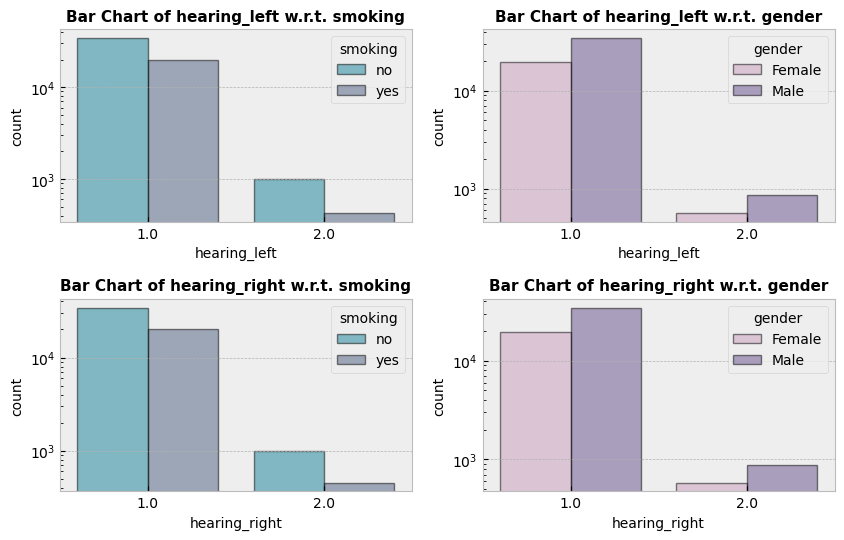

In [19]:
colors=['#d295bf','#654597', '#0091ad', '#455e89']

fig, ax = plt.subplots(2,2,figsize=(10,6))
ax= ax.flatten()

# Plot the countplots for hearing_left and hearing_right.
for i,(hue_col, labels) in enumerate(zip(['smoking','gender'], [['no','yes'], ['Female','Male']])):
    palette = colors[:2] if i==1 else colors[2:]
    
    sns.countplot(data=smoking, x='hearing_left', hue=hue_col, ax=ax[i],
                 palette=palette, linewidth=1, edgecolor='black', alpha=.5)

    # Set the scale, a legend, a title.
    ax[i].set_yscale('log')
    ax[i].legend(labels=labels, title=hue_col)
    ax[i].set_title('Bar Chart of hearing_left w.r.t. {}'.format(hue_col), fontsize=11)
    
for (i,hue_col, labels) in zip([2,3], ['smoking','gender'], [['no','yes'], ['Female','Male']]):
    palette = colors[:2] if i==3 else colors[2:]
    
    sns.countplot(data=smoking, x='hearing_right', hue=hue_col, ax=ax[i],
                 palette=palette, linewidth=1, edgecolor='black', alpha=.5)

    # Set the scale, a legend, a title.
    ax[i].set_yscale('log')
    ax[i].legend(labels=labels, title=hue_col)
    ax[i].set_title('Bar Chart of hearing_right w.r.t. {}'.format(hue_col), fontsize=11)

plt.subplots_adjust(hspace=0.4)  

These plots suggest that the majority of people have the normal hearing, and it doesn't depend on whether they smoke or not that much. Besides, as we remember from pie charts the 63% of all people who went through the checkup were males, so it's safe to say that the hearing variable doesn't depend on gender too.

* __The Box Plot of Features__

Let's take a look at how different the ranges of our features are.

Text(0.5, 1.0, 'Box Plot of Numerical Features')

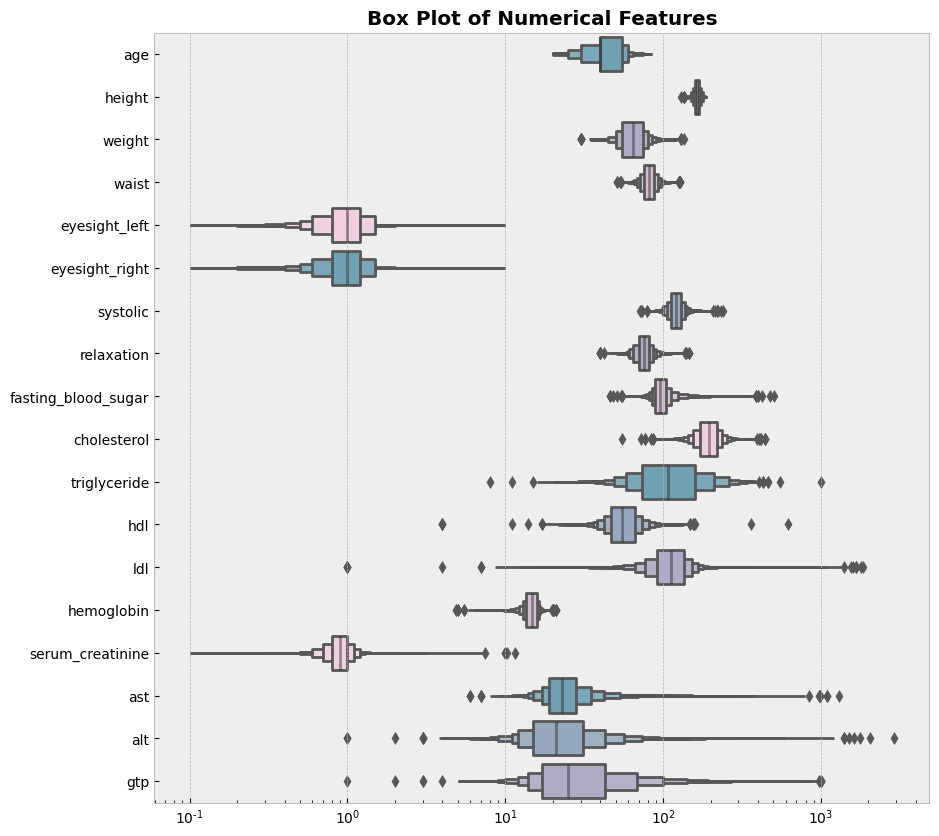

In [20]:
plt.figure(figsize=(10,10))

colors=['#64A6BD','#90A8C3','#ADA7C9', '#D7B9D5','#F4CAE0']
sns.boxenplot(data=smoking, orient='h', palette=colors)
plt.xscale('log')
plt.title('Box Plot of Numerical Features')

From the above plot the following conclusion can be drawn: all features are in different ranges, so we'd need to scale the data before fitting the model (if the model requires it). Also, the plot shows the possible outliers for each feature, so we should clean the data first before scaling.

In [21]:
smoking.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 55692 entries, 0 to 55691
Data columns (total 25 columns):
 #   Column               Non-Null Count  Dtype   
---  ------               --------------  -----   
 0   gender               55692 non-null  category
 1   age                  55692 non-null  int64   
 2   height               55692 non-null  int64   
 3   weight               55692 non-null  int64   
 4   waist                55692 non-null  float64 
 5   eyesight_left        55692 non-null  float64 
 6   eyesight_right       55692 non-null  float64 
 7   hearing_left         55692 non-null  category
 8   hearing_right        55692 non-null  category
 9   systolic             55692 non-null  float64 
 10  relaxation           55692 non-null  float64 
 11  fasting_blood_sugar  55692 non-null  float64 
 12  cholesterol          55692 non-null  float64 
 13  triglyceride         55692 non-null  float64 
 14  hdl                  55692 non-null  float64 
 15  ldl                

<a id="split"></a>
# 4. Train-Test Split 

First, we'll divide the data into train and test sets. We'll use the test set for the final performance evaluation of the models. The train set we'll divide into train and validation sets. We'll use the validation set to tune the models. Note that we'll use stratified sampling to ensure that there is roughly the same number of non-smokers and smokers in each set.

In [22]:
def split_dataset(X, y, test_size=0.2, valid_size=0.3, seed=SEED):
    '''
    Returns the training, validation, test set pairs generated by stratified splitting. 
    '''
    # Train_val & test split
    strat_split = StratifiedShuffleSplit(n_splits=1, test_size=test_size, random_state=seed)
    train_val_idx, test_idx = next(strat_split.split(X, y))
    
    X_train_val, y_train_val = X.iloc[train_val_idx], y.iloc[train_val_idx]
    X_test, y_test = X.iloc[test_idx], y.iloc[test_idx]
    
    # Train and val split
    strat_split = StratifiedShuffleSplit(n_splits=1, test_size=valid_size, random_state=seed)
    train_idx, val_idx = next(strat_split.split(X_train_val, y_train_val))

    X_train, y_train = X_train_val.iloc[train_idx], y_train_val.iloc[train_idx]
    X_val, y_val = X_train_val.iloc[val_idx], y_train_val.iloc[val_idx]
    
    return X_train, y_train, X_val, y_val, X_test, y_test

In [23]:
smoking = smoking.reset_index().drop('ID', axis=1)

X = smoking.drop('smoking', axis=1).copy()
y = pd.DataFrame(smoking['smoking'], index=smoking.index)

X_train, y_train, X_val, y_val, X_test, y_test = split_dataset(X, y, test_size=.2,
                                                               valid_size=.3, seed=SEED)
y_train = y_train.values.ravel()
y_val = y_val.values.ravel()
y_test = y_test.values.ravel()

In [24]:
print(X_train.shape, y_train.shape)
print(X_val.shape, y_val.shape)
print(X_test.shape, y_test.shape)

(31187, 24) (31187,)
(13366, 24) (13366,)
(11139, 24) (11139,)


In [25]:
# Scale the data sets.
std = StandardScaler()
X_train_sc = std.fit_transform(X_train)
X_val_sc = std.transform(X_val)
X_test_sc = std.transform(X_test)

<a id="spotcheck"></a>
# 5. Spot-Checking

Spot-checking is a technique used in machine learning to quickly evaluate and compare the performance of a set of different models on a given dataset. We'll just train each one of the models on the training set and measure their performance using the validation set. That means we'll perform the _spot-checking_ to discover which algorithms perform well on our machine learning problem.

<a id="base"></a>
### 5.1. Baseline Models

Baseline models are simple models that are used in the early stages of a machine learning project to establish a baseline for the expected level of performance. By establishing a baseline level of performance, it becomes possible to measure the improvement that more complex models provide. Additionally, baseline models can be useful for identifying issues with the data, such as class imbalance or outliers, that may need to be addressed before more complex models can be effectively applied.

In [26]:
# Create a dict of models to evaluate.
def get_baseline_models(models=dict()):
    # linear models
    models['LR'] = LogisticRegression(random_state=SEED, max_iter=3000)
    models['SGD'] = SGDClassifier(random_state=SEED)
    
    # non-linear models
    models['KNN'] = KNeighborsClassifier()
    models['CART'] = DecisionTreeClassifier(random_state=SEED)
    models['NB'] = GaussianNB()
    
    # ensemble models
    models['ADA'] = AdaBoostClassifier(random_state=SEED)
    models['RF'] = RandomForestClassifier(random_state=SEED)
    models['ET'] = ExtraTreesClassifier(random_state=SEED)
    models['GBM'] = GradientBoostingClassifier(random_state=SEED)
    return models


# Evaluate a single model
def evaluate_model(X, y, model, metric='accuracy'):
    cv_scores = cross_val_score(model, X, y, cv=cv, scoring=metric, n_jobs=-1)
    return cv_scores
    

# Evaluate a dict of models
def evaluate_models(X_train, y_train, X_val, y_val, models, metric='accuracy'):
    results = dict()  # {model_name:model_score}
    
    for name, model in models.items():
        model.fit(X_train, y_train)
        model_scores = evaluate_model(X_val, y_val, model, metric=metric)
        results[name] = model_scores
        
        # Show the process
        print(">> %s: %.4f (+/- %.4f)" % (name, model_scores.mean(), model_scores.std()))
    
    return results


def plot_boxplot_summary(results, color='#83c5be', xlabel=None,ylabel=None, title=None):
    '''
    Returns a pyplot figure representing the summary of the 'results' dictionary using box 
    and whisker plot.
    '''
    fig = go.Figure()
    
    # A function for creating a box and whisker plot.
    def create_trace(name, values):
        trace = go.Box(y=values, 
                       name=name, 
                       marker=dict(color=color)
                      )
        return trace
    
    # Generate a box and whisker plot for each key.
    for name, scores in results.items():
        fig.add_trace(create_trace(name, scores))
    
    # Add labels/title, and set the size of the plot.
    fig.update_layout(xaxis_title=xlabel, yaxis_title=ylabel,
                     title=dict(text=title, x=0.5), width=800, height=600)
    
    fig.show()

    
def create_scores_summary(results, summary_id):
    '''
    Returns a DataFrame containing the mean scores for each model from results.
    '''
    scores = [values.mean().round(4) for values in results.values()]
    names = results.keys()
    return pd.DataFrame({'Model{}'.format(summary_id):names, 
                         'Score{}'.format(summary_id):scores})

In [27]:
models = get_baseline_models()
results = evaluate_models(X_train.values, y_train, X_val.values, y_val, models)
plot_boxplot_summary(results)

>> LR: 0.7470 (+/- 0.0095)
>> SGD: 0.7061 (+/- 0.0264)
>> KNN: 0.6933 (+/- 0.0093)
>> CART: 0.7063 (+/- 0.0106)
>> NB: 0.7043 (+/- 0.0127)
>> ADA: 0.7554 (+/- 0.0106)
>> RF: 0.7707 (+/- 0.0065)
>> ET: 0.7652 (+/- 0.0082)
>> GBM: 0.7630 (+/- 0.0067)


In [28]:
model_base_score = create_scores_summary(results, summary_id=0)
model_base_score.style.background_gradient(cmap='coolwarm')

,Model0,Score0
0,LR,0.747000
1,SGD,0.706100
2,KNN,0.693300
3,CART,0.706300
4,NB,0.704300
5,ADA,0.755400
6,RF,0.770700
7,ET,0.765200
8,GBM,0.763000


As we can see most of the models perform no better than the tree-based models. The scales of the features might be to blame for that, because usually tree-based models don't depend on scaling, whilst other models do. We'll check whether we'll get a performance boost once we scale the features, but for now let's see whether our scores are going to change after we remove the outliers.

<a id="outlier"></a>
### 5.2. Outlier Detection

So now let's see how the models' scores change after removing some outliers. The data points we suspected to be the anomalies earlier in the EDA section may indicate something really interesting about the dataset or may be just incorrect data. The removal of these points might lead to our models generalizing better and accordingly giving us better results. 

__The Anomaly Detection Algortihm__

On larger datasets it becomes challenging to detect outliers just by using IQR technique on each feature in the dataset, so here we'll be using an anomaly detection algorithm called the __Isolation Forest__ to help identify and remove outliers. It is a tree-based anomaly detection algorithm that builds a Random Forest in which each Decision Tree is grown randomly: at each node, it picks randomly the feature and the threshold value between min and max, and then splits the dataset in two. The dataset gets splitted this way, until all instances end up isolated from other instances. 

The reason behind choosing this particular algorithm is simple: the Isolation Forest models have `contamination` hyperparameter (i.e. the proportion of outliers in the data set) which suits my needs a lot, because I didn't want to give the algorithm take control of the whole process of detecting outliers, but be the one to define which instances it should consider to be the outliers. So, we'll be tuning this hyperparameter a lot, once we get the gist of the algorithm.

#### Exploring the algorithm

Let's first plot the data in 3D space to try to detect the outliers visually (if it's possible) on our own and to understand our data better. For that we'll make use of the __Partial Component Analysis__, which will help us reduce the dimensions of the dataset down to three. Note, that it requires the data to be scaled.

In [29]:
# Scale the dataset,
smoking_sc = StandardScaler().fit_transform(smoking)

# Reduce the dimensions of a dataset.
pca = PCA(n_components=3, random_state=SEED)
smoking_reduced = pd.DataFrame(pca.fit_transform(smoking_sc))

In [30]:
# Create a scatterplot of the reduced dataset.
trace = go.Scatter3d(x=smoking_reduced[0], y=smoking_reduced[1], z=smoking_reduced[2], 
                     mode='markers', marker=dict(size=3,opacity=0.4, color='#1d3557'),)
layout = go.Layout(title=dict(text='Reduced Dataset', x=0.5), width=600, height=600)
fig = go.Figure(data=[trace], layout=layout)

fig.show()

Good! We can see one big cluster of instances here and some of the data points scattered either close or far away. Let's assume that we want to keep only the points which are roughly the components of that huge blob, and get rid of all other noisy data. For that, we gotta choose just the right `contamination` parameter, which will boost the performace of our machine learning models later.

In [31]:
# Define the IsolationForest with arbitrary parameters.
iso = IsolationForest(contamination=0.05, n_estimators=50, random_state=SEED,)

# Make predictions and find the outliers in the data.
smoking_reduced['pred'] = iso.fit_predict(smoking_reduced.values)
smoking_reduced['pred'] = smoking_reduced['pred'].astype('category')

print('Outliers detected: ', smoking_reduced[smoking_reduced['pred']==-1].shape[0])

Outliers detected:  2784


In [32]:
# Create a figure to plot outlier data points and normal ones.
fig = go.Figure()

# Add scatter to the figure.
for cluster in smoking_reduced['pred'].unique():
    # Get the data points in that cluster.
    in_cluster = smoking_reduced[smoking_reduced['pred'] == cluster]
    
    trace = go.Scatter3d(x=in_cluster[0], y=in_cluster[1], z=in_cluster[2],
                         mode='markers', name=cluster, legendwidth=2,
                         marker=dict(size=4,opacity=0.2, colorscale='rainbow'), )
    fig.add_trace(trace)
    
# Show legend, title.
fig.update_layout(showlegend=True, width=700, height=700, legend=dict(font=dict(size=20), 
                  itemsizing="constant", ), title=dict(text='Isolation Forest', x=0.5))
    
fig.show()

In [33]:
# The category -1 representing the detected outliers, and 1 ordinary points.
smoking_reduced['pred'].unique()

[1, -1]
Categories (2, int64): [-1, 1]

#### Tuning the Isolation forest

Now that we got the feel of the algorithm, let's put it to use and find the optimal hyperparameters for it by fitting the `GridSearchCV` on the training set. 

In [34]:
iso = IsolationForest(random_state=SEED)

param_grid = {'n_estimators':[100,200,500],
              'contamination':[0.03, 0.05, 0.07, 0.1],
              'max_features':[15,20,24],
              'bootstrap':[True, False],
              'n_jobs':[-1]}

# Fit the training set.
tuning_iso = GridSearchCV(iso, param_grid, scoring="accuracy", cv=3, verbose=1,
                          return_train_score=True, )
tuning_iso.fit(X_train.values, y_train)

Fitting 3 folds for each of 72 candidates, totalling 216 fits


GridSearchCV(cv=3, estimator=IsolationForest(random_state=19),
             param_grid={'bootstrap': [True, False],
                         'contamination': [0.03, 0.05, 0.07, 0.1],
                         'max_features': [15, 20, 24],
                         'n_estimators': [100, 200, 500], 'n_jobs': [-1]},
             return_train_score=True, scoring='accuracy', verbose=1)

#### Detecting Outliers with the Isolation Forest with the Optimal Parameters

Alright, we now know the best parameters for the Isolation Forest algorithm, therefore let's detect the outliers in the training set and check whether the algorithm detected the anomalies we wanted it to notice.

In [35]:
best_iso = tuning_iso.best_estimator_
best_iso

IsolationForest(contamination=0.03, max_features=20, n_jobs=-1, random_state=19)

In [36]:
X_train_sc_red = pd.DataFrame(pca.fit_transform(X_train_sc))

# Predict outliers for the training set.
train_preds = pd.Series(best_iso.fit_predict(X_train.values)).astype('category')
print('Outliers in the Train Set Detected: ', train_preds[train_preds==-1].shape[0])

Outliers in the Train Set Detected:  935


In [37]:
# Create a figure in order to plot ordinary data points and outliers in the training set.
fig = go.Figure()

# Add scatter to the figure.
for cluster in train_preds.unique():
    # Get the data points in that cluster.
    preds_idx = train_preds[train_preds==cluster].index
    in_cluster = X_train_sc_red.iloc[preds_idx]
    
    trace = go.Scatter3d(x=in_cluster[0], y=in_cluster[1], z=in_cluster[2],
                         mode='markers', name=cluster, legendwidth=2,
                         marker=dict(size=4,opacity=0.8, colorscale='rainbow'), )
    fig.add_trace(trace)
    
# Show legend, title.
fig.update_layout(showlegend=True, width=700, height=700, legend=dict(font=dict(size=20), 
                  itemsizing="constant", ), title=dict(text='Isolation Forest', x=0.5))
    
fig.show()

It seems like the algorithm indeed managed to capture these anomalies inthe training set. Let's now remove them.

#### Removing Outliers

In [38]:
# Get the indices of the outlier points.
drop_indices = train_preds[train_preds==-1].index

# Clean the training set.
X_train_clean = X_train.drop(X_train.iloc[drop_indices].index, axis=0)
y_train_clean = np.delete(y_train, drop_indices)

print("Before cleaning: {}\nAfter cleaning: {}".format(X_train.shape[0], 
                                                        X_train_clean.shape[0]))

Before cleaning: 31187
After cleaning: 30252


Text(0.5, 0.98, 'Feature Ranges of Train Set')

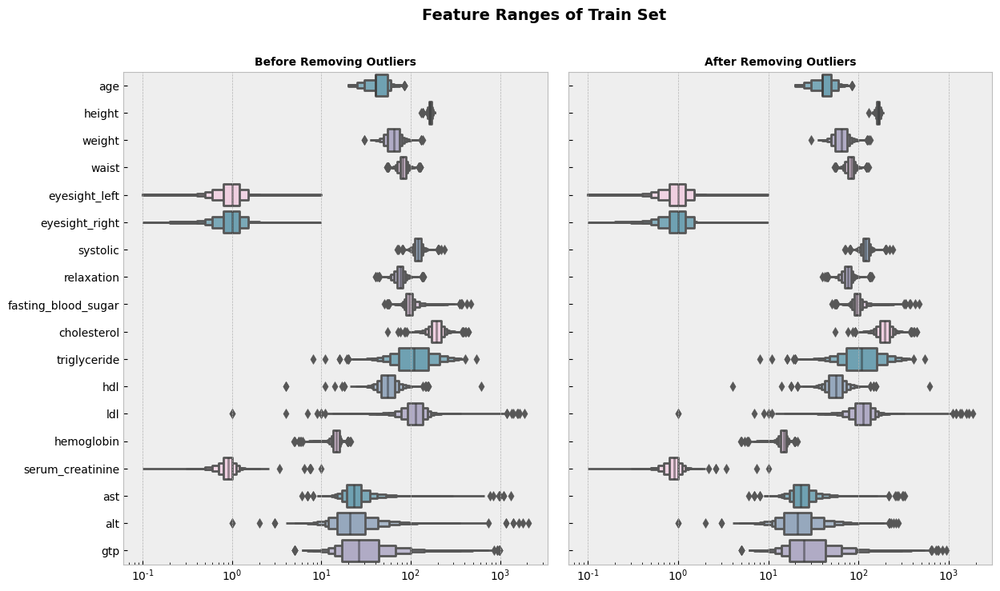

In [39]:
# Plot feature ranges of the training before and after cleaning. 
plt.subplots(1,2,sharey=True,figsize=(14,8))
plt.subplots_adjust(wspace=0.05, hspace=0.1)
colors=['#64A6BD','#90A8C3','#ADA7C9', '#D7B9D5','#F4CAE0']

plt.subplot(121)
sns.boxenplot(data=X_train, orient='h', palette=colors)
plt.xscale('log')
plt.title('Before Removing Outliers', fontsize=10)

plt.subplot(122)
sns.boxenplot(data=X_train_clean, orient='h', palette=colors)
plt.xscale('log')
plt.title('After Removing Outliers', fontsize=10)

plt.suptitle('Feature Ranges of Train Set', fontweight='bold', fontsize=14)

#### Check the Performance of Models on Cleaned Training Set

In [40]:
models_clean = get_baseline_models()
results_clean = evaluate_models(X_train_clean.values, y_train_clean, X_val.values, y_val, 
                                models_clean)
plot_boxplot_summary(results_clean)

>> LR: 0.7470 (+/- 0.0095)
>> SGD: 0.7061 (+/- 0.0264)
>> KNN: 0.6933 (+/- 0.0093)
>> CART: 0.7063 (+/- 0.0106)
>> NB: 0.7043 (+/- 0.0127)
>> ADA: 0.7554 (+/- 0.0106)
>> RF: 0.7707 (+/- 0.0065)
>> ET: 0.7652 (+/- 0.0082)
>> GBM: 0.7630 (+/- 0.0067)


In [41]:
model_clean_perform = create_scores_summary(results_clean, summary_id=1)
model_perform = pd.concat([model_base_score, model_clean_perform], axis=1)
model_perform.style.background_gradient(cmap='coolwarm')

,Model0,Score0,Model1,Score1
0,LR,0.747000,LR,0.747000
1,SGD,0.706100,SGD,0.706100
2,KNN,0.693300,KNN,0.693300
3,CART,0.706300,CART,0.706300
4,NB,0.704300,NB,0.704300
5,ADA,0.755400,ADA,0.755400
6,RF,0.770700,RF,0.770700
7,ET,0.765200,ET,0.765200
8,GBM,0.763000,GBM,0.763000


Well, looks like that the outlier detection technique we used haven't actually changed the accuracy of the baseline models. Most likely it is either that detected outliers do not have much of an influence on the models' results or this particular algorithm is not a great of a choice for this problem (or we couldn't tune it right).

<a id="scale"></a>
### 5.3. Scaling the Data

In [42]:
def make_pipeline(model, model_name, scaler=None):
    '''
    Returns a pipeline with either a classifier and a scaler or solely classifier.
    '''
    steps=list()
    
    # Add a scaler if there is one specified.
    if scaler=='standard':
        steps.append(('standard', StandardScaler()))
    elif scaler == 'minmax':
        steps.append(('minmax', MinMaxScaler()))
    else: 
        return 
    
    # Add a model
    steps.append((model_name, model))
                 
    return Pipeline(steps=steps)
    
    
def get_scaled_models(scaler_name, sc_models=dict()):
    base_models = get_baseline_models()
    
    for name, model in base_models.items():
        model_sc = make_pipeline(model, model_name=name, scaler=scaler_name)
        sc_models[scaler_name+'_'+name] = model_sc
        
    return sc_models

__Standard Scaler__

In [43]:
models_sc = get_scaled_models(scaler_name='standard', sc_models=dict())
results_sc =  evaluate_models(X_train.values, y_train, X_val.values, y_val, 
                              models_sc)
plot_boxplot_summary(results_sc)

>> standard_LR: 0.7473 (+/- 0.0119)
>> standard_SGD: 0.7242 (+/- 0.0153)
>> standard_KNN: 0.7115 (+/- 0.0188)
>> standard_CART: 0.7072 (+/- 0.0109)
>> standard_NB: 0.7043 (+/- 0.0127)
>> standard_ADA: 0.7554 (+/- 0.0106)
>> standard_RF: 0.7702 (+/- 0.0053)
>> standard_ET: 0.7653 (+/- 0.0083)
>> standard_GBM: 0.7630 (+/- 0.0067)


In [44]:
model_sc_perform = create_scores_summary(results_sc, summary_id=2)
model_perform = pd.concat([model_perform, model_sc_perform], axis=1)
model_perform.style.background_gradient(cmap='coolwarm')

,Model0,Score0,Model1,Score1,Model2,Score2
0,LR,0.747000,LR,0.747000,standard_LR,0.747300
1,SGD,0.706100,SGD,0.706100,standard_SGD,0.724200
2,KNN,0.693300,KNN,0.693300,standard_KNN,0.711500
3,CART,0.706300,CART,0.706300,standard_CART,0.707200
4,NB,0.704300,NB,0.704300,standard_NB,0.704300
5,ADA,0.755400,ADA,0.755400,standard_ADA,0.755400
6,RF,0.770700,RF,0.770700,standard_RF,0.770200
7,ET,0.765200,ET,0.765200,standard_ET,0.765300
8,GBM,0.763000,GBM,0.763000,standard_GBM,0.763000


Now, we see that standardizing the data actually leads to the improvement in accuracies of the non-tree-based models, to be exact, of the linear models.

__MinMaxScaler__

In [45]:
models_norm = get_scaled_models(scaler_name='minmax', sc_models=dict())
results_norm =  evaluate_models(X_train.values, y_train, X_val.values, y_val, 
                                models_norm)
plot_boxplot_summary(results_norm)

>> minmax_LR: 0.7430 (+/- 0.0118)
>> minmax_SGD: 0.7229 (+/- 0.0248)
>> minmax_KNN: 0.7157 (+/- 0.0112)
>> minmax_CART: 0.7061 (+/- 0.0107)
>> minmax_NB: 0.7043 (+/- 0.0127)
>> minmax_ADA: 0.7554 (+/- 0.0106)
>> minmax_RF: 0.7705 (+/- 0.0058)
>> minmax_ET: 0.7653 (+/- 0.0083)
>> minmax_GBM: 0.7630 (+/- 0.0067)


In [46]:
model_norm_perform = create_scores_summary(results_norm, summary_id=3)
model_perform = pd.concat([model_perform, model_norm_perform], axis=1)
model_perform.style.background_gradient(cmap='coolwarm')

,Model0,Score0,Model1,Score1,Model2,Score2,Model3,Score3
0,LR,0.747000,LR,0.747000,standard_LR,0.747300,minmax_LR,0.743000
1,SGD,0.706100,SGD,0.706100,standard_SGD,0.724200,minmax_SGD,0.722900
2,KNN,0.693300,KNN,0.693300,standard_KNN,0.711500,minmax_KNN,0.715700
3,CART,0.706300,CART,0.706300,standard_CART,0.707200,minmax_CART,0.706100
4,NB,0.704300,NB,0.704300,standard_NB,0.704300,minmax_NB,0.704300
5,ADA,0.755400,ADA,0.755400,standard_ADA,0.755400,minmax_ADA,0.755400
6,RF,0.770700,RF,0.770700,standard_RF,0.770200,minmax_RF,0.770500
7,ET,0.765200,ET,0.765200,standard_ET,0.765300,minmax_ET,0.765300
8,GBM,0.763000,GBM,0.763000,standard_GBM,0.763000,minmax_GBM,0.763000


These scores show that normalization usually leads to better results then just fitting the data without normalizing it first, however it doesn't necessarily outperform standardization.

<a id="corr"></a>
### 5.4. Removal of High-correlated Features

Sometimes when we have high-correlated features in the dataset, that we then use to fit the models, they sometimes don't bring any additional information to the models, but only increase the complexity of the algorithm, thus leading to overfitting. However, there is still a chance these features might improve our models instead. So, let's check it then for our data.

Text(0.5, 1.0, 'Positive Correlation Matrix')

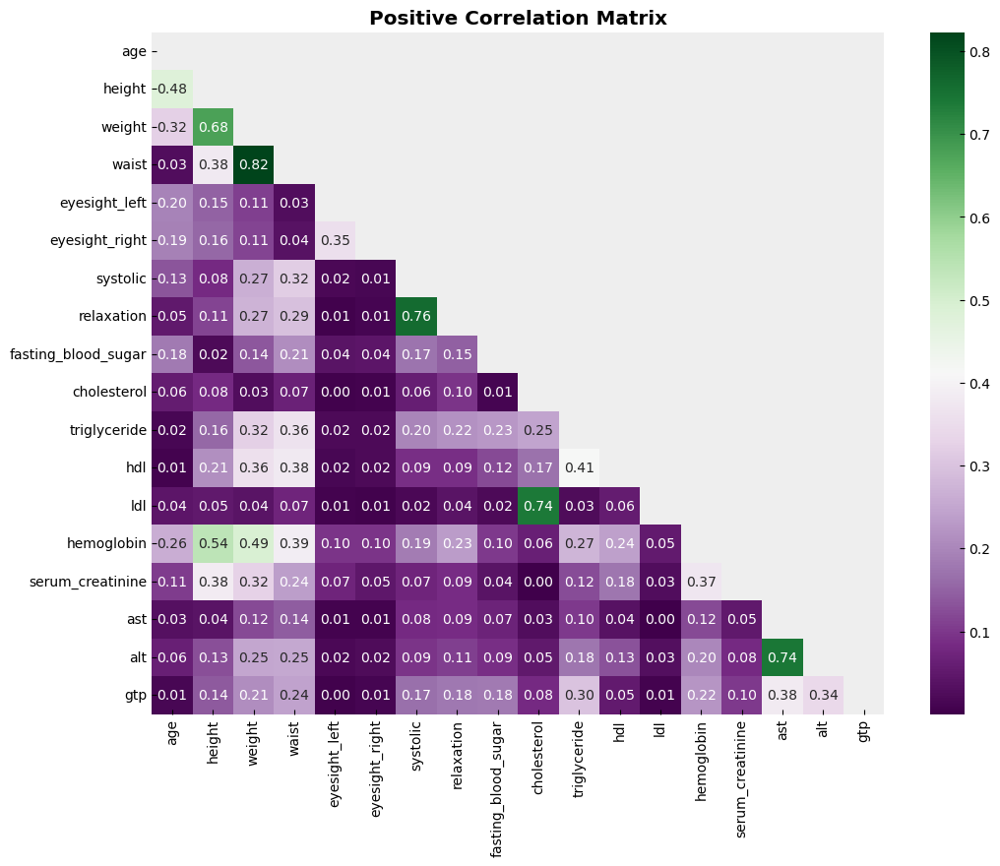

In [47]:
# Create positive correlation matrix
corr_df = smoking.corr().abs()
mask = np.triu(np.ones_like(corr_df, dtype=bool))
tri_df = corr_df.mask(mask)

# Plot the matrix.
plt.figure(figsize=(12,9))
sns.heatmap(tri_df, annot=True, cmap='PRGn', fmt='.2f',)
plt.title('Positive Correlation Matrix')

In [48]:
# Find the columns that meet threshold.
high_corr_features = [col for col in tri_df.columns if any(tri_df[col] > 0.7)]
high_corr_features

['weight', 'systolic', 'cholesterol', 'ast']

In [49]:
# Drop the high-correlated features.
X_train_corr = X_train.drop(high_corr_features, axis=1)
X_val_corr = X_val.drop(high_corr_features, axis=1)

In [50]:
models_corr = get_baseline_models()
results_corr = evaluate_models(X_train_corr.values, y_train, X_val_corr.values,
                               y_val, models_corr)
plot_boxplot_summary(results_corr)

>> LR: 0.7470 (+/- 0.0110)
>> SGD: 0.6933 (+/- 0.0392)
>> KNN: 0.6963 (+/- 0.0058)
>> CART: 0.7173 (+/- 0.0145)
>> NB: 0.7073 (+/- 0.0136)
>> ADA: 0.7573 (+/- 0.0113)
>> RF: 0.7697 (+/- 0.0080)
>> ET: 0.7672 (+/- 0.0086)
>> GBM: 0.7637 (+/- 0.0100)


In [51]:
model_corr_perform = create_scores_summary(results_corr, summary_id=4)
model_perform = pd.concat([model_perform, model_corr_perform], axis=1)
model_perform.style.background_gradient(cmap='coolwarm')

,Model0,Score0,Model1,Score1,Model2,Score2,Model3,Score3,Model4,Score4
0,LR,0.747000,LR,0.747000,standard_LR,0.747300,minmax_LR,0.743000,LR,0.747000
1,SGD,0.706100,SGD,0.706100,standard_SGD,0.724200,minmax_SGD,0.722900,SGD,0.693300
2,KNN,0.693300,KNN,0.693300,standard_KNN,0.711500,minmax_KNN,0.715700,KNN,0.696300
3,CART,0.706300,CART,0.706300,standard_CART,0.707200,minmax_CART,0.706100,CART,0.717300
4,NB,0.704300,NB,0.704300,standard_NB,0.704300,minmax_NB,0.704300,NB,0.707300
5,ADA,0.755400,ADA,0.755400,standard_ADA,0.755400,minmax_ADA,0.755400,ADA,0.757300
6,RF,0.770700,RF,0.770700,standard_RF,0.770200,minmax_RF,0.770500,RF,0.769700
7,ET,0.765200,ET,0.765200,standard_ET,0.765300,minmax_ET,0.765300,ET,0.767200
8,GBM,0.763000,GBM,0.763000,standard_GBM,0.763000,minmax_GBM,0.763000,GBM,0.763700


As can be seen, generally only Logistic Regression and CART tend to perform slighty better after removing high correlated features, but even that said they do not outperform the tree-based algorithms. The tree-based algorithms, however, can perform even slightly worse without high-correlated features, so perhaps after all they are the key to training a good classifier.

<a id="imp"></a>
### 5.5. Feature Importances

Feature Importance refers to techniques that calculate a score for all the input features for a given model — the scores simply represent the “importance” of each feature. A higher score means that the specific feature will have a larger effect on the model that is being used to predict a certain variable.

It plays quite a huge role in building _good_ machine learning models. Useless features influence the models' predictions, and so we get inaccurate results. In order to prevent that we're going to define which features seem to be the most vital and remove the rest from the sets.

In [52]:
clf = ExtraTreesClassifier(n_estimators=1000, random_state=SEED)
clf.fit(X_train.values, y_train)

ExtraTreesClassifier(n_estimators=1000, random_state=19)

Text(0.5, 0, 'Importance Score')

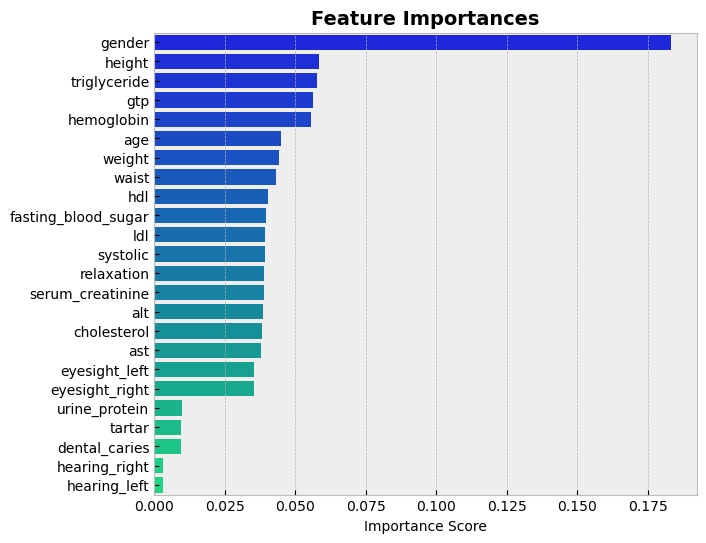

In [53]:
# Extract feature importances from the ET model and plot them.
imp_features = pd.Series(clf.feature_importances_, 
                         index = X_train.columns).sort_values(ascending=False)
plt.figure(figsize=(7,6))
sns.barplot(x=imp_features, y=imp_features.index, palette='winter')
plt.title('Feature Importances', fontsize=14)
plt.xlabel('Importance Score')

So we see that the `gender` turns out to be the most important feature, followed by `height`, `triglyceride` and other features that are slowly decreasing in importance score. The plot also reveals that some of the highly correlated features, namely `weight` and `systolic`, make it to the top 12 features, meaning that they do have the influence on the model and enough of it to possibly confuse it (or not as we have already concluded). Let's compare the models' results by training on different number of features. 

__Base models (10 features)__

In [54]:
# Train the models only on the top 10 of the most important features.
X_train_feat10 = X_train[imp_features.index[:10]]
X_val_feat10 = X_val[imp_features.index[:10]]

In [55]:
models_feat10 = get_baseline_models()
results_feat10 = evaluate_models(X_train_feat10.values, y_train, X_val_feat10.values,
                                 y_val, models_feat10)
plot_boxplot_summary(results_feat10)

>> LR: 0.7309 (+/- 0.0113)
>> SGD: 0.6692 (+/- 0.0278)
>> KNN: 0.6982 (+/- 0.0047)
>> CART: 0.7070 (+/- 0.0114)
>> NB: 0.7069 (+/- 0.0105)
>> ADA: 0.7467 (+/- 0.0107)
>> RF: 0.7645 (+/- 0.0095)
>> ET: 0.7591 (+/- 0.0066)
>> GBM: 0.7491 (+/- 0.0108)


In [56]:
model_feat10 = create_scores_summary(results_feat10, summary_id=5)
model_perform = pd.concat([model_perform, model_feat10], axis=1)
model_perform.style.background_gradient(cmap='coolwarm')

,Model0,Score0,Model1,Score1,Model2,Score2,Model3,Score3,Model4,Score4,Model5,Score5
0,LR,0.747000,LR,0.747000,standard_LR,0.747300,minmax_LR,0.743000,LR,0.747000,LR,0.730900
1,SGD,0.706100,SGD,0.706100,standard_SGD,0.724200,minmax_SGD,0.722900,SGD,0.693300,SGD,0.669200
2,KNN,0.693300,KNN,0.693300,standard_KNN,0.711500,minmax_KNN,0.715700,KNN,0.696300,KNN,0.698200
3,CART,0.706300,CART,0.706300,standard_CART,0.707200,minmax_CART,0.706100,CART,0.717300,CART,0.707000
4,NB,0.704300,NB,0.704300,standard_NB,0.704300,minmax_NB,0.704300,NB,0.707300,NB,0.706900
5,ADA,0.755400,ADA,0.755400,standard_ADA,0.755400,minmax_ADA,0.755400,ADA,0.757300,ADA,0.746700
6,RF,0.770700,RF,0.770700,standard_RF,0.770200,minmax_RF,0.770500,RF,0.769700,RF,0.764500
7,ET,0.765200,ET,0.765200,standard_ET,0.765300,minmax_ET,0.765300,ET,0.767200,ET,0.759100
8,GBM,0.763000,GBM,0.763000,standard_GBM,0.763000,minmax_GBM,0.763000,GBM,0.763700,GBM,0.749100


Compared to previous results, the models trained on 10 the most important features seem to have slightly lower scores on average. This approach doesn't give us any additional boost, unfortunately. And it turns out that as we decrease the number of features further on, the scores get lower too.

__Scaled models (10 features)__

In [57]:
models_sc_feat10 = get_scaled_models(scaler_name='standard', sc_models=dict())
results_sc_feat10 = evaluate_models(X_train_feat10.values, y_train, X_val_feat10.values,
                                 y_val, models_sc_feat10)
plot_boxplot_summary(results_sc_feat10)

>> standard_LR: 0.7340 (+/- 0.0117)
>> standard_SGD: 0.7165 (+/- 0.0147)
>> standard_KNN: 0.7150 (+/- 0.0104)
>> standard_CART: 0.7063 (+/- 0.0115)
>> standard_NB: 0.7069 (+/- 0.0105)
>> standard_ADA: 0.7467 (+/- 0.0107)
>> standard_RF: 0.7636 (+/- 0.0093)
>> standard_ET: 0.7591 (+/- 0.0069)
>> standard_GBM: 0.7491 (+/- 0.0108)


In [58]:
model_sc_feat10 = create_scores_summary(results_sc_feat10, summary_id=6)
model_perform = pd.concat([model_perform, model_sc_feat10], axis=1)
model_perform.style.background_gradient(cmap='coolwarm')

,Model0,Score0,Model1,Score1,Model2,Score2,Model3,Score3,Model4,Score4,Model5,Score5,Model6,Score6
0,LR,0.747000,LR,0.747000,standard_LR,0.747300,minmax_LR,0.743000,LR,0.747000,LR,0.730900,standard_LR,0.734000
1,SGD,0.706100,SGD,0.706100,standard_SGD,0.724200,minmax_SGD,0.722900,SGD,0.693300,SGD,0.669200,standard_SGD,0.716500
2,KNN,0.693300,KNN,0.693300,standard_KNN,0.711500,minmax_KNN,0.715700,KNN,0.696300,KNN,0.698200,standard_KNN,0.715000
3,CART,0.706300,CART,0.706300,standard_CART,0.707200,minmax_CART,0.706100,CART,0.717300,CART,0.707000,standard_CART,0.706300
4,NB,0.704300,NB,0.704300,standard_NB,0.704300,minmax_NB,0.704300,NB,0.707300,NB,0.706900,standard_NB,0.706900
5,ADA,0.755400,ADA,0.755400,standard_ADA,0.755400,minmax_ADA,0.755400,ADA,0.757300,ADA,0.746700,standard_ADA,0.746700
6,RF,0.770700,RF,0.770700,standard_RF,0.770200,minmax_RF,0.770500,RF,0.769700,RF,0.764500,standard_RF,0.763600
7,ET,0.765200,ET,0.765200,standard_ET,0.765300,minmax_ET,0.765300,ET,0.767200,ET,0.759100,standard_ET,0.759100
8,GBM,0.763000,GBM,0.763000,standard_GBM,0.763000,minmax_GBM,0.763000,GBM,0.763700,GBM,0.749100,standard_GBM,0.749100


If we were to compare the scores with the result from models fitted on scaled data, then we'd be disappointed too, 'cause sadly the improvement is nowhere to be seen. For example, Logistic Regression performs worse than one trained on scaled training data with the whole set of features,and tree-based ensembles perform surely not better.

__Scaled models (19 features)__


In [59]:
# Train the models only on the top 19 of the most important features.
X_train_feat19 = X_train[imp_features.index[:19]]
X_val_feat19 = X_val[imp_features.index[:19]]

models_feat19 = get_scaled_models(scaler_name='standard', sc_models=dict())
results_feat19 = evaluate_models(X_train_feat19.values, y_train, X_val_feat19.values,
                                 y_val, models_feat19)
plot_boxplot_summary(results_feat19)

>> standard_LR: 0.7412 (+/- 0.0105)
>> standard_SGD: 0.7186 (+/- 0.0170)
>> standard_KNN: 0.7130 (+/- 0.0140)
>> standard_CART: 0.7103 (+/- 0.0147)
>> standard_NB: 0.7050 (+/- 0.0126)
>> standard_ADA: 0.7568 (+/- 0.0123)
>> standard_RF: 0.7705 (+/- 0.0113)
>> standard_ET: 0.7676 (+/- 0.0101)
>> standard_GBM: 0.7571 (+/- 0.0062)


In [60]:
model_sc_feat19 = create_scores_summary(results_feat19, summary_id=7)
model_perform = pd.concat([model_perform, model_sc_feat19], axis=1)
model_perform.style.background_gradient(cmap='coolwarm')

,Model0,Score0,Model1,Score1,Model2,Score2,Model3,Score3,Model4,Score4,Model5,Score5,Model6,Score6,Model7,Score7
0,LR,0.747000,LR,0.747000,standard_LR,0.747300,minmax_LR,0.743000,LR,0.747000,LR,0.730900,standard_LR,0.734000,standard_LR,0.741200
1,SGD,0.706100,SGD,0.706100,standard_SGD,0.724200,minmax_SGD,0.722900,SGD,0.693300,SGD,0.669200,standard_SGD,0.716500,standard_SGD,0.718600
2,KNN,0.693300,KNN,0.693300,standard_KNN,0.711500,minmax_KNN,0.715700,KNN,0.696300,KNN,0.698200,standard_KNN,0.715000,standard_KNN,0.713000
3,CART,0.706300,CART,0.706300,standard_CART,0.707200,minmax_CART,0.706100,CART,0.717300,CART,0.707000,standard_CART,0.706300,standard_CART,0.710300
4,NB,0.704300,NB,0.704300,standard_NB,0.704300,minmax_NB,0.704300,NB,0.707300,NB,0.706900,standard_NB,0.706900,standard_NB,0.705000
5,ADA,0.755400,ADA,0.755400,standard_ADA,0.755400,minmax_ADA,0.755400,ADA,0.757300,ADA,0.746700,standard_ADA,0.746700,standard_ADA,0.756800
6,RF,0.770700,RF,0.770700,standard_RF,0.770200,minmax_RF,0.770500,RF,0.769700,RF,0.764500,standard_RF,0.763600,standard_RF,0.770500
7,ET,0.765200,ET,0.765200,standard_ET,0.765300,minmax_ET,0.765300,ET,0.767200,ET,0.759100,standard_ET,0.759100,standard_ET,0.767600
8,GBM,0.763000,GBM,0.763000,standard_GBM,0.763000,minmax_GBM,0.763000,GBM,0.763700,GBM,0.749100,standard_GBM,0.749100,standard_GBM,0.757100


Well, it looks like no matter how many features we pass to the baseline models, none of them perform any better on average (at least when using feature importances as a way to determine the most vital features). Neither do they care whether the features are correlated or not.

To sum up, linear models usually require scaling to fit the data well, whilst for other its not something particularly necessary. The models' scores commonly stay the same if you try deleting highly correlated features or what's more,the scores get worse. If we were to decrease the number of features of the data passed to the algorithm, then we'd not see any improvement too. However, there might be hope that the right outlier detection technique might make the scores go up a bit. Let's next explore the ways we can bring each of the model to its full potential. In the following section we'll be fine-tuning the models and analyzing their performances using different techniques.

<a id="tune"></a>
# 6. Building and Fine-Tuning the Models

Before moving on to the fine-tuning, I believe that we need to explain which metrics we'll be using and how we'll be drawing conclusions from them. There are a couple of common metrics used in binary classification. Let's give each of them some explanation.

__ACCURACY__

Accuracy simply measures how often the classifier correctly predicts. It's the ratio of the number of correct predictions to the total number of predictions. 

However, the accuracy metric is not sufficient enough on its own, because it's only useful when the target class is well balanced. If our dataset contains 99 non-smokers and 1 smoker, and the model always predicts the non-smokers, we get 99% accuracy, but it's not quite right to say that. This demostrates why accuracy is generally not preferred performance measure for classifiers, especially when dealing with skewed datasets. Thus other metrics should be considered as well, as we'll see further on.


__CONFUSION MATRIX__

A much better way to evaluate the performance of a classifier is to take a look at the confusion matrix. Basically, it's just a table of combinations of predicted and actual values for each target class. A perfect classifier would have only true positives and true negatives, and have zeros everywhere except on the diagonal of the confusion matrix.

__PRECISION AND RECALL__

Another way to look at the performance of your model is to check its precision and recall.

_Precision_ explains how many of the correctly predicted classes actually turned out to be positive. It's useful in the cases where False Pos is of higher concern than False Neg. In our case a positive class is 1 - smoker, and so if we cared more about cases when non-smokers were predicted to be smokers, then we'd pick _Precision_ as our metric.

_Recall (Sensitivity)_ explains how many of the actual positive cases were predicted correctly. Used when the False Neg is of higher concern than False Pos. We'd use it in cases when it doesn't matter if we classify non-smokers as smokers, but our concern is how many smokers the model predicted to be not smoking.

Unfortunately, you can't have it both ways: increasing precision reduces recall, and vice versa. That's called the precision/recall tradeoff. So in order to choose the right precision/recall ratio, we'll plot some curves to help us with that.

__F1 SCORE__

This metric is the harmonic mean of precision and recall, which punishes extreme values more and is maximum when Precision = Recall. It is usually used in cases when False Pos and and False Neg are equally costly,or True Neg is high, or adding more data doesn't change the outcome. We won't be using it too much.

__THE ROC CURVE__

The receiver operating characteristic (ROC) curve is another tool used to evaluate binary classifiers. It's similar to the precision/recall curve, but instead it plots recall against false positive rate (FPR). FPR is the ratio of negative instances that are incorrectly classified as positive (equals 1 - true negative rate). That means in our dataset such instances for which the actual target value is 0 - non-smoker, and they were predicted to be 1 - smokers.

__THE DISCUSSION__

_From EDA we know that our dataset contains 65% non-smokers and 35% smokers, therefore since the dataset is skewed, we'd care more about classifying the smokers correctly rather than non-smokers._

_Maximizing precision ensures that the instances classified as smokers are very likely to be true smokers, reducing the number of false positives (non-smokers classified as smokers), which can have negative consequences. However, sensitivity (the proportion of true smokers that are correctly identified as smokers) is generally more important than precision. This is because smoking is a significant risk factor for a wide range of health problems, and it is crucial to identify as many smokers as possible to accurately assess their risk._

_Therefore, while it is important to maximize precision, it should be done in a way that balances sensitivity, so that as few smokers as possible are missed while keeping false positives to a minimum._

_That said,we'd give recall more significance when evaluating the models. We shall aim for a lower False Neg, which in turn gives as a higher recall. Thus we need to look for a high recall, but not too low precision since we still want to classify non-smokers correctly. At the same time we don't want the Fall-out to be too high, because we'll have a lot of non-smokers classified incorrectly (higher the FPR number means the higher number of False Pos than True Neg, while a higher recall indicates a higher number of True Pos than False Neg)._

___In summary, the ideal approach to classifying smokers and non-smokers would be to balance recall, fall-out, precision, and accuracy to achieve a high recall and a low fall-out, while maintaining a reasonable level of precision. We would also want to aim for high precision, although this may not be the top priority, especially in our case where the dataset is imbalanced and there are more non-smokers than smokers.___

In [61]:
def plot_learning_curves(estimator, X, y, cv=cv, title=None, train_sizes=np.linspace(.1, 1.0, 5)):
    '''
    Returns a plot of estimator's training and test scores against different training set sizes.
    '''
    plt.figure()
    
    # Determine cross-validated training and test scores for different training set sizes.
    train_sizes, train_scores, test_scores = learning_curve(estimator, X, y, cv=cv,
            train_sizes=train_sizes, scoring='accuracy', random_state=SEED)
    
    # Calculate the mean of each cv fold.
    mean_train_scores = np.mean(train_scores, axis=1)
    std_train_scores = np.std(train_scores, axis=1)
    mean_test_scores = np.mean(test_scores, axis=1)
    std_test_scores = np.std(test_scores, axis=1)
    
    # Plot the results.
    plt.fill_between(train_sizes, mean_train_scores - std_train_scores, 
                     mean_train_scores + std_train_scores, alpha=0.1, color='blue')
    plt.fill_between(train_sizes, mean_test_scores - std_test_scores, 
                     mean_test_scores + std_test_scores, alpha=0.1, color='r')
    plt.plot(train_sizes, mean_train_scores, 'o-', label='Train score')
    plt.plot(train_sizes, mean_test_scores, 'o-', label='Test score')
    
    plt.title(title)
    plt.xlabel('Training Set Size')
    plt.ylabel('Accuracy')
    plt.legend(loc='upper left')
    
    
def plot_scores_vs_params(cv_results, param_names, title):
    '''
    Shows a plot of mean scores against various combinations of parameters from cv_results.
    '''
    mean_train_score = cv_res['mean_train_score'].values
    mean_test_score = cv_res['mean_test_score'].values
    
    fmt_params = ['param_{}'.format(param_name) for param_name in param_names]
    param_values = [ str(params.values) for i, params in cv_results[fmt_params].iterrows()]
    
    plt.plot(range(len(param_values)), mean_train_score, 'o-', c='g', label='Train score')
    plt.plot(range(len(param_values)), mean_test_score, 'o-', c='m', label='Test score')
    
    plt.xticks(range(len(param_values)), labels=param_values,fontsize=7, rotation=90)
    plt.ylabel('Accuracy')
    plt.xlabel('hyperparams: {}'.format(param_names))
    plt.legend()
    plt.title(title)
    
    
def plot_precision_recall_vs_threshold(precisions, recalls, thresholds):
    '''
    Shows a plot of precision/recall curves across the thresholds.
    '''
    plt.plot(thresholds, precisions[:-1], 'b-', label='Precision')
    plt.plot(thresholds, recalls[:-1], 'g-', label='Recall')
    plt.legend()
    plt.grid(True)
    plt.xlabel('Threshold')
    plt.title('Precision & Recall vs Threshold')
    
    
def plot_precision_vs_recall(precisions, recalls):
    '''
    Shows a plot of recall values against precision values.
    '''
    plt.plot(recalls, precisions, 'b--', )
    plt.xlabel('Recall')
    plt.ylabel('Precision')
    plt.title('Recall vs Precision')    
    
    
def plot_roc_curve(fpr, tpr, label=None):
    '''
    Plots the ROC curve using fpr and tpr values.
    '''
    plt.plot(fpr, tpr, linewidth=2, label=label)
    plt.plot([0,1],[0,1], 'k--', alpha=.5)  # dashed diagonal
    plt.axis([0,1,0,1])
    plt.xlabel('False Positive Rate (Fall-Out)')
    plt.ylabel('True Positive Rate (Recall)')
    plt.title('ROC Curve')
    plt.grid(True)

    
def plot_confusion_matrix(conf_mx, cmap='Purples'):
    '''
    Plot a confusion matrix for a binary classifier.
    '''
    # Create the labels
    group_names = ['True Neg', 'False Pos', 'False Neg', 'True Pos']
    group_counts = [str(value) for value in conf_mx.flatten()]
    group_pct = ["{0:.2%}".format(value) for value in conf_mx.flatten()/np.sum(conf_mx)]
    labels = [f"{name}\n{cnt}\n{pct}" for name, cnt, pct in 
              zip(group_names, group_counts, group_pct)]
    labels = np.asarray(labels).reshape(2,2)
    
    # Plot a matrix with these labels.
    plt.grid(False)
    sns.heatmap(conf_mx, annot=labels, fmt='', cmap=cmap,)
    plt.grid(False)
    plt.ylabel('Actual Values')
    plt.xlabel('Predicted Values')
    plt.title('Confusion Matrix')

def plot_oob_error_rate(ensemble_clfs, X, y, n_estimators=np.arange(30, 150, 5)):
    '''
    Generates the "OOB error rate" vs. "n_estimators" plot.
    ensemble_clfs = {<label>:<model>}
    '''
    # Map a classifier name to a list of (n_estimators, error_rate) pairs.
    error_rate = OrderedDict((label, []) for label, _ in ensemble_clfs)
    
    # Calculate the OOB error rate for each classifier across `n_estimators` range.
    for label, clf in ensemble_clfs:
        for n in n_estimators:
            clf.set_params(n_estimators=n)
            clf.fit(X, y)

            oob_error = 1 - clf.oob_score_
            error_rate[label].append((n, oob_error))
    
    # Plot the OOB error rate for different combinations of hyperparameters.
    for label, clf_err in error_rate.items():
        xs, ys = zip(*clf_err)
        plt.plot(xs, ys, label=label)

    plt.xlim(30,150)
    plt.xlabel('n_estimators')
    plt.ylabel('OOB error rate')
    plt.legend()

In [62]:
# This function is not used in this version of notebook, instead the RFE technique 
# is utilized whenever the feature selection is needed.
def feature_selection(estimator, X_train, y_train, X_val, y_val, n_features, feature_importances):
    '''
    Returns the training and validation scores computed using cross-validation for an estimator 
    trained on sets with the features in 'n_features' range.
    '''
    train_accs = []
    val_accs = []
    
    for n in n_features:
        if isinstance(X_train, pd.DataFrame):  # dataframe of not scaled data.
            X_tr_feat = X_train[feature_importances.index[:n]]
            X_val_feat = X_val[feature_importances.index[:n]]
        else:   # numpy array of scaled data.
            X_tr_feat = X_train[:,np.arange(0,n)]
            X_val_feat = X_val[:,np.arange(0,n)]

        # Fit the estimator
        estimator.fit(X_tr_feat, y_train)

        # Calculate the accuracies using cross-validation.
        train_acc = cross_val_score(estimator, X_tr_feat, 
                                    y_train, cv=cv, scoring='accuracy').mean().round(4)
        val_acc = cross_val_score(estimator, X_val_feat, 
                                  y_val, cv=cv, scoring='accuracy').mean().round(4)
        train_accs.append(train_acc)
        val_accs.append(val_acc)
    
    return n_features, train_accs, val_accs

In [63]:
class CustomThresholdMixin(ABC):
    """
    Abstract base class that adds a custom threshold parameter to a scikit-learn classifier.
    """
    def __init__(self, threshold=0.5, **kwargs):
        super().__init__(**kwargs)
        self.threshold = threshold
        
    @abstractmethod
    def predict_proba(self, X):
        return super().predict_proba(X)
    
    def predict(self, X):
        # Call the parent class predict method
        proba = super().predict_proba(X)[:,1]
        # Apply the custom threshold
        return (proba > self.threshold).astype(int)
    
    def threshold_from_optimal_accuracy(self, X, y):
        '''
        Calculates a threshold that gives the highest accuracy. Returns the mentioned threshold, 
        the highest accuracy reached and respective recall and precision for that threshold.
        '''
        y_probas = cross_val_predict(self, X, y, cv=cv, method='predict_proba')
        y_scores = y_probas[:,1]
        precisions, recalls, thresholds = precision_recall_curve(y, y_scores)
        
        accuracies = []
        for threshold in thresholds:
            y_pred_threshold = (y_scores > threshold).astype(int)
            accuracies.append(accuracy_score(y, y_pred_threshold))
        
        max_accuracy_pos = np.argmax(accuracies)
        
        return [thresholds[max_accuracy_pos], accuracies[max_accuracy_pos], 
               recalls[max_accuracy_pos], precisions[max_accuracy_pos]]
    
    def threshold_from_desired_recall(self, X, y, desired_recall=0.8):
        '''
        Calculates the threshold for a given value of recall. Returns the threshold and precision 
        at that threshold.
        '''
        y_scores = super().predict_proba(X)[:,1]
        precisions, recalls, thresholds = precision_recall_curve(y, y_scores)
        
        desired_recall_idx = np.argmin(recalls >= desired_recall)
        return thresholds[desired_recall_idx], precisions[desired_recall_idx]

<a id="logreg"></a>
# 6.1. Logistic Regression

Logistic Regression is a model that is commonly used to estimate the probability that an instance belongs to a particular class. If the estimated probabilty of an instance is greater than 0.5, then that instance is considered to belong to that class (positive class), else to the negative class "0". In attempt to tune the Logistic Regression classifier, I decided to tweak the class weights from the very start, so that the algorithm pays more attention to the unbalanced class, and gives them more importance.

The hyperparameters: `penalty`, `C`, `solver`

In [64]:
# Initialize the model.
log_reg = LogisticRegression(random_state=SEED, class_weight={0:0.4, 1:0.6}, max_iter=30000)

param_grid = {
    'penalty':['l2',],
    'C':[100,10,1,0.1, 0.01, 0.005, 0.003, 0.001, 0.0001],
    'solver':['saga','liblinear','lbfgs', 'sag', 'newton-cg', ],
}

# Tune the model.
tuning_log_reg = GridSearchCV(log_reg, param_grid, cv=cv, scoring='accuracy', n_jobs=-1,
                              return_train_score=True)
tuning_log_reg.fit(X_train_sc, y_train)

GridSearchCV(cv=StratifiedKFold(n_splits=10, random_state=19, shuffle=True),
             estimator=LogisticRegression(class_weight={0: 0.4, 1: 0.6},
                                          max_iter=30000, random_state=19),
             n_jobs=-1,
             param_grid={'C': [100, 10, 1, 0.1, 0.01, 0.005, 0.003, 0.001,
                               0.0001],
                         'penalty': ['l2'],
                         'solver': ['saga', 'liblinear', 'lbfgs', 'sag',
                                    'newton-cg']},
             return_train_score=True, scoring='accuracy')

In [65]:
best_log_reg = tuning_log_reg.best_estimator_
best_log_reg

LogisticRegression(C=1, class_weight={0: 0.4, 1: 0.6}, max_iter=30000,
                   random_state=19, solver='saga')

In [66]:
tr_acc = cross_val_score(best_log_reg, X_train_sc, y_train, cv=cv,
                         scoring='accuracy').mean().round(4)
val_acc = cross_val_score(best_log_reg, X_val_sc, y_val, cv=cv,
                          scoring='accuracy').mean().round(4)

print("Train accuracy: {}\nValid accuracy: {}".format(tr_acc, val_acc))

Train accuracy: 0.7275
Valid accuracy: 0.7328


Good, the fine-tuned Logistic Regression gives a bit better accuracy on the validation set than the baseline model. What about the recall and precision?

#### __Learning Curves__

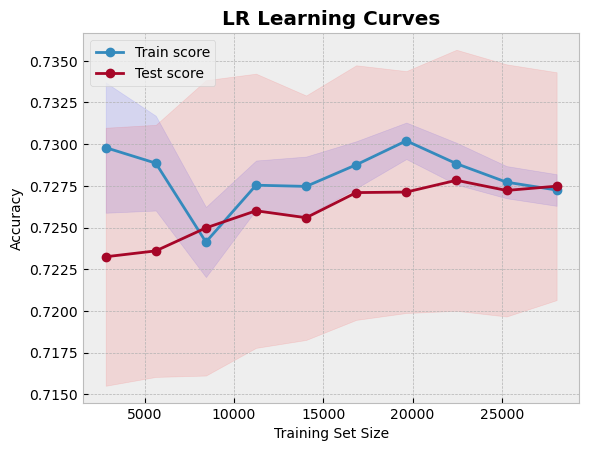

In [67]:
plot_learning_curves(best_log_reg, X_train_sc, y_train, cv=cv, 
                     title='LR Learning Curves', train_sizes=np.linspace(0.1,1.,10))

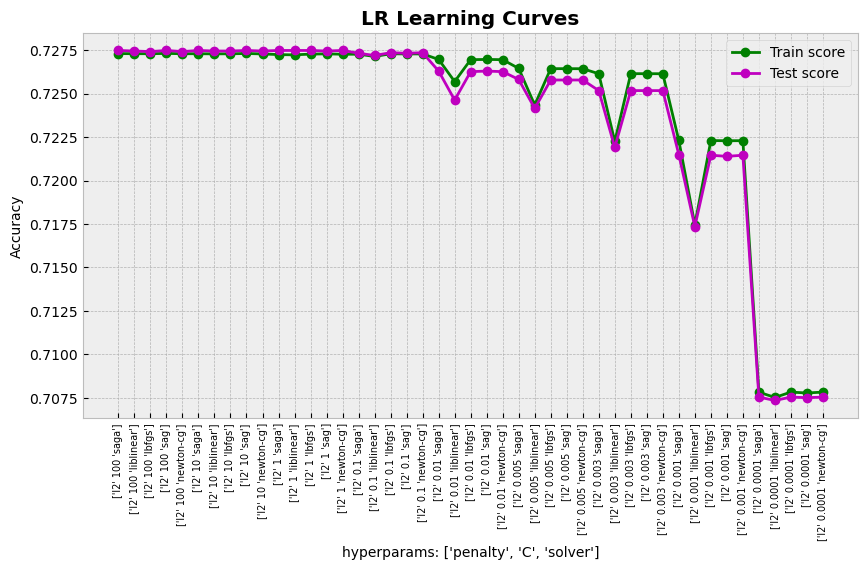

In [68]:
cv_res = pd.DataFrame(tuning_log_reg.cv_results_)

plt.figure(figsize=(10,5))
plot_scores_vs_params(cv_res, param_names=['penalty', 'C', 'solver'], 
                      title='LR Learning Curves')

#### __Confusion Matrix and the ROC Curve__

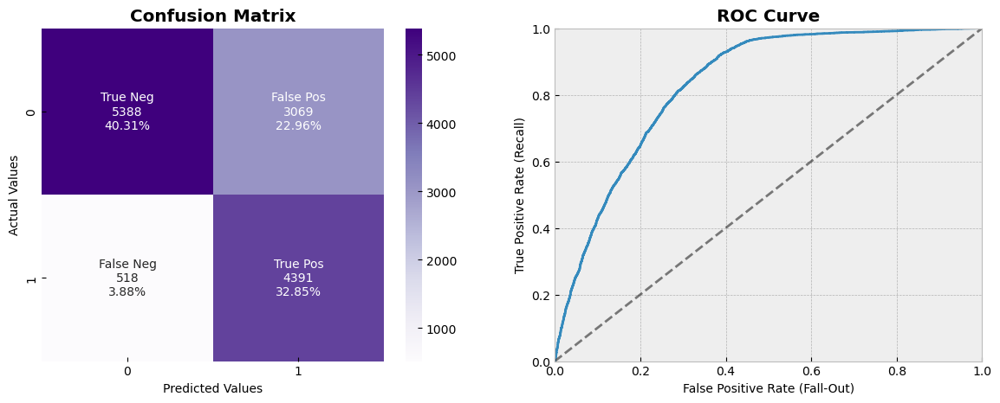

In [69]:
# Calculate the confusion matrix
conf_mx = confusion_matrix(y_val, best_log_reg.predict(X_val_sc))

# Get the scores of all instances in the validation set.
y_scores = cross_val_predict(best_log_reg, X_val_sc, y_val, cv=cv,
                             method='decision_function')
# Calculate the fpr and tpr
fpr,tpr, thresholds = roc_curve(y_val, y_scores)

# Plot the confusion matrix and the ROC curve.
plt.figure(figsize=(14,5))

plt.subplot(121)
plot_confusion_matrix(conf_mx)
plt.title('Confusion Matrix')

plt.subplot(122)
plot_roc_curve(fpr, tpr)

In [70]:
roc_auc_score(y_val, best_log_reg.predict(X_val_sc))

0.765792441954028

#### __Precision/Recall Curves__

Recall 0.888
Precision 0.591


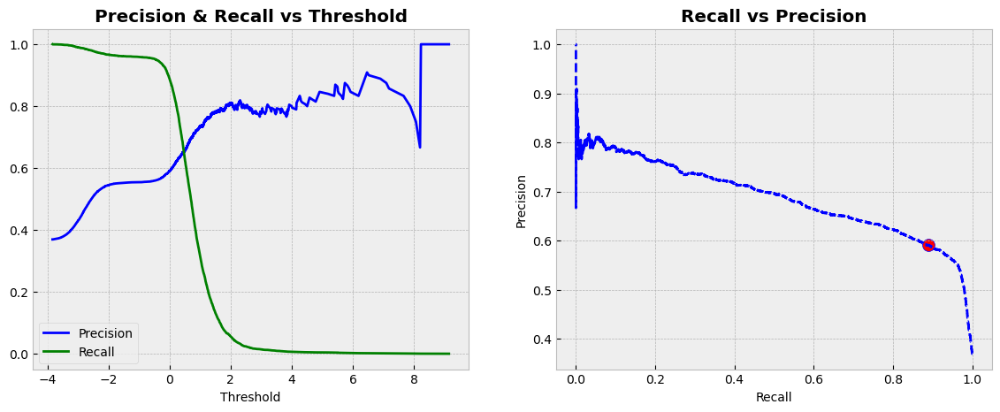

In [71]:
# Calculate precisions, recalls.
precisions, recalls, thresholds = precision_recall_curve(y_val, y_scores)

# Get the recall and precision of a model.
val_recall = cross_val_score(best_log_reg, X_val_sc, y_val, scoring='recall', cv=cv).mean()
val_prec = cross_val_score(best_log_reg, X_val_sc, y_val, scoring='precision', cv=cv).mean()
print('Recall {}'.format(val_recall.round(3)))
print('Precision {}'.format(val_prec.round(3)))

# Plot the curves
plt.figure(figsize=(14,5))
plt.subplot(121)
plot_precision_recall_vs_threshold(precisions, recalls, thresholds)

plt.subplot(122)
plot_precision_vs_recall(precisions, recalls)
plt.scatter([val_recall], [val_prec], c='r', s=100, edgecolor='b');

In [72]:
print(classification_report(y_val, best_log_reg.predict(X_val_sc),))

              precision    recall  f1-score   support

           0       0.91      0.64      0.75      8457
           1       0.59      0.89      0.71      4909

    accuracy                           0.73     13366
   macro avg       0.75      0.77      0.73     13366
weighted avg       0.79      0.73      0.74     13366



Alright, so we see that the model recognizes well the unbalanced class (only 3.88% are classified incorrectly), which indeed gives us high recall of almost 0.9, however, the precision decreases as recall increases, and so a lot of non-smokers are incorrectly predicted to be smokers (almost 23%). What can be done to increase the accuracy (and precision) of the model without sacrificing the recall we have too much? 

Let's try changing the model's threshold and see whether we get any better accuracy scores.

#### __Calculating and Setting Thresholds to Optimise Logistic Regression Performance__

Obviously we are aiming for a higher recall, and generally there are a couple of strategies which can be employed, such as assigning class weights as we've done earlier. However, if we take a look at the accuracy and the recall on the validation set so far, we'd want to explore more techniques to getting a higher accuracy while having a high recall. One of these is adjusting the classification threshold.

The sklearn's models do not give us any clear solution to the problem, these models don't let us set the threshold we want by passing it as a parameter. The default value of a threshold for `LogisticRegression` is 0.5, however, we see that there might be room for improvement, since the results aren't perfect. 

So, in order to set our own threshold and, what's more, calculate it, we can create a class which plays a role of a wrapper for a `LogisticRegression`, and broadens its abilities.

In [73]:
class CustomLogisticRegression(CustomThresholdMixin, LogisticRegression):
    """
    Classifier that inherits from LogisticRegression and adds a custom threshold parameter.
    """
    def __init__(self, C, class_weight, max_iter, solver, penalty, random_state=SEED, 
                 threshold=0.5, **kwargs):
        super().__init__(threshold=threshold)
        LogisticRegression.__init__(self, C=C, class_weight=class_weight, max_iter=max_iter, 
                                    solver=solver,random_state=random_state, penalty=penalty)
        
    def predict_proba(self, X):
        return super().predict_proba(X)
    
    def predict(self, X):
        return super().predict(X)

Let's compare two results after setting the threshold to be either the one which maximizes the accuracy of the training set or the one that gives us the recall equal to, let's say, 0.7. 

__Max Accuracy Threshold__

In [74]:
# Define a model with the custom threshold parameter.
logreg_no_threshold = CustomLogisticRegression(**best_log_reg.get_params()).fit(X_train_sc, y_train)

# Calculate the highest accuracy possible for the model.
threshold, max_accuracy, max_recall, max_prec = logreg_no_threshold\
    .threshold_from_optimal_accuracy(X_val_sc, y_val)

threshold, max_accuracy, max_recall, max_prec

(0.5748301428478086, 0.751084842136765, 0.7626807903850071, 0.6338242762823768)

In [75]:
# A model with the threshold that gives the highest accuracy.
logreg_threshold = CustomLogisticRegression(threshold=threshold,
                         **best_log_reg.get_params()).fit(X_train_sc, y_train)

# Check the scores.
tr_acc = cross_val_score(logreg_threshold, X_train_sc, y_train, cv=cv, 
                         scoring='accuracy').mean().round(4)
val_acc =  cross_val_score(logreg_threshold, X_val_sc, y_val, cv=cv, 
                           scoring='accuracy').mean().round(4)
rec = cross_val_score(logreg_threshold, X_val_sc, y_val, cv=cv, 
                      scoring='recall').mean().round(3)

print(f"Training accuracy (recall={rec}): {tr_acc}\nValidation accuracy (recall={rec}): {val_acc}")

Training accuracy (recall=0.763): 0.7433
Validation accuracy (recall=0.763): 0.7511


__Recall Threshold__

In [76]:
desired_recall = .7

# Calculate the threshold a model should have to reach the desired recall.
threshold_custom_recall, prec_custom_recall = logreg_no_threshold\
    .threshold_from_desired_recall(X_val_sc, y_val, desired_recall=desired_recall)
threshold_custom_recall, prec_custom_recall

(0.5952347819094426, 0.6421229676695944)

In [77]:
# A model with the threshold that guarantees the desired recall.
logreg_recall_threshold = CustomLogisticRegression(threshold=threshold_custom_recall,
                                **best_log_reg.get_params()).fit(X_train_sc, y_train)

# Compare the scores.
train_acc = cross_val_score(logreg_recall_threshold, X_train_sc, y_train, cv=cv, 
                            scoring='accuracy').mean().round(4)
val_acc = cross_val_score(logreg_recall_threshold, X_val_sc, y_val, cv=cv, 
                          scoring='accuracy').mean().round(4)

print(f"Training accuracy (recall={desired_recall}): {train_acc}")
print(f"Validation accuracy (recall={desired_recall}): {val_acc}")

Training accuracy (recall=0.7): 0.7442
Validation accuracy (recall=0.7): 0.7482


__Comparison__

Text(0.5, 1.0, 'Confusion Matrix (Recall  Threshold)')

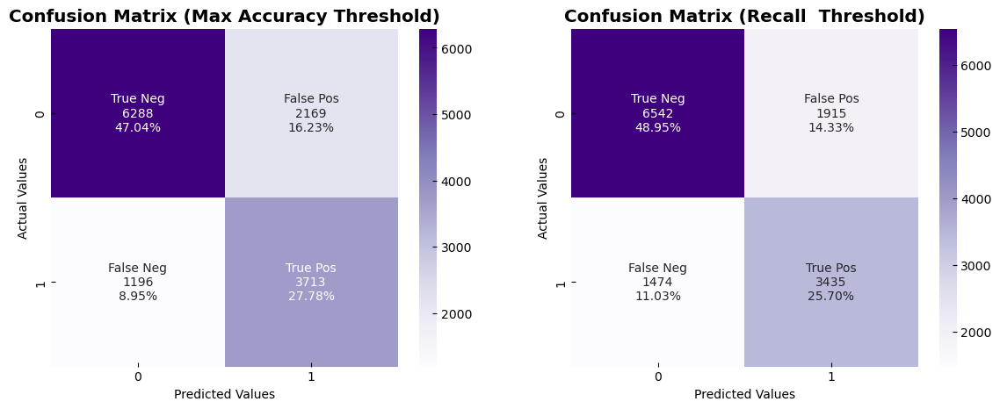

In [78]:
# Compare the confusion matrices of each model with custom threshold.
plt.figure(figsize=(14,5))
plt.subplot(121)
conf_mx = confusion_matrix(y_val, logreg_threshold.predict(X_val_sc))
plot_confusion_matrix(conf_mx)
plt.title('Confusion Matrix (Max Accuracy Threshold)')

plt.subplot(122)
conf_mx = confusion_matrix(y_val, logreg_recall_threshold.predict(X_val_sc))
plot_confusion_matrix(conf_mx)
plt.title('Confusion Matrix (Recall  Threshold)')

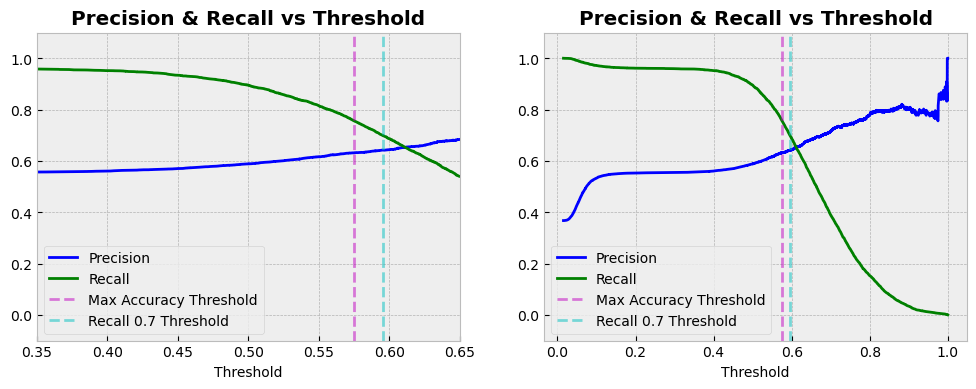

In [79]:
# Get the scores of all instances in the validation set.
y_scores = logreg_recall_threshold.predict_proba(X_val_sc)[:,1]
precisions, recalls, thresholds = precision_recall_curve(y_val, y_scores)

# Compare the precision/recall values.
fig, axs = plt.subplots(1,2, figsize=(12,4))

for i in range(len(axs)):
    plt.subplot(1,2,i+1)
    plot_precision_recall_vs_threshold(precisions, recalls, thresholds)
    plt.plot([threshold, threshold], [-0.1, 1.1], 'm--', alpha=0.5, label='Max Accuracy Threshold')
    plt.plot([threshold_custom_recall, threshold_custom_recall], [-0.1, 1.1], 'c--', 
             alpha=0.5, label=f"Recall {desired_recall} Threshold")
    
    if i==0:
        plt.xlim([0.35,0.65])
    plt.ylim([-0.1, 1.1])
    plt.legend()

In [80]:
max_acc_auc = roc_auc_score(y_val, logreg_threshold.predict(X_val_sc))
recall_auc = roc_auc_score(y_val, logreg_recall_threshold.predict(X_val_sc))
print(f"Max Accuracy AUC: {max_acc_auc.round(3)}\nRecall {desired_recall} AUC: {recall_auc.round(3)}")

Max Accuracy AUC: 0.75
Recall 0.7 AUC: 0.737


In [81]:
print(classification_report(y_val, logreg_recall_threshold.predict(X_val_sc),))

              precision    recall  f1-score   support

           0       0.82      0.77      0.79      8457
           1       0.64      0.70      0.67      4909

    accuracy                           0.75     13366
   macro avg       0.73      0.74      0.73     13366
weighted avg       0.75      0.75      0.75     13366



Okay, at the first look, both models with custom thresholds give us quite similar results. Both trade some recall for precision, and the only difference is how much of that recall is sacrificed. 
So the max accuracy threshold model gives us the best accuracy on the validation set so far, which is 75.11% at recall equal to 0.76 and precision equal to around 0.62. On the contrary, the second model which was required to have a recall of 0.7 gives us the accuracy of 74.82% and precision of 0.64. The confusion matrices tell us that the first model more frequently predicts a non-smoker to be a smoker (16%) than the other way around (9%). The same goes for the second model, only that the number of False Neg is a bit greater than for the first model.

We'll choose the threshold model that gives the recall of 0.7 to be the best one here, because it balances recall and precision without sacrificing too much precision for a higher recall and the difference between False Neg and False Pos is not that great, which leaves us with the chance of correctly predicting both categories right.

__Test Accuracy__

In [82]:
cross_val_score(logreg_recall_threshold, X_test_sc, y_test, cv=cv, 
                scoring='accuracy').mean().round(4)

0.7453

In [83]:
test_results = pd.DataFrame()
test_results = test_results.append({
    'Model':'Logistic Regression', 
    'Accuracy': cross_val_score(logreg_recall_threshold, X_test_sc, y_test, cv=cv, 
                                scoring='accuracy').mean().round(4)*100,
    'Recall': cross_val_score(logreg_recall_threshold, X_test_sc, y_test, cv=cv, 
                              scoring='recall').mean().round(3),
    'Precision': cross_val_score(logreg_recall_threshold, X_test_sc, y_test, cv=cv, 
                                 scoring='precision').mean().round(3),
    'ROC AUC': roc_auc_score(y_test, logreg_recall_threshold.predict(X_test_sc)).round(3)
}, ignore_index=True,)
test_results

/opt/conda/lib/python3.7/site-packages/sklearn/linear_model/_logistic.py:818: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG,
/opt/conda/lib/python3.7/site-packages/sklearn/linear_model/_logistic.py:818: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


,Model,Accuracy,Recall,Precision,ROC AUC
0,Logistic Regression,74.53,0.714,0.637,0.739


<a id="sgd"></a>
# 6.2. Stochastic Gradient Descent

The hyperparameters: `penalty`, `alpha`, `loss`, `learning_rate`

In [84]:
# Initialize the model.
sgd_clf = SGDClassifier(random_state=SEED, )

param_grid={
    'penalty':['l2',],
    'loss':['log',],
    'alpha':[1e-5, 1e-3, 1e-2, 0.1,],
    'eta0':[1e-3, 1e-2, .1, 0, 1],
}

# Tune the model.
tuning_sgd = GridSearchCV(sgd_clf, param_grid, cv=cv,scoring='accuracy', n_jobs=-1,
                              return_train_score=True)
tuning_sgd.fit(X_train_sc, y_train)

GridSearchCV(cv=StratifiedKFold(n_splits=10, random_state=19, shuffle=True),
             estimator=SGDClassifier(random_state=19), n_jobs=-1,
             param_grid={'alpha': [1e-05, 0.001, 0.01, 0.1],
                         'eta0': [0.001, 0.01, 0.1, 0, 1], 'loss': ['log'],
                         'penalty': ['l2']},
             return_train_score=True, scoring='accuracy')

In [85]:
best_sgd = tuning_sgd.best_estimator_
best_sgd

SGDClassifier(alpha=0.001, eta0=0.001, loss='log', random_state=19)

In [86]:
tr_acc = cross_val_score(best_sgd, X_train_sc, y_train, cv=cv,
                         scoring='accuracy').mean().round(4)
val_acc = cross_val_score(best_sgd, X_val_sc, y_val, cv=cv,
                          scoring='accuracy').mean().round(4)
print("Train accuracy: {}\nValid accuracy: {}".format(tr_acc, val_acc))

Train accuracy: 0.7432
Valid accuracy: 0.7461


We got the accuracy a bit higher than that for the baseline models trained on scaled data.

#### __Learning Curves__

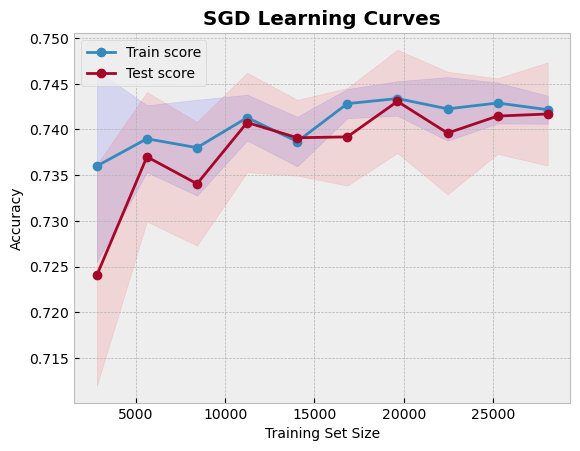

In [87]:
plot_learning_curves(best_sgd, X_train_sc, y_train, cv=cv, 
                     title='SGD Learning Curves', train_sizes=np.linspace(0.1,1.,10))

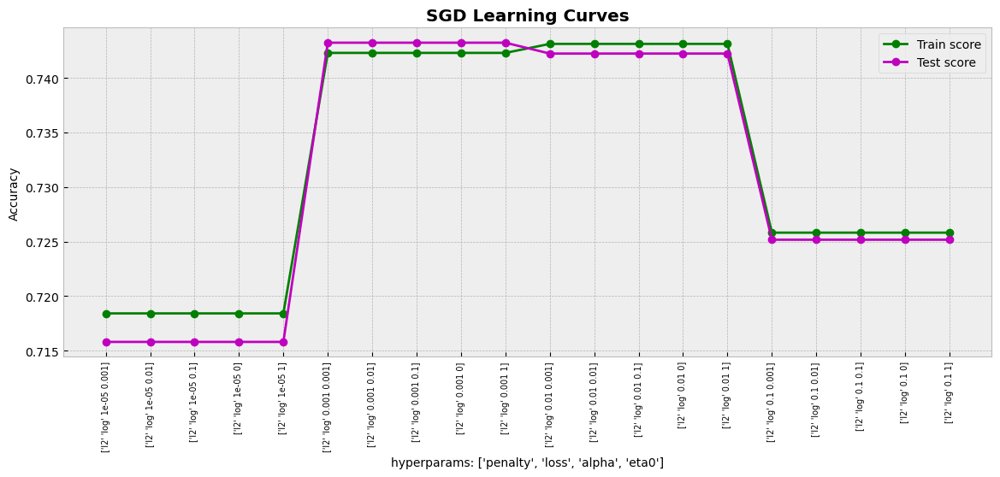

In [88]:
cv_res = pd.DataFrame(tuning_sgd.cv_results_)

plt.figure(figsize=(14,5))
plot_scores_vs_params(cv_res, param_names=['penalty', 'loss', 'alpha', 'eta0'], 
                      title='SGD Learning Curves')

#### __Confusion Matrix and the ROC Curve__

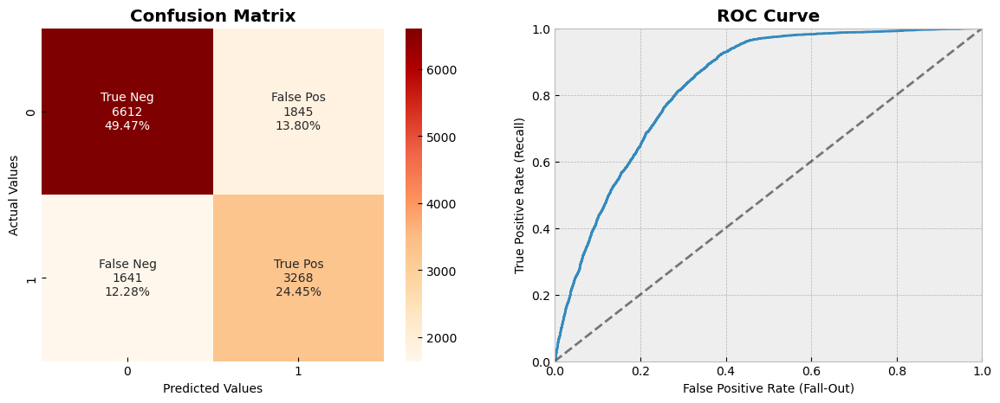

In [89]:
# Calculate the confusion matrix
conf_mx = confusion_matrix(y_val, best_sgd.predict(X_val_sc))

# Get the scores of all instances in the validation set.
y_scores = cross_val_predict(best_log_reg, X_val_sc, y_val, cv=cv,
                             method='decision_function')
# Calculate the fpr and tpr
fpr,tpr, thresholds = roc_curve(y_val, y_scores)

# Plot the confusion matrix and the ROC curve.
plt.figure(figsize=(14,5))

plt.subplot(121)
plot_confusion_matrix(conf_mx, cmap='OrRd')
plt.title('Confusion Matrix')

plt.subplot(122)
plot_roc_curve(fpr, tpr)

In [90]:
roc_auc_score(y_val, best_sgd.predict(X_val_sc))

0.7237767814088709

#### __Precision/Recall Curves__

Recall 0.687
Precision 0.645


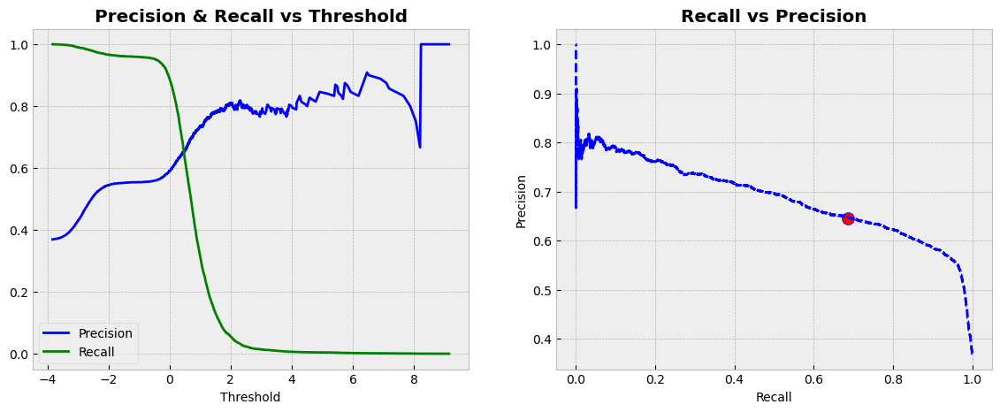

In [91]:
# Calculate precisions, recalls.
precisions, recalls, thresholds = precision_recall_curve(y_val, y_scores)

# Get the recall and precision of a model.
val_recall = cross_val_score(best_sgd, X_val_sc, y_val, scoring='recall', cv=cv).mean()
val_prec = cross_val_score(best_sgd, X_val_sc, y_val, scoring='precision', cv=cv).mean()
print('Recall {}'.format(val_recall.round(3)))
print('Precision {}'.format(val_prec.round(3)))

# Plot the curves
plt.figure(figsize=(14,5))
plt.subplot(121)
plot_precision_recall_vs_threshold(precisions, recalls, thresholds)

plt.subplot(122)
plot_precision_vs_recall(precisions, recalls)
plt.scatter([val_recall], [val_prec], c='r', s=100, edgecolor='b');

In [92]:
print(classification_report(y_val, best_sgd.predict(X_val_sc),))

              precision    recall  f1-score   support

           0       0.80      0.78      0.79      8457
           1       0.64      0.67      0.65      4909

    accuracy                           0.74     13366
   macro avg       0.72      0.72      0.72     13366
weighted avg       0.74      0.74      0.74     13366



Looking at the confusion matrix for the tuned SGD, we see that it gives us similar results to these for Logistic Regression with custom recall of 0.7, though here we have a bit more of False Neg, and a lower recall (0.687), as expected. Let's use the same approach and try to adjust the threshold to get better results.

#### __Adjusting the threshold__

Since we want to check whether we can achieve even higher recall with good accuracy, let's try tweaking the `SGDClassfier`'s threshold which is 0 by default. We'll do it exactly the same way we did for Logistic Regression model: we'll be comparing two thresholds - the one that maximizes the accuracy and the one that gives us the desired recall.

In [93]:
class CustomSGD(CustomThresholdMixin, SGDClassifier):
    """
    Classifier that inherits from LogisticRegression and adds a custom threshold parameter.
    """
    def __init__(self, alpha, eta0, loss, random_state=SEED, threshold=0.5, **kwargs):
        super().__init__(threshold=threshold)
        SGDClassifier.__init__(self, alpha=alpha, eta0=eta0, loss=loss, random_state=random_state)
    
    def predict_proba(self, X):
        return super().predict_proba(X)
    
    def predict(self, X):
        return super().predict(X)

In [94]:
# Define a model with the custom threshold parameter.
sgd_no_threshold = CustomSGD(**best_sgd.get_params()).fit(X_train_sc, y_train)

# Calculate the highest accuracy possible for the model.
threshold, max_accuracy, max_recall, max_prec = sgd_no_threshold\
    .threshold_from_optimal_accuracy(X_val_sc, y_val)

threshold, max_accuracy, max_recall, max_prec

(0.5044901833007872, 0.746670656890618, 0.6773273579140354, 0.6484009360374415)

In [95]:
# A model with the threshold that gives the highest accuracy.
sgd_threshold = CustomSGD(threshold=threshold, **best_sgd.get_params()).fit(X_train_sc, y_train)

# Check the scores.
tr_acc = cross_val_score(sgd_threshold, X_train_sc, y_train, cv=cv, 
                         scoring='accuracy').mean().round(4)
val_acc =  cross_val_score(sgd_threshold, X_val_sc, y_val, cv=cv, 
                           scoring='accuracy').mean().round(4)
rec = cross_val_score(sgd_threshold, X_val_sc, y_val, cv=cv, 
                      scoring='recall').mean().round(3)

print(f"Training accuracy (recall={rec}): {tr_acc}\nValidation accuracy (recall={rec}): {val_acc}")

Training accuracy (recall=0.677): 0.7433
Validation accuracy (recall=0.677): 0.7467


In [96]:
desired_recall = .75

# Calculate the threshold a model should have to reach the desired recall.
threshold_custom_recall, prec_custom_recall = sgd_no_threshold\
    .threshold_from_desired_recall(X_val_sc, y_val, desired_recall=desired_recall)

threshold_custom_recall, prec_custom_recall

(0.46957150517798196, 0.6208466857817507)

In [97]:
# A model with the threshold that guarantees the desired recall.
sgd_recall_threshold = CustomSGD(threshold=threshold_custom_recall, 
                                 **best_sgd.get_params()).fit(X_train_sc, y_train)

# Compare the scores.
train_acc = cross_val_score(sgd_recall_threshold, X_train_sc, y_train, cv=cv, 
                            scoring='accuracy').mean().round(4)
val_acc = cross_val_score(sgd_recall_threshold, X_val_sc, y_val, cv=cv, 
                          scoring='accuracy').mean().round(4)

print(f"Training accuracy (recall={desired_recall}): {train_acc}")
print(f"Validation accuracy (recall={desired_recall}): {val_acc}")

Training accuracy (recall=0.75): 0.742
Validation accuracy (recall=0.75): 0.7439


__Comparison__

Text(0.5, 1.0, 'Confusion Matrix (Recall  Threshold)')

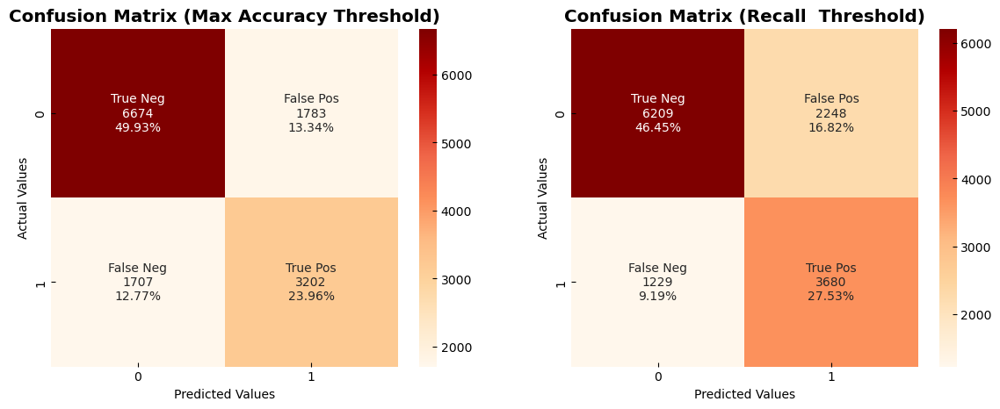

In [98]:
# Compare the confusion matrices of each model with custom threshold.
plt.figure(figsize=(14,5))
plt.subplot(121)
conf_mx = confusion_matrix(y_val, sgd_threshold.predict(X_val_sc))
plot_confusion_matrix(conf_mx, cmap='OrRd')
plt.title('Confusion Matrix (Max Accuracy Threshold)')

plt.subplot(122)
conf_mx = confusion_matrix(y_val, sgd_recall_threshold.predict(X_val_sc))
plot_confusion_matrix(conf_mx, cmap='OrRd')
plt.title('Confusion Matrix (Recall  Threshold)')

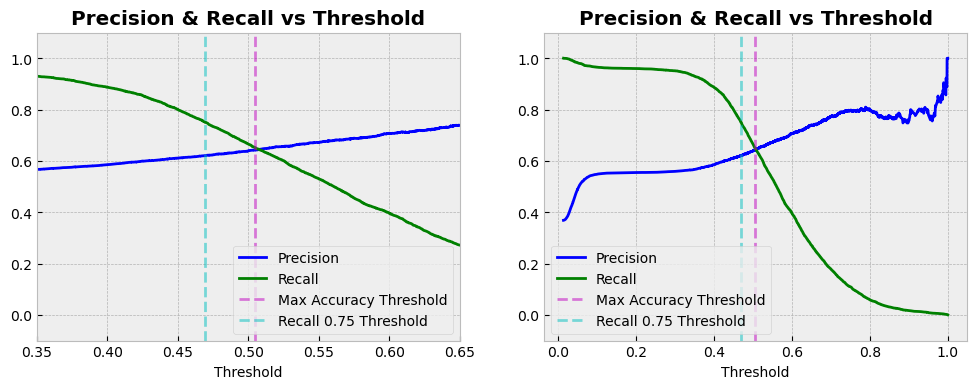

In [99]:
# Get the scores of all instances in the validation set.
y_scores = sgd_threshold.predict_proba(X_val_sc)[:,1]
precisions, recalls, thresholds = precision_recall_curve(y_val, y_scores)

# Compare the precision/recall values.
fig, axs = plt.subplots(1,2, figsize=(12,4))

for i in range(len(axs)):
    plt.subplot(1,2,i+1)
    plot_precision_recall_vs_threshold(precisions, recalls, thresholds)
    plt.plot([threshold, threshold], [-0.1, 1.1], 'm--', alpha=0.5, label='Max Accuracy Threshold')
    plt.plot([threshold_custom_recall, threshold_custom_recall], [-0.1, 1.1], 'c--', 
             alpha=0.5, label=f"Recall {desired_recall} Threshold")
    
    if i==0:
        plt.xlim([0.35,0.65])
    plt.ylim([-0.1, 1.1])
    plt.legend()

In [100]:
max_acc_auc = roc_auc_score(y_val, sgd_threshold.predict(X_val_sc))
recall_auc = roc_auc_score(y_val, sgd_recall_threshold.predict(X_val_sc))
print(f"Max Accuracy AUC: {max_acc_auc.round(3)}\nRecall {desired_recall} AUC: {recall_auc.round(3)}")

Max Accuracy AUC: 0.721
Recall 0.75 AUC: 0.742


Great! These results look really interesting. The models have different recalls (0.68 and 0.75), but almost the same accuracies. If we look closely at the confusion matrices, we'll see that since the higher recall model yields better results (less False Neg and a sufficiently low number of False Neg) it would be wise to choose the second model with recall=0.75 to evaluate the test set on. That's exactly our plan.

__Test Accuracy__

In [101]:
cross_val_score(sgd_recall_threshold, X_test_sc, y_test, cv=cv, scoring='accuracy').mean().round(4)

0.7465

In [102]:
test_results = test_results.append({
    'Model':'SGD', 
    'Accuracy': cross_val_score(sgd_recall_threshold, X_test_sc, y_test, cv=cv, 
                                scoring='accuracy').mean().round(4)*100,
    'Recall': cross_val_score(sgd_recall_threshold, X_test_sc, y_test, cv=cv, 
                              scoring='recall').mean().round(3),
    'Precision': cross_val_score(sgd_recall_threshold, X_test_sc, y_test, cv=cv, 
                                 scoring='precision').mean().round(3),
    'ROC AUC': roc_auc_score(y_test, sgd_recall_threshold.predict(X_test_sc)).round(3)
}, ignore_index=True)
test_results

,Model,Accuracy,Recall,Precision,ROC AUC
0,Logistic Regression,74.53,0.714,0.637,0.739
1,SGD,74.65,0.767,0.628,0.748


<a id="knn"></a>
# 6.3. K-Nearest Neighbors

K-Nearest neighbors (KNN) is a non-parametric classification algortithm that classifies a data point by finding the k nearest neighbors to the point and assigning it to the majority class of those neighbors. That said, choosing a right value of k plays a huge role. Generally, a higher value of k can make the model more stable and reduce the effect of noise or the outliers, while a lower value of k can make the model more sensitive to local patterns in the data. 

Also, KNN is a distance-based algorithm, as it calculates distances between data points to classify them, thus it's important to scale the features to a similar range before fitting the model. If the features have different scales, some features may dominate the distance calculations and skew the classification results, and that certainly won't improve model's generalization.

The hyperparameters: `n_neighbors`

In [103]:
knn = KNeighborsClassifier()

#### __Recursive Feature Elimination (RFE)__

RFE is a feature selection technique that recursively removes features from the dataset and trains the model on the remaining features. By removing irrelevant or redundant features, RFE can improve the accuracy of the model by reducing the noise in the dataset and allowing the model to focus on the most informative features. However, as expected, RFE may not always lead to better performance, as it may remove some useful features along with the irrelevant ones. 

We'll use a simple CART for a base estimator and check what number of features the KNN is trained on gives us a high accuracy on the validation set.

In [104]:
# Generate models with different number of features and with CART for a base estimator.
models=dict()
for i in range(10,25):
    rfe = RFE(estimator=DecisionTreeClassifier(random_state=SEED), n_features_to_select=i)
    models[str(i)] = Pipeline(steps=[('feat_select',rfe), ('model',knn)])
    
# Evaluate the models on the validation set.
results = evaluate_models(X_train_sc, y_train, X_val_sc, y_val, models)
plot_boxplot_summary(results, color=None, xlabel='features selected', 
            ylabel='Accuracy', title='Exploring n_features_to_select (RFE for KNN)')

>> 10: 0.7158 (+/- 0.0094)
>> 11: 0.7120 (+/- 0.0111)
>> 12: 0.7092 (+/- 0.0136)
>> 13: 0.7131 (+/- 0.0099)
>> 14: 0.7168 (+/- 0.0134)
>> 15: 0.7170 (+/- 0.0091)
>> 16: 0.7203 (+/- 0.0113)
>> 17: 0.7121 (+/- 0.0110)
>> 18: 0.7082 (+/- 0.0138)
>> 19: 0.7114 (+/- 0.0156)
>> 20: 0.7206 (+/- 0.0156)
>> 21: 0.7138 (+/- 0.0141)
>> 22: 0.7129 (+/- 0.0153)
>> 23: 0.7127 (+/- 0.0173)
>> 24: 0.7129 (+/- 0.0177)


We'll choose n_features_to_select to be around 20, since models with these numbers of features seem to fit the validation set well. We won't be considering 16, because it may lead to underfitting.

In [105]:
rfe = RFE(estimator=DecisionTreeClassifier(random_state=SEED), 
          n_features_to_select=20).fit(X_train_sc, y_train)

X_train_sc_rfe, X_val_sc_rfe = rfe.transform(X_train_sc), rfe.transform(X_val_sc)
X_test_sc_rfe = rfe.transform(X_test_sc)

knn.fit(X_train_sc_rfe, y_train)
tr_acc = cross_val_score(knn, X_train_sc_rfe, y_train, cv=cv,scoring='accuracy').mean().round(4)
val_acc = cross_val_score(knn, X_val_sc_rfe, y_val, cv=cv,scoring='accuracy').mean().round(4)
print("Train accuracy: {}\nValid accuracy: {}".format(tr_acc, val_acc))

Train accuracy: 0.7249
Valid accuracy: 0.7206


#### __The Optimal Number of Neighbors__

This time we'll first plot the accuracy on both training and validation sets for different values of `n_neighbors`, and then select the approximate range for the `GridSearchCV` from the plot. 

In [106]:
knns_per_k = [KNeighborsClassifier(n_neighbors=k).fit(X_train_sc_rfe, y_train) 
              for k in np.arange(10,300,10)]

In [107]:
train_accuracies_per_k = [cross_val_score(knn, X_train_sc_rfe, y_train, cv=cv,
                                        scoring='accuracy').mean().round(4) for knn in knns_per_k]
val_accuracies_per_k = [cross_val_score(knn, X_val_sc_rfe, y_val, cv=cv,
                                        scoring='accuracy').mean().round(4) for knn in knns_per_k]

Text(0, 0.5, 'Accuracy')

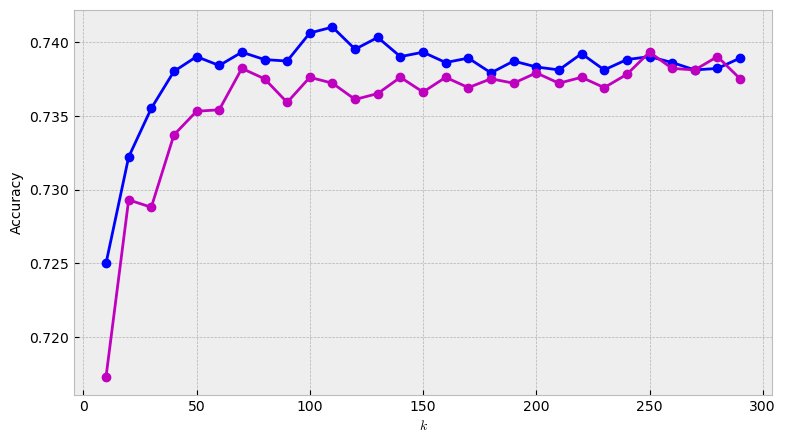

In [108]:
plt.figure(figsize=(9, 5))
plt.plot(np.arange(10,300,10), train_accuracies_per_k, "bo-")
plt.plot(np.arange(10,300,10), val_accuracies_per_k, "mo-")

plt.xlabel('$k$')
plt.ylabel('Accuracy')

#### __Tuning the KNN__

In [109]:
param_grid={
    'n_neighbors':[70,160,180], 
    'weights': ['uniform', 'distance'],
    'metric':['minkowski','manhattan','l1','l2']
}

# Tune the model.
tuning_knn = GridSearchCV(knn, param_grid, verbose = 1, cv=cv, 
                          scoring='accuracy', n_jobs = -1, return_train_score=True)
tuning_knn.fit(X_train_sc_rfe, y_train)

Fitting 10 folds for each of 24 candidates, totalling 240 fits


GridSearchCV(cv=StratifiedKFold(n_splits=10, random_state=19, shuffle=True),
             estimator=KNeighborsClassifier(), n_jobs=-1,
             param_grid={'metric': ['minkowski', 'manhattan', 'l1', 'l2'],
                         'n_neighbors': [70, 160, 180],
                         'weights': ['uniform', 'distance']},
             return_train_score=True, scoring='accuracy', verbose=1)

In [110]:
best_knn = tuning_knn.best_estimator_
best_knn

KNeighborsClassifier(metric='manhattan', n_neighbors=160, weights='distance')

In [111]:
tr_acc = cross_val_score(best_knn, X_train_sc_rfe, y_train, cv=cv,
                         scoring='accuracy').mean().round(4)
val_acc = cross_val_score(best_knn, X_val_sc_rfe, y_val, cv=cv,
                          scoring='accuracy').mean().round(4)

print("Train accuracy: {}\nValid accuracy: {}".format(tr_acc, val_acc))

Train accuracy: 0.7942
Valid accuracy: 0.7637


Awesome, the fine-tuned KNN (76.37%) outperforms the baseline KNN trained on scaled data (71.15%) by around 5%.

#### __Learning Curves__

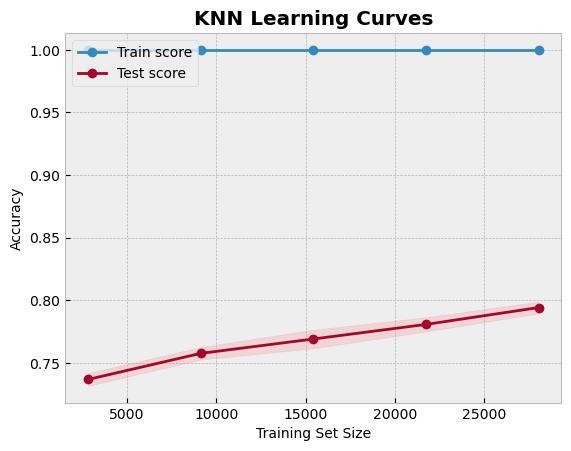

In [112]:
plot_learning_curves(best_knn, X_train_sc_rfe, y_train, cv=cv, 
                     title='KNN Learning Curves', train_sizes=np.linspace(0.1,1.,5))

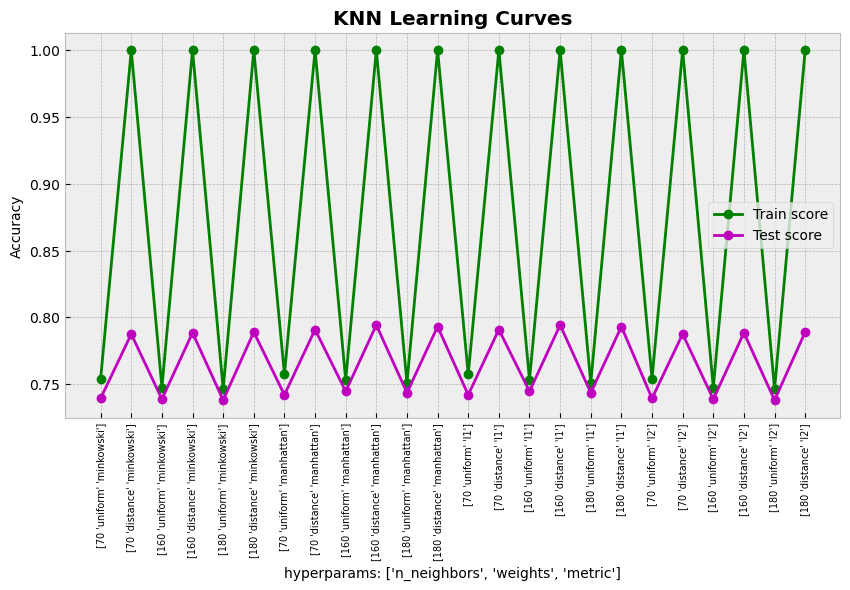

In [113]:
cv_res = pd.DataFrame(tuning_knn.cv_results_)

plt.figure(figsize=(10,5))
plot_scores_vs_params(cv_res, param_names=['n_neighbors', 'weights', 'metric'], 
                      title='KNN Learning Curves')

#### __Confusion Matrix and the ROC Curve__

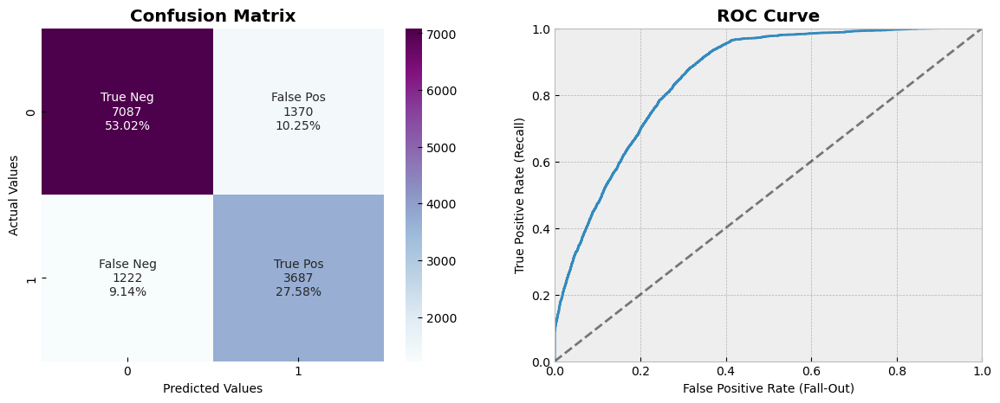

In [114]:
# Calculate the confusion matrix
conf_mx = confusion_matrix(y_val, best_knn.predict(X_val_sc_rfe))

# Get the scores of all instances in the validation set.
y_scores = cross_val_predict(best_knn, X_val_sc_rfe, y_val, cv=cv,
                             method='predict_proba')[:,1]
# Calculate the fpr and tpr
fpr,tpr, thresholds = roc_curve(y_val, y_scores)

# Plot the confusion matrix and the ROC curve.
plt.figure(figsize=(14,5))

plt.subplot(121)
plot_confusion_matrix(conf_mx, cmap='BuPu')
plt.title('Confusion Matrix')

plt.subplot(122)
plot_roc_curve(fpr, tpr)

In [115]:
roc_auc_score(y_val, best_knn.predict(X_val_sc_rfe))

0.7945367422937596

#### __Precision/Recall Curves__

Recall 0.739
Precision 0.659


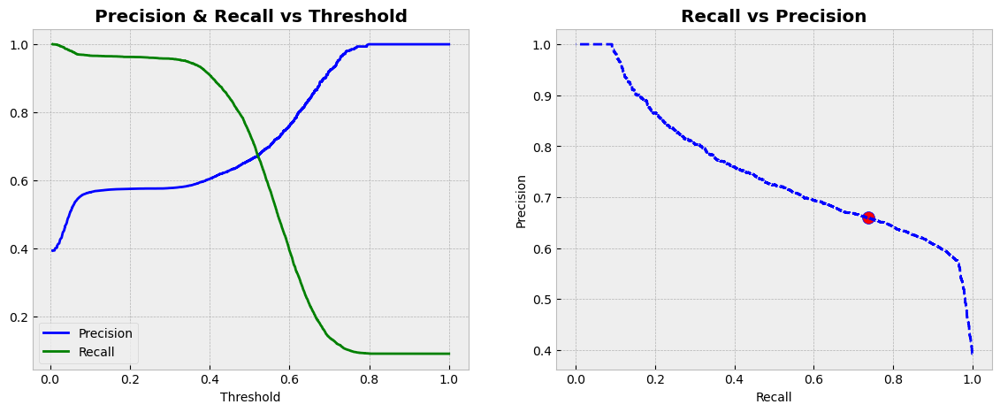

In [116]:
# Calculate the precisions and recalls for every threshold.
precisions, recalls, thresholds = precision_recall_curve(y_val, y_scores)

# Get the recall and precision of a model.
val_recall = cross_val_score(best_knn, X_val_sc_rfe, y_val, scoring='recall', cv=cv).mean()
val_prec = cross_val_score(best_knn, X_val_sc_rfe, y_val, scoring='precision', cv=cv).mean()
print('Recall {}'.format(val_recall.round(3)))
print('Precision {}'.format(val_prec.round(3)))

# Plot the curves
plt.figure(figsize=(14,5))
plt.subplot(121)
plot_precision_recall_vs_threshold(precisions, recalls, thresholds)

plt.subplot(122)
plot_precision_vs_recall(precisions, recalls)
plt.scatter([val_recall], [val_prec], c='r', s=100, edgecolor='b');

In [117]:
print(classification_report(y_val, best_knn.predict(X_val_sc_rfe),))

              precision    recall  f1-score   support

           0       0.85      0.84      0.85      8457
           1       0.73      0.75      0.74      4909

    accuracy                           0.81     13366
   macro avg       0.79      0.79      0.79     13366
weighted avg       0.81      0.81      0.81     13366



Due to a high accuracy of the KNN on the validation set, the difference between False Neg and False Pos seems rather negligible and the recall and Fall-Out look fine, so we'll just evaluate the model.

#### __Test Results__

Let's now evaluate the performance of the model on new, unseen data, namely the test set.

In [118]:
cross_val_score(best_knn, X_test_sc_rfe, y_test, cv=cv, scoring='accuracy').mean().round(4)

0.7656

In [119]:
test_results = test_results.append({
    'Model':'KNN', 
    'Accuracy': cross_val_score(best_knn, X_test_sc_rfe, y_test, cv=cv, 
                                scoring='accuracy').mean().round(4)*100,
    'Recall': cross_val_score(best_knn, X_test_sc_rfe, y_test, cv=cv, 
                              scoring='recall').mean().round(3),
    'Precision': cross_val_score(best_knn, X_test_sc_rfe, y_test, cv=cv, 
                                 scoring='precision').mean().round(3),
    'ROC AUC': roc_auc_score(y_test, best_knn.predict(X_test_sc_rfe)).round(3)
}, ignore_index=True)
test_results

,Model,Accuracy,Recall,Precision,ROC AUC
0,Logistic Regression,74.53,0.714,0.637,0.739
1,SGD,74.65,0.767,0.628,0.748
2,KNN,76.56,0.741,0.661,0.794


<a id="cart"></a>
# 6.4. Classification and Regression Trees (CART)

CART is a decision tree algorithm that works by recursively splitting the feature space into regions based on the values of the input features. Usually, it continues to split the data into smaller and smaller subgroups until a stopping criterion is met (such as Gini index or entropy). Then in case of classification it outputs the majority class label in each group (leaf node).

One common problem with decision trees, including CART, is overfitting. This usually happens when we have the trees that are too deep so that they can capture noise in data, and lead to overfitting (that's why we have got to careful when choosing the ranges for `max_depth` and `min_samples_leaf`). This can also happen when CART starts to generate complex splits, so we need to pay attention to the `min_samples_split` hyperparameter too. 

The hyperparameters: `max_depth`, `min_samples_split`, `min_samples_leaf`

We'll be training a CART model on scaled data rather than unscaled data. That's because CART uses the values of the features to split the data at each node of the tree. If the features have different scales, then some features may dominate the others. This can lead to a biased tree, where some features are given more importance than others. Additionally, scaling can help to speed up the training process by reducing the number of iterations required for convergence.

In [120]:
dtr = DecisionTreeClassifier(random_state=SEED, class_weight={0:0.45, 1:0.55})

#### __Recursive Feature Elimination (RFE)__

In [121]:
# Generate models with different number of features and with CART for a base estimator.
models=dict()
for i in range(10,25):
    rfe = RFE(estimator=LogisticRegression(random_state=SEED), n_features_to_select=i)
    models[str(i)] = Pipeline(steps=[('feat_select',rfe), ('model',dtr)])
    
# Evaluate the models on the validation set.
results = evaluate_models(X_train_sc, y_train, X_val_sc, y_val, models)
plot_boxplot_summary(results, color=None, xlabel='features selected', 
            ylabel='Accuracy', title='Exploring n_features_to_select (RFE for CART)')

>> 10: 0.7147 (+/- 0.0083)
>> 11: 0.7114 (+/- 0.0089)
>> 12: 0.7113 (+/- 0.0085)
>> 13: 0.7139 (+/- 0.0110)
>> 14: 0.7144 (+/- 0.0091)
>> 15: 0.7110 (+/- 0.0082)
>> 16: 0.7088 (+/- 0.0081)
>> 17: 0.7126 (+/- 0.0121)
>> 18: 0.7128 (+/- 0.0092)
>> 19: 0.7168 (+/- 0.0081)
>> 20: 0.7160 (+/- 0.0102)
>> 21: 0.7144 (+/- 0.0102)
>> 22: 0.7179 (+/- 0.0100)
>> 23: 0.7180 (+/- 0.0100)
>> 24: 0.7170 (+/- 0.0140)


In [122]:
rfe = RFE(estimator=LogisticRegression(random_state=SEED), 
          n_features_to_select=21).fit(X_train_sc, y_train)

# Reduce the dimensionality of the data.
X_train_sc_rfe, X_val_sc_rfe = rfe.transform(X_train_sc), rfe.transform(X_val_sc)
X_test_sc_rfe = rfe.transform(X_test_sc)

# Fit the classifier with reduced training set and check the scores.
tr_acc = cross_val_score(dtr, X_train_sc_rfe, y_train, cv=cv,scoring='accuracy').mean().round(4)
val_acc = cross_val_score(dtr, X_val_sc_rfe, y_val, cv=cv,scoring='accuracy').mean().round(4)

print("Train accuracy: {}\nValid accuracy: {}".format(tr_acc, val_acc))

Train accuracy: 0.7493
Valid accuracy: 0.7161


#### __Fine-Tuning the Model__

In [123]:
dtr = DecisionTreeClassifier(random_state=SEED, class_weight={0:0.45, 1:0.55})

param_grid = {
    "max_depth": [10,15,25,35,45],                                                      
    "min_samples_leaf": [10,15,20,30,40],
    'criterion':['gini','entropy'],
    'min_samples_split':[2,4,6],
}

tuning_dtr = GridSearchCV(dtr, param_grid=param_grid, scoring='accuracy', cv=cv, n_jobs=-1,
                          return_train_score=True)
tuning_dtr.fit(X_train_sc_rfe, y_train )

GridSearchCV(cv=StratifiedKFold(n_splits=10, random_state=19, shuffle=True),
             estimator=DecisionTreeClassifier(class_weight={0: 0.45, 1: 0.55},
                                              random_state=19),
             n_jobs=-1,
             param_grid={'criterion': ['gini', 'entropy'],
                         'max_depth': [10, 15, 25, 35, 45],
                         'min_samples_leaf': [10, 15, 20, 30, 40],
                         'min_samples_split': [2, 4, 6]},
             return_train_score=True, scoring='accuracy')

In [124]:
best_dtr = tuning_dtr.best_estimator_
best_dtr

DecisionTreeClassifier(class_weight={0: 0.45, 1: 0.55}, criterion='entropy',
                       max_depth=10, min_samples_leaf=30, random_state=19)

In [125]:
tr_acc = cross_val_score(best_dtr, X_train_sc_rfe, y_train, cv=cv,
                         scoring='accuracy').mean().round(4)
val_acc = cross_val_score(best_dtr, X_val_sc_rfe, y_val, cv=cv,
                          scoring='accuracy').mean().round(4) 

print("Train accuracy: {}\nValid accuracy: {}".format(tr_acc, val_acc))

Train accuracy: 0.7427
Valid accuracy: 0.7442


The baseline CART gave us 70% of accuracy on the validation set, and the fine-tuned model gives us 74.42%. That makes a difference, but not a big one, unfortunately.

#### __Learning Curves__

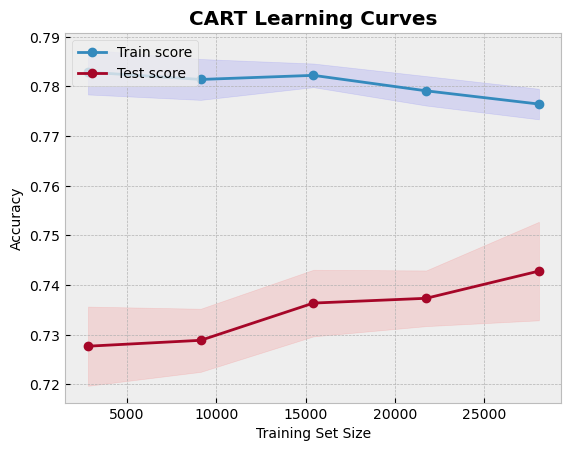

In [126]:
plot_learning_curves(best_dtr, X_train_sc_rfe, y_train, cv=cv, 
                     title='CART Learning Curves', train_sizes=np.linspace(0.1,1.,5))

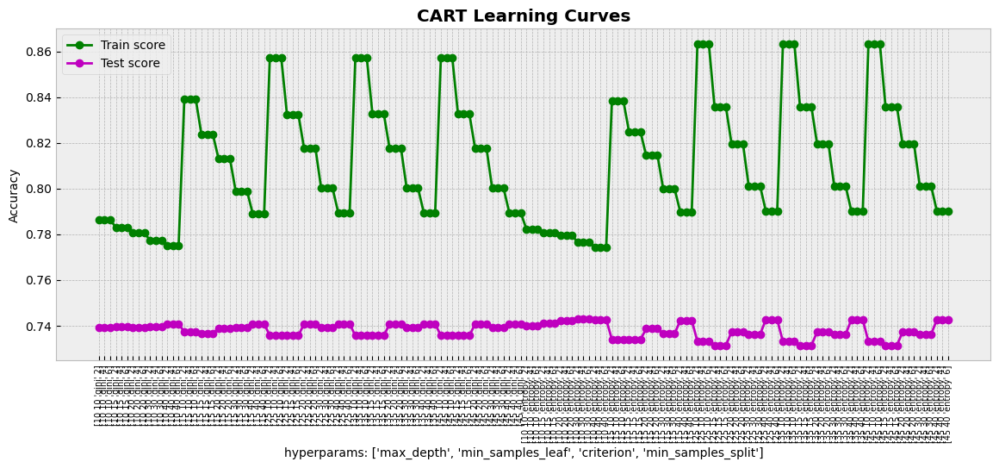

In [127]:
cv_res = pd.DataFrame(tuning_dtr.cv_results_)

plt.figure(figsize=(14,5))
plot_scores_vs_params(cv_res, param_names=['max_depth', 'min_samples_leaf', 'criterion',
                                    'min_samples_split'], title='CART Learning Curves')

#### __Confusion Matrix and the ROC Curve__

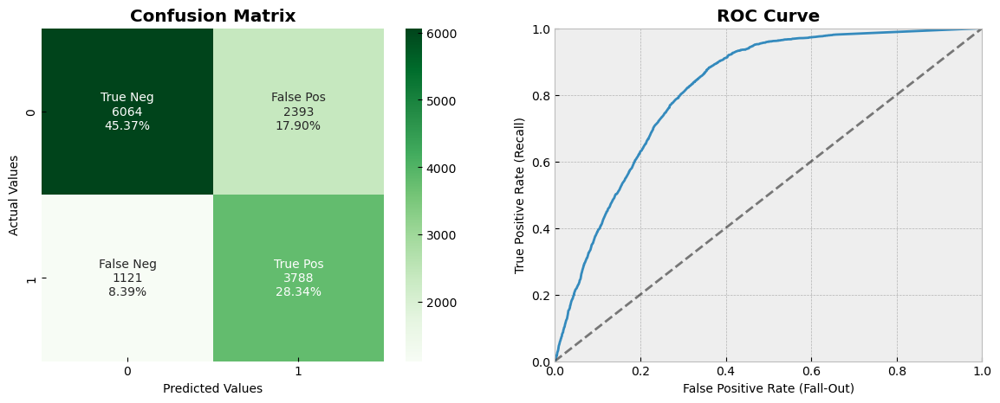

In [128]:
# Calculate the confusion matrix
conf_mx = confusion_matrix(y_val, best_dtr.predict(X_val_sc_rfe))

# Get the scores of all instances in the validation set.
y_scores = cross_val_predict(best_dtr, X_val_sc_rfe, y_val, cv=cv,
                             method='predict_proba')[:,1]
# Calculate the fpr and tpr
fpr,tpr, thresholds = roc_curve(y_val, y_scores)

# Plot the confusion matrix and the ROC curve.
plt.figure(figsize=(14,5))

plt.subplot(121)
plot_confusion_matrix(conf_mx, cmap='Greens')
plt.title('Confusion Matrix')

plt.subplot(122)
plot_roc_curve(fpr, tpr)

In [129]:
roc_auc_score(y_val, best_dtr.predict(X_val_sc_rfe))

0.7443415292532439

#### __Precision/Recall Curves__

Recall 0.77
Precision 0.623


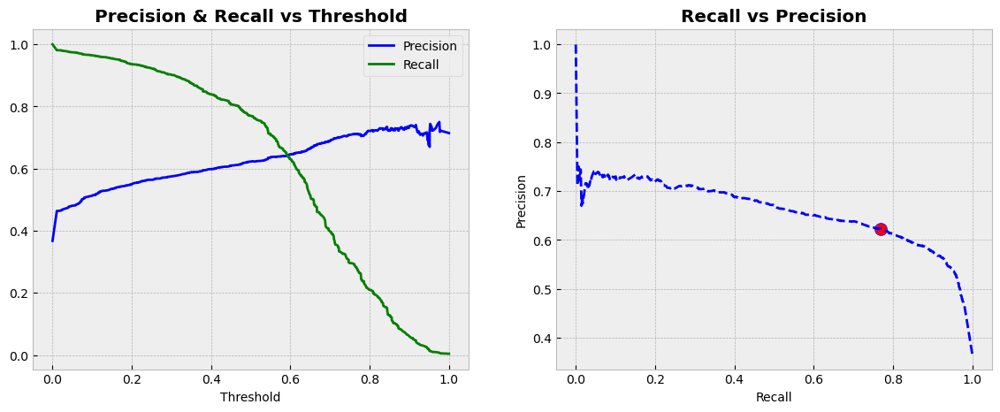

In [130]:
# Calculate precisions, recalls.
precisions, recalls, thresholds = precision_recall_curve(y_val, y_scores)

# Get the recall and precision of a model.
val_recall = cross_val_score(best_dtr, X_val_sc_rfe, y_val, scoring='recall', cv=cv).mean()
val_prec = cross_val_score(best_dtr, X_val_sc_rfe, y_val, scoring='precision', cv=cv).mean()
print('Recall {}'.format(val_recall.round(3)))
print('Precision {}'.format(val_prec.round(3)))

# Plot the curves
plt.figure(figsize=(14,5))
plt.subplot(121)
plot_precision_recall_vs_threshold(precisions, recalls, thresholds)

plt.subplot(122)
plot_precision_vs_recall(precisions, recalls)
plt.scatter([val_recall], [val_prec], c='r', s=100, edgecolor='b');

So we got quite a high recall (not that high compared to previous models), and the only concern left is how how can we improve the accuracy of the model. Let's take another approach to increasing the accuracy on the validation set, very special to the decision trees.

#### __Pruning CART to Optimise the Performance__

Cost Complexity Pruning is a technique usually used to prevent overfitting in decision trees. We can use it by passing a cost complexity parameter `ccp_alpha` to the decision tree algorithm, which penalizes the model for having too many splits in the tree. 

The pruning process can improve the generalization performance of the model by removing nodes that do not contribute much to the classification performance or irrelevant features in the data, which can reduce the risk of overfitting and simplifies the tree.

In [131]:
# Get the effective alphas and the corresponding total leaf impurities.
path = best_dtr.cost_complexity_pruning_path(X_train_sc_rfe, y_train)
ccp_alphas, impurities = path.ccp_alphas, path.impurities

# Get the parameters of the tuned forest.
best_params = best_dtr.get_params()
del best_params['ccp_alpha'] # delete the default value for the param to be able to pass a new one.

# Train DTRs with different alphas.
dtrs_with_ccp =[]
for ccp_alpha in ccp_alphas:
    clf = DecisionTreeClassifier(**best_params, ccp_alpha=ccp_alpha).fit(X_train_sc_rfe, y_train)
    dtrs_with_ccp.append(clf)

In [132]:
# Remove the last element, because it's the trivial tree with only one node.
dtrs_with_ccp = dtrs_with_ccp[:-1]
ccp_alphas = ccp_alphas[:-1]

# Calculate the number of nodes and tree depth at each step.
node_counts = [dtr.tree_.node_count for dtr in dtrs_with_ccp]
depths = [dtr.tree_.max_depth for dtr in dtrs_with_ccp]

# Calculate the scores for each dtr with alpha.
train_scores = [cross_val_score(dtr, X_train_sc_rfe, y_train, cv=cv,
                 scoring='accuracy').mean().round(4) for dtr in dtrs_with_ccp]
val_scores = [cross_val_score(dtr, X_val_sc_rfe, y_val, cv=cv,
              scoring='accuracy').mean().round(4) for dtr in dtrs_with_ccp]

(0.0, 0.0015)

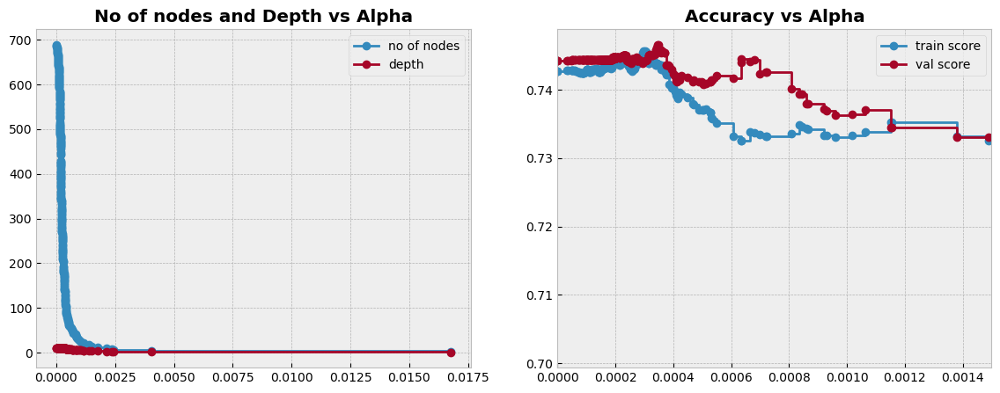

In [133]:
plt.figure(figsize=(14,5))
plt.subplot(121)
plt.plot(ccp_alphas, node_counts,'o-', drawstyle='steps-post', label='no of nodes')
plt.plot(ccp_alphas, depths,'o-', drawstyle='steps-post', label='depth')
plt.title("No of nodes and Depth vs Alpha")
plt.legend()

plt.subplot(122)
plt.plot(ccp_alphas, train_scores, 'o-', label='train score', drawstyle="steps-post")
plt.plot(ccp_alphas, val_scores, 'o-', label='val score', drawstyle="steps-post")
plt.legend()
plt.title('Accuracy vs Alpha')
plt.xlim([0, 0.0015])

In [134]:
train_scores[np.argmax(val_scores)], val_scores[np.argmax(val_scores)]

(0.7437, 0.7466)

In [135]:
best_alpha = ccp_alphas[np.argmax(val_scores)]
best_alpha

0.0003470793127762703

In [136]:
# Prune the tree.
prunned_dtr = DecisionTreeClassifier(**best_params, ccp_alpha=best_alpha)
prunned_dtr.fit(X_train_sc_rfe, y_train)

DecisionTreeClassifier(ccp_alpha=0.0003470793127762703,
                       class_weight={0: 0.45, 1: 0.55}, criterion='entropy',
                       max_depth=10, min_samples_leaf=30, random_state=19)

In [137]:
# Double check the scores.
tr_acc = cross_val_score(prunned_dtr, X_train_sc_rfe, y_train, cv=cv,
                         scoring='accuracy').mean().round(4)
val_acc = cross_val_score(prunned_dtr, X_val_sc_rfe, y_val, cv=cv,
                          scoring='accuracy').mean().round(4)  

print("Train accuracy: {}\nValid accuracy: {}".format(tr_acc, val_acc))

Train accuracy: 0.7437
Valid accuracy: 0.7466


Text(0.5, 1.0, 'Confusion Matrix (RFE+Tune+Prune)')

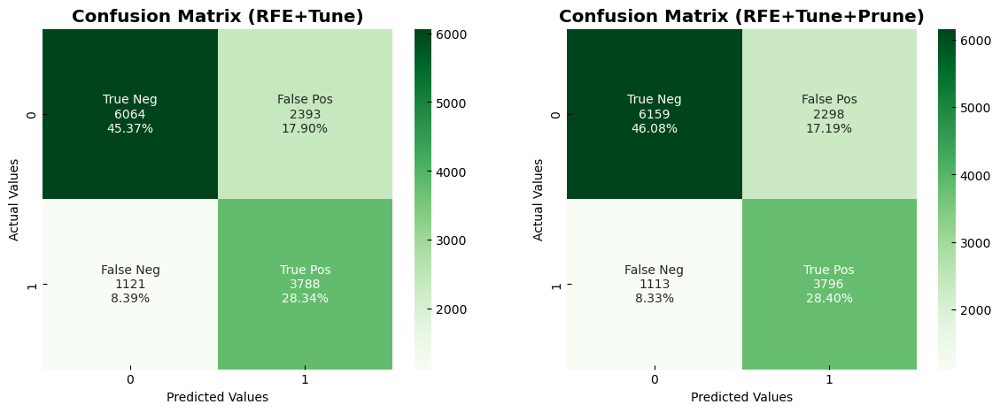

In [138]:
# Compare CART predictions before and after prunning.
plt.figure(figsize=(14,5))
plt.subplot(121)
conf_mx = confusion_matrix(y_val, best_dtr.predict(X_val_sc_rfe))
plot_confusion_matrix(conf_mx, cmap='Greens')
plt.title('Confusion Matrix (RFE+Tune)')

plt.subplot(122)
conf_mx = confusion_matrix(y_val, prunned_dtr.predict(X_val_sc_rfe))
plot_confusion_matrix(conf_mx, cmap='Greens')
plt.title('Confusion Matrix (RFE+Tune+Prune)')

We see that even though we've gone thorough all that trouble with prunning the CART, but haven't managed to improve the accuracy a lot. Obviously, the prunned CART is much better than just tunned CART, because it gives us much higher recall, but it seems that generally CART alone is not the model suited for our data.

#### __Test Results__

In [139]:
cross_val_score(prunned_dtr, X_test_sc_rfe, y_test, cv=cv, scoring='accuracy').mean().round(4)

0.7352

In [140]:
test_results = test_results.append({
    'Model':'CART', 
    'Accuracy': cross_val_score(prunned_dtr, X_test_sc_rfe, y_test, cv=cv, 
                                scoring='accuracy').mean().round(4)*100,
    'Recall': cross_val_score(prunned_dtr, X_test_sc_rfe, y_test, cv=cv, 
                              scoring='recall').mean().round(3),
    'Precision': cross_val_score(prunned_dtr, X_test_sc_rfe, y_test, cv=cv, 
                                 scoring='precision').mean().round(3),
    'ROC AUC': roc_auc_score(y_test, prunned_dtr.predict(X_test_sc_rfe)).round(3)
}, ignore_index=True)
test_results

,Model,Accuracy,Recall,Precision,ROC AUC
0,Logistic Regression,74.53,0.714,0.637,0.739
1,SGD,74.65,0.767,0.628,0.748
2,KNN,76.56,0.741,0.661,0.794
3,CART,73.52,0.725,0.619,0.747


<a id="ada"></a>
# 6.5. AdaBoost Classifier

AdaBoost (Adaptive Bossting) is a machine learning algorithm that combines multiple "weak" learners to create a single "strong" learner. In each iteration, it trains a new 'weak' learner on a weighted version of the training data, where the weights are adjusted such a way so that the relative weights of misclassified training instances are increased. That leads to the new predictor paying a bit more attention to the training instances that the predecessor underfitted. The final prediction is a weighted combination of the predictions from each weak learner.

Hyperparameters: `n_estimators`, `learning_rate`, `max_depth`.

#### __Exploring Hyperparameters__

In [141]:
# Generate AdaBoost models with different number of estimators and check their performance.
models = dict()
n_trees = [10,50,100,500,1000]

for n in n_trees:
    models[str(n)] = AdaBoostClassifier(n_estimators=n, random_state=SEED).fit(X_train_sc, y_train)
    
# Evaluate the models on the validation set.
results = evaluate_models(X_train_sc, y_train, X_val_sc, y_val, models)
plot_boxplot_summary(results, color=None, xlabel='n_estimators', 
            ylabel='Accuracy', title='Exploring n_estimators (AdaBoost)')

>> 10: 0.7462 (+/- 0.0080)
>> 50: 0.7554 (+/- 0.0106)
>> 100: 0.7561 (+/- 0.0128)
>> 500: 0.7518 (+/- 0.0091)
>> 1000: 0.7504 (+/- 0.0086)


We see here that the accuracy increases up to 50 estimators, but after that, it decreases. Possibly the number of estimators greater than 50 may lead to overfitting the training data, and we'd like to avoid that.

In [142]:
# Generate AdaBoost models with different values for max_depth parameter.
models = dict()
depths = np.arange(1,11,1)

for d in depths:
    base_estimator = DecisionTreeClassifier(max_depth=d)
    models[str(d)] = AdaBoostClassifier(base_estimator=base_estimator, 
                                        random_state=SEED).fit(X_train_sc, y_train)

# Evaluate the models on the validation set.
results = evaluate_models(X_train_sc, y_train, X_val_sc, y_val, models)
plot_boxplot_summary(results, color=None, xlabel='max_depth', 
                    ylabel='Accuracy', title='Exploring max_depth (AdaBoost)')

>> 1: 0.7554 (+/- 0.0106)
>> 2: 0.7536 (+/- 0.0078)
>> 3: 0.7455 (+/- 0.0111)
>> 4: 0.7320 (+/- 0.0111)
>> 5: 0.7305 (+/- 0.0127)
>> 6: 0.7214 (+/- 0.0135)
>> 7: 0.7206 (+/- 0.0114)
>> 8: 0.7218 (+/- 0.0125)
>> 9: 0.7317 (+/- 0.0065)
>> 10: 0.7339 (+/- 0.0123)


We observe that the highest accuracy gives us the`max_depth=1`, then the acuuracy starts gradually decreasing and after `max_depth=7` it starts increasing again, most likely indicating that the model overfits the data.

In [143]:
# Generate AdaBoost models with different learning rates.
lrs = [1e-4, 1e-3, 1e-2, 0.1, 0.5, 1., 1.2, 1.4, 1.6, ]
models = dict()

for lr in lrs:
    models[str(lr)] = AdaBoostClassifier(learning_rate=lr, 
                                         random_state=SEED).fit(X_train_sc, y_train)

# Evaluate models on the validation set.
results = evaluate_models(X_train_sc, y_train, X_val_sc, y_val, models)
plot_boxplot_summary(results, color=None, xlabel='learning_rate', 
                ylabel='Accuracy', title='Exploring learning_rate (AdaBoost)')

>> 0.0001: 0.7016 (+/- 0.0112)
>> 0.001: 0.7016 (+/- 0.0112)
>> 0.01: 0.7016 (+/- 0.0112)
>> 0.1: 0.7425 (+/- 0.0086)
>> 0.5: 0.7552 (+/- 0.0118)
>> 1.0: 0.7554 (+/- 0.0106)
>> 1.2: 0.7544 (+/- 0.0069)
>> 1.4: 0.7530 (+/- 0.0092)
>> 1.6: 0.7503 (+/- 0.0116)


The plot suggests that the best value of `learning_rate` should be around 1.0 or 1.5, because it gives us the best accuracy.

#### __Fine-Tuning AdaBoost__

In [144]:
ada_clf = AdaBoostClassifier(base_estimator=DecisionTreeClassifier(max_depth=1), random_state=SEED,)

param_grid = {
    'n_estimators':[100, 120],
    'learning_rate':[0.5, 1., 1.2, 1.4, 1.6,]
}

# Tune the model.
tuning_ada = GridSearchCV(ada_clf, param_grid, cv=cv, scoring='accuracy', 
                          n_jobs=-1, return_train_score=True)
tuning_ada.fit(X_train_sc, y_train)

GridSearchCV(cv=StratifiedKFold(n_splits=10, random_state=19, shuffle=True),
             estimator=AdaBoostClassifier(base_estimator=DecisionTreeClassifier(max_depth=1),
                                          random_state=19),
             n_jobs=-1,
             param_grid={'learning_rate': [0.5, 1.0, 1.2, 1.4, 1.6],
                         'n_estimators': [100, 120]},
             return_train_score=True, scoring='accuracy')

In [145]:
best_ada =tuning_ada.best_estimator_
best_ada

AdaBoostClassifier(base_estimator=DecisionTreeClassifier(max_depth=1),
                   learning_rate=0.5, n_estimators=120, random_state=19)

In [146]:
tr_acc = cross_val_score(best_ada, X_train_sc, y_train, cv=cv,
                         scoring='accuracy').mean().round(4)
val_acc = cross_val_score(best_ada, X_val_sc, y_val, cv=cv,
                          scoring='accuracy').mean().round(4)

print("Train accuracy: {}\nValid accuracy: {}".format(tr_acc, val_acc))

Train accuracy: 0.7605
Valid accuracy: 0.758


The model doesn't show us any particular improvement here, because it doesn't actually differ from the baseline one (75.54% accuracy).

#### __Learning Curves__

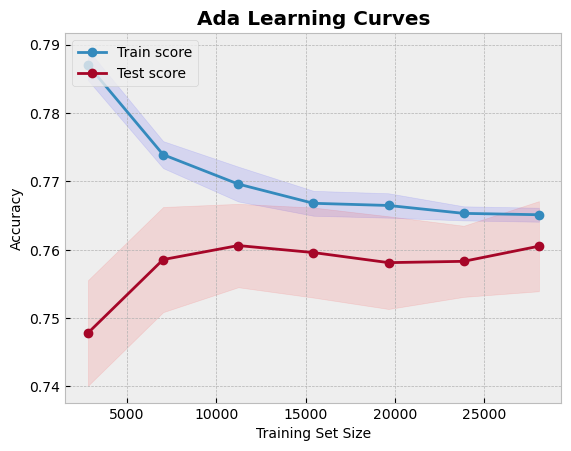

In [147]:
plot_learning_curves(best_ada, X_train_sc, y_train, cv=cv, 
                     title='Ada Learning Curves', train_sizes=np.linspace(0.1,1.,7))

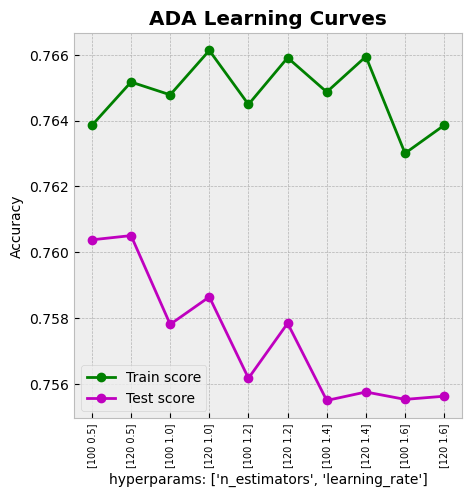

In [148]:
cv_res = pd.DataFrame(tuning_ada.cv_results_)

plt.figure(figsize=(5,5))
plot_scores_vs_params(cv_res, param_names=['n_estimators', 'learning_rate'], 
                      title='ADA Learning Curves')

#### __Confusion Matrix and the ROC Curve__

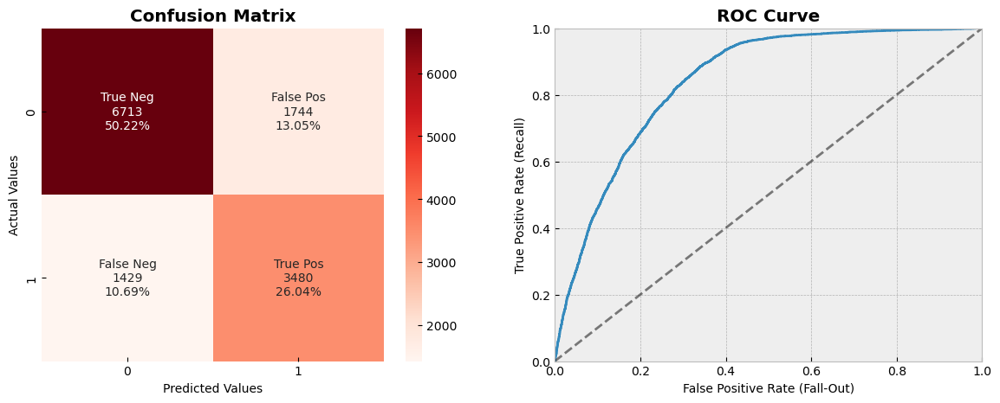

In [149]:
# Calculate the confusion matrix
conf_mx = confusion_matrix(y_val, best_ada.predict(X_val_sc))

# Get the scores of all instances in the validation set.
y_scores = cross_val_predict(best_ada, X_val_sc, y_val, cv=cv,
                             method='predict_proba')[:,1]
# Calculate the fpr and tpr
fpr,tpr, thresholds = roc_curve(y_val, y_scores)

# Plot the confusion matrix and the ROC curve.
plt.figure(figsize=(14,5))

plt.subplot(121)
plot_confusion_matrix(conf_mx, cmap='Reds')
plt.title('Confusion Matrix')

plt.subplot(122)
plot_roc_curve(fpr, tpr)

In [150]:
roc_auc_score(y_val, best_ada.predict(X_val_sc))

0.751341158523462

#### __Precision/Recall Curves__

Recall 0.714
Precision 0.657


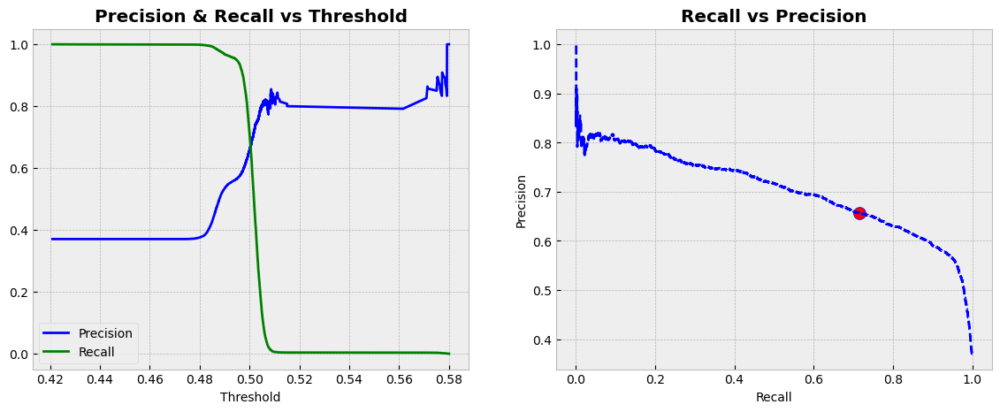

In [151]:
# Calculate precisions, recalls.
precisions, recalls, thresholds = precision_recall_curve(y_val, y_scores)

# Get the recall and precision of a model.
val_recall = cross_val_score(best_ada, X_val_sc, y_val, scoring='recall', cv=cv).mean()
val_prec = cross_val_score(best_ada, X_val_sc, y_val, scoring='precision', cv=cv).mean()
print('Recall {}'.format(val_recall.round(3)))
print('Precision {}'.format(val_prec.round(3)))

# Plot the curves
plt.figure(figsize=(14,5))
plt.subplot(121)
plot_precision_recall_vs_threshold(precisions, recalls, thresholds)

plt.subplot(122)
plot_precision_vs_recall(precisions, recalls)
plt.scatter([val_recall], [val_prec], c='r', s=100, edgecolor='b');

In [152]:
print(classification_report(y_val, best_ada.predict(X_val_sc),))

              precision    recall  f1-score   support

           0       0.82      0.79      0.81      8457
           1       0.67      0.71      0.69      4909

    accuracy                           0.76     13366
   macro avg       0.75      0.75      0.75     13366
weighted avg       0.77      0.76      0.76     13366



Well, the number of False Neg and the number False Pos are almost the same. We've got a high recall (though we could do better), but even feature selection doesn't help the model in increasing the accuracy of its predictions, so we'll leave the model as it is.

#### __Test Results__

In [153]:
cross_val_score(best_ada, X_test_sc, y_test, cv=cv, scoring='accuracy').mean().round(4)

0.7543

In [154]:
test_results = test_results.append({
    'Model':'AdaBoost', 
    'Accuracy': cross_val_score(best_ada, X_test_sc, y_test, cv=cv, 
                                scoring='accuracy').mean().round(4)*100,
    'Recall': cross_val_score(best_ada, X_test_sc, y_test, cv=cv, 
                              scoring='recall').mean().round(3),
    'Precision': cross_val_score(best_ada, X_test_sc, y_test, cv=cv, 
                                 scoring='precision').mean().round(3),
    'ROC AUC': roc_auc_score(y_test, best_ada.predict(X_test_sc)).round(3)
}, ignore_index=True)
test_results

,Model,Accuracy,Recall,Precision,ROC AUC
0,Logistic Regression,74.53,0.714,0.637,0.739
1,SGD,74.65,0.767,0.628,0.748
2,KNN,76.56,0.741,0.661,0.794
3,CART,73.52,0.725,0.619,0.747
4,AdaBoost,75.43,0.708,0.653,0.753


<a id="rf"></a>
# 6.6. Random Forest

A Random Forest is an ensemble of Decision Trees, generally trained via the bagging method. The Random Forest introduces extra randomness when growing trees, and this results in a greater tree diversity (high bias, but low variance), generally yielding an overall better model. 

With bagging, some instances may be sampled severaltimes for any given estimator, while others may not be sampled at all. That means that if we pass `bootstrap=True` to the RF, then only about 63% of the training instances will be sampled on average for each predictor. The remaining 37% are called _out-of_bag_ (oob) instances (they are not the same 37% for all predictors). Since the predictor never sees these instances during training, it can be evaluated on them like on the validation set. The RF can be evaluated by averaging out the oob scores of each predictor. 

One way to use OOB instances for tuning Random Forest is to compute the OOB error rate for different combinations of hyperparameters (e.g., number of trees, maximum depth, etc.). Then, the hyperparameters that lead to the lowest OOB error rate can be selected for further analysis, and that's exactly what we'll do.

Hyperparameters: `n_estimators`, `max_depth`, `min_samples_split`, `min_samples_leaf`, `max_features`.

In [155]:
forest_clf = RandomForestClassifier(random_state=SEED,)

#### __Exploring the Hyperparameters__

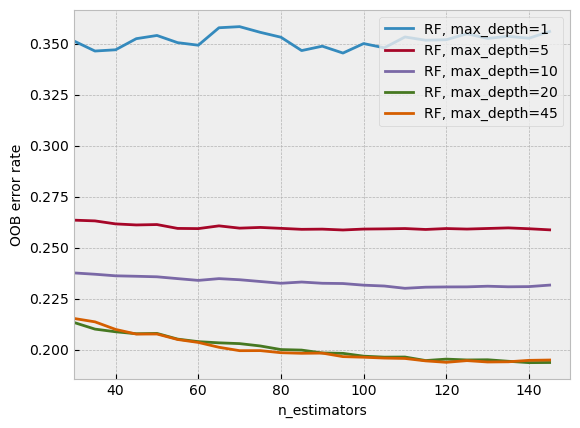

In [156]:
# Plot how the oob scores of the classifiers change as the number of estimators grows.
# Random Forests with different maximum depths.
ensemble_clfs = [
    ('RF, max_depth=1', RandomForestClassifier(warm_start=True, oob_score=True,
                                               random_state=SEED, max_depth=1)),
    ('RF, max_depth=5', RandomForestClassifier(warm_start=True, oob_score=True,
                                               random_state=SEED, max_depth=5)),
    ('RF, max_depth=10', RandomForestClassifier(warm_start=True, oob_score=True,
                                               random_state=SEED, max_depth=10)),
    ('RF, max_depth=20', RandomForestClassifier(warm_start=True, oob_score=True,
                                               random_state=SEED, max_depth=20)),
    ('RF, max_depth=45', RandomForestClassifier(warm_start=True, oob_score=True,
                                               random_state=SEED, max_depth=45)),
]

plot_oob_error_rate(ensemble_clfs, X_train_sc, y_train)

As we can see, the `max_depth` greater than 20 is most likely overfitting the data and can't generalize well, because whether we increase the `max_depth` value or not doesn't seem to affect the OOB error rate. The `max_depth=1` gives us a high error rate, so let's assume that the perfect range for the hyperparameter will be from 7 to 15.

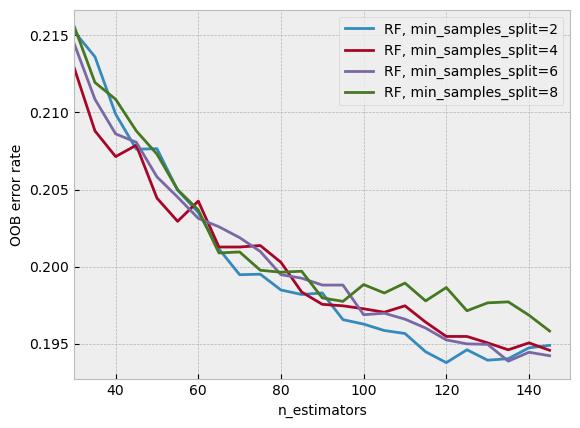

In [157]:
# Plot how the oob scores of the classifiers change as the number of estimators grows.
# Random Forests with different min_samples_split values.
ensemble_clfs = [
    ('RF, min_samples_split=2', RandomForestClassifier(warm_start=True, oob_score=True,
                                               random_state=SEED, min_samples_split=2)),
    ('RF, min_samples_split=4', RandomForestClassifier(warm_start=True, oob_score=True,
                                               random_state=SEED, min_samples_split=4)),
    ('RF, min_samples_split=6', RandomForestClassifier(warm_start=True, oob_score=True,
                                               random_state=SEED, min_samples_split=6)),
    ('RF, min_samples_split=8', RandomForestClassifier(warm_start=True, oob_score=True,
                                               random_state=SEED, min_samples_split=8)),
]
plot_oob_error_rate(ensemble_clfs, X_train_sc, y_train)

Generally, each RF seems to be similar to the other ones, and they follow roughly the same error rate pattern, but to avoid overfitting, we'd choose the values to be from 2 to 4.

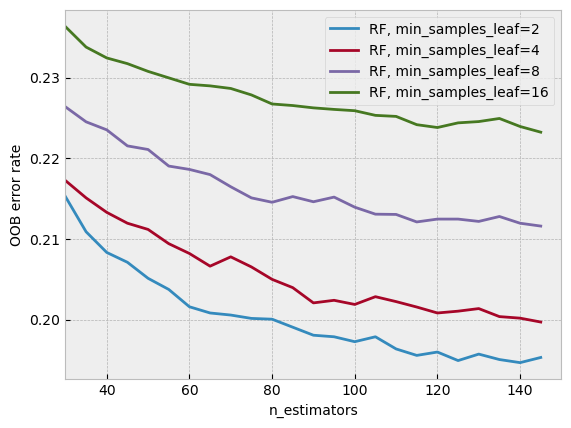

In [158]:
# Plot how the oob scores of the classifiers change as the number of estimators grows.
# Random Forests with different min_samples_split values.
ensemble_clfs = [
    ('RF, min_samples_leaf=2', RandomForestClassifier(warm_start=True, oob_score=True,
                                               random_state=SEED, min_samples_leaf=2)),
    ('RF, min_samples_leaf=4', RandomForestClassifier(warm_start=True, oob_score=True,
                                               random_state=SEED, min_samples_leaf=4)),
    ('RF, min_samples_leaf=8', RandomForestClassifier(warm_start=True, oob_score=True,
                                               random_state=SEED, min_samples_leaf=8)),
    ('RF, min_samples_leaf=16', RandomForestClassifier(warm_start=True, oob_score=True,
                                               random_state=SEED, min_samples_leaf=16)),
]
plot_oob_error_rate(ensemble_clfs, X_train_sc, y_train)

The higher the value for the `min_samples_leaf` is, the harder it is for a classifier to generalize when seeing unknown data, so let's choose 2-5.

In [159]:
# Plot the accuracies of the Random Forests with different n_estimators values.
n_trees = [10,50,100,300,500,1000]
models = dict()

for n in n_trees:
    models[str(n)] = RandomForestClassifier(n_estimators=n, random_state=SEED)
    
results = evaluate_models(X_train_sc, y_train, X_val_sc, y_val, models)
plot_boxplot_summary(results, color=None, xlabel='n_estimators', 
            ylabel='Accuracy', title='Exploring n_estimators (RF)')

>> 10: 0.7387 (+/- 0.0089)
>> 50: 0.7631 (+/- 0.0092)
>> 100: 0.7708 (+/- 0.0057)
>> 300: 0.7732 (+/- 0.0069)
>> 500: 0.7736 (+/- 0.0063)
>> 1000: 0.7764 (+/- 0.0094)


As expected, the greater the number of estimators is the more accurate results we get. Generally, in this notebook we won't be using any insane numbers, and will settle for 200 in this case.

#### __Fine-Tuning__

In [160]:
param_grid={
    'max_depth':[7,10,15,20],
    'min_samples_split':[2,4],
    'min_samples_leaf':[2,4],
}

# Tune the model.
tuning_forest = GridSearchCV(forest_clf, param_grid, scoring='accuracy', n_jobs=-1,
                             verbose=1, cv=cv, return_train_score=True,)
tuning_forest.fit(X_train_sc, y_train)

Fitting 10 folds for each of 16 candidates, totalling 160 fits


GridSearchCV(cv=StratifiedKFold(n_splits=10, random_state=19, shuffle=True),
             estimator=RandomForestClassifier(random_state=19), n_jobs=-1,
             param_grid={'max_depth': [7, 10, 15, 20],
                         'min_samples_leaf': [2, 4],
                         'min_samples_split': [2, 4]},
             return_train_score=True, scoring='accuracy', verbose=1)

In [161]:
best_forest = tuning_forest.best_estimator_

# Manually set the number of estimators.
best_forest.n_estimators = 200
best_forest.fit(X_train_sc, y_train)    

RandomForestClassifier(max_depth=20, min_samples_leaf=2, n_estimators=200,
                       random_state=19)

In [162]:
tr_acc = cross_val_score(best_forest, X_train_sc, y_train, cv=cv,
                         scoring='accuracy').mean().round(4)
val_acc = cross_val_score(best_forest, X_val_sc, y_val, cv=cv,
                          scoring='accuracy').mean().round(4)

print("Train accuracy: {}\nValid accuracy: {}".format(tr_acc, val_acc))

Train accuracy: 0.8041
Valid accuracy: 0.7765


We see that the accuracy for a fine-tuned forest is only a tiny bit higher, compared to the baseline results (77.02%).

####  __Learning Curves__

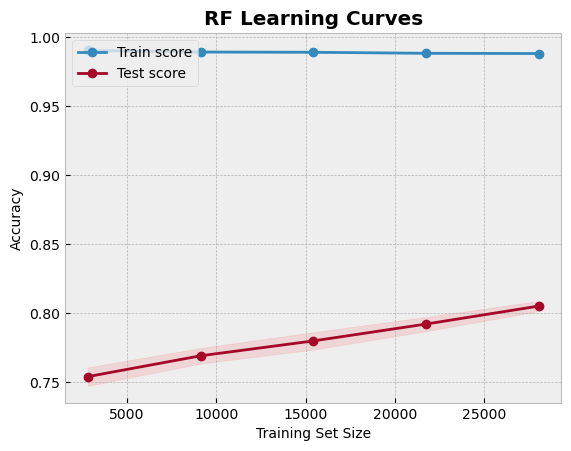

In [163]:
plot_learning_curves(best_forest, X_train_sc, y_train, cv=cv, 
                     title='RF Learning Curves', train_sizes=np.linspace(0.1,1.,5))

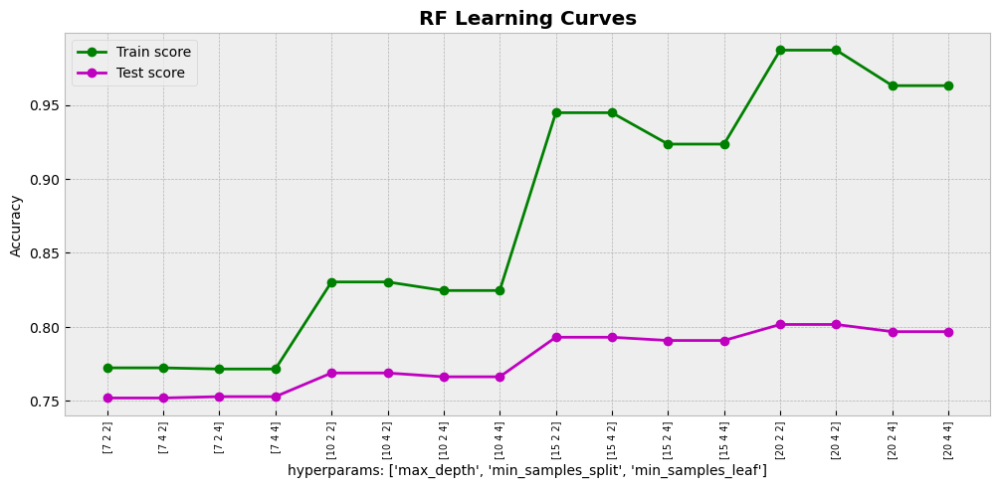

In [164]:
cv_res = pd.DataFrame(tuning_forest.cv_results_)

plt.figure(figsize=(12,5))
plot_scores_vs_params(cv_res, param_names=['max_depth', 'min_samples_split',
                                           'min_samples_leaf',], 
                      title='RF Learning Curves')

#### __Confusion Matrix and the ROC Curve__

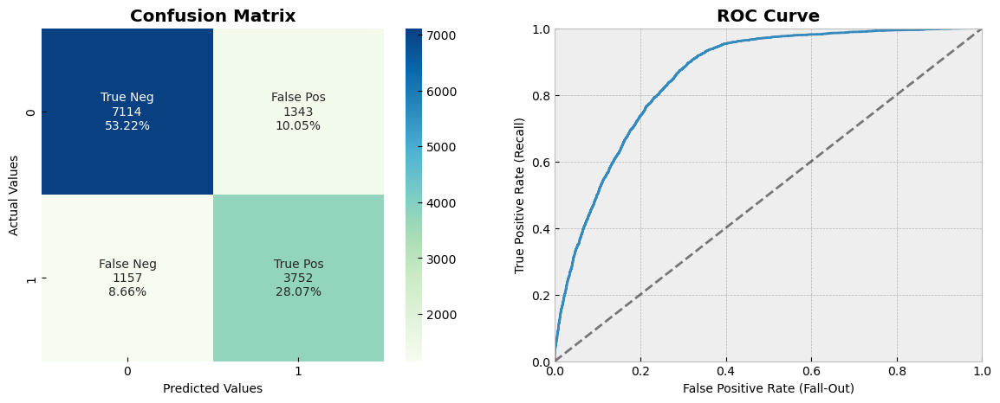

In [165]:
# Calculate the confusion matrix
conf_mx = confusion_matrix(y_val, best_forest.predict(X_val_sc))

# Get the scores of all instances in the validation set.
y_scores = cross_val_predict(best_forest, X_val_sc, y_val, cv=cv,
                             method='predict_proba')[:,1]
# Calculate the fpr and tpr
fpr,tpr, thresholds = roc_curve(y_val, y_scores)

# Plot the confusion matrix and the ROC curve.
plt.figure(figsize=(14,5))

plt.subplot(121)
plot_confusion_matrix(conf_mx, cmap='GnBu')
plt.title('Confusion Matrix')

plt.subplot(122)
plot_roc_curve(fpr, tpr)

In [166]:
roc_auc_score(y_val, best_forest.predict(X_val_sc))

0.8027535460143442

#### __Precision/Recall Curves__

Recall 0.733
Precision 0.682


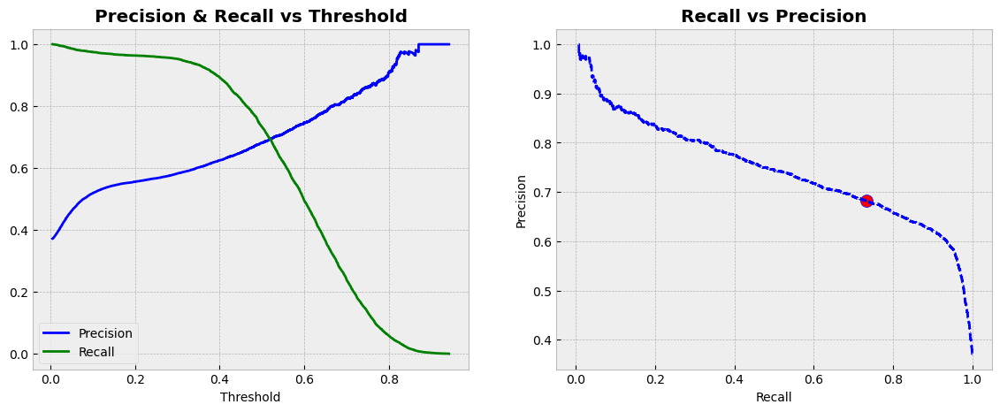

In [167]:
# Calculate precisions, recalls for each threshold.
precisions, recalls, thresholds = precision_recall_curve(y_val, y_scores)

# Get the recall and precision of a model.
val_recall = cross_val_score(best_forest, X_val_sc, y_val, scoring='recall', cv=cv).mean()
val_prec = cross_val_score(best_forest, X_val_sc, y_val, scoring='precision', cv=cv).mean()
print('Recall {}'.format(val_recall.round(3)))
print('Precision {}'.format(val_prec.round(3)))

# Plot the curves
plt.figure(figsize=(14,5))
plt.subplot(121)
plot_precision_recall_vs_threshold(precisions, recalls, thresholds)

plt.subplot(122)
plot_precision_vs_recall(precisions, recalls)
plt.scatter([val_recall], [val_prec], c='r', s=100, edgecolor='b');

In [168]:
print(classification_report(y_val, best_forest.predict(X_val),))

              precision    recall  f1-score   support

           0       0.63      1.00      0.78      8457
           1       0.00      0.00      0.00      4909

    accuracy                           0.63     13366
   macro avg       0.32      0.50      0.39     13366
weighted avg       0.40      0.63      0.49     13366



It seems like we have a sufficiently high recall and precision, also the Fall-Out is quite low, therefore we'd rather focus on reaching the higher accuracy for the time being.

#### __Recursive Feature Elimination (RFE)__

We'll experiment with both different numbers of features and various base estimators for RFE to determine the optimal parameters to use.

__Exploring the Number of Features__

In [169]:
# Generate models with different number of features and with CART for a base estimator.
models=dict()
for i in range(8,25):
    rfe = RFE(estimator=DecisionTreeClassifier(random_state=SEED), n_features_to_select=i)
    models[str(i)] = Pipeline(steps=[('feat_select',rfe), ('model',best_forest)])
    
# evaluate the models on the validation set.
results = evaluate_models(X_train_sc, y_train, X_val_sc, y_val, models)
plot_boxplot_summary(results, color=None, xlabel='features selected', 
            ylabel='Accuracy', title='Exploring n_features_to_select (RFE for RF)')

>> 8: 0.7609 (+/- 0.0087)
>> 9: 0.7629 (+/- 0.0079)
>> 10: 0.7666 (+/- 0.0083)
>> 11: 0.7685 (+/- 0.0081)
>> 12: 0.7661 (+/- 0.0093)
>> 13: 0.7704 (+/- 0.0063)
>> 14: 0.7706 (+/- 0.0088)
>> 15: 0.7732 (+/- 0.0074)
>> 16: 0.7750 (+/- 0.0080)
>> 17: 0.7735 (+/- 0.0092)
>> 18: 0.7750 (+/- 0.0078)
>> 19: 0.7748 (+/- 0.0063)
>> 20: 0.7783 (+/- 0.0102)
>> 21: 0.7764 (+/- 0.0075)
>> 22: 0.7763 (+/- 0.0087)
>> 23: 0.7785 (+/- 0.0084)
>> 24: 0.7765 (+/- 0.0089)


__Exploring the Base Estimator with a Given Number of Selected Features__

In [170]:
# Generate models with specified number of features and different base estimators.
models=dict()
base_estimators = [('lr',LogisticRegression(random_state=SEED)), 
                   ('per', Perceptron(random_state=SEED)), 
                   ('cart', DecisionTreeClassifier(random_state=SEED)), 
                   ('rf',RandomForestClassifier(random_state=SEED)), 
                   ('gbm',GradientBoostingClassifier(random_state=SEED))]

for name, base in base_estimators:
    rfe = RFE(estimator=base, n_features_to_select=20)
    models[name] = Pipeline(steps=[('feat_select',rfe), ('model',best_forest)])

results = evaluate_models(X_train_sc, y_train, X_val_sc, y_val, models)
plot_boxplot_summary(results, color=None, xlabel='base estimator', 
            ylabel='Accuracy', title='Exploring base_estimator (RFE for RF)')

>> lr: 0.7709 (+/- 0.0104)
>> per: 0.7711 (+/- 0.0137)
>> cart: 0.7783 (+/- 0.0102)
>> rf: 0.7783 (+/- 0.0102)
>> gbm: 0.7770 (+/- 0.0086)


__Selecting Parameters and Transforming the Data__

In [171]:
# Reduce the dimensionality of the datasets.
rfe = RFE(estimator=DecisionTreeClassifier(), n_features_to_select=20).fit(X_train_sc, y_train)
X_train_sc_rfe, X_val_sc_rfe = rfe.transform(X_train_sc), rfe.transform(X_val_sc)
X_test_sc_rfe = rfe.transform(X_test_sc)

In [172]:
# Check the scores.
best_forest.fit(X_train_sc_rfe, y_train)
tr_acc = cross_val_score(best_forest, X_train_sc_rfe, y_train, cv=cv,
                         scoring='accuracy').mean().round(4)
val_acc = cross_val_score(best_forest, X_val_sc_rfe, y_val, cv=cv,
                          scoring='accuracy').mean().round(4)

print("Train accuracy: {}\nValid accuracy: {}".format(tr_acc, val_acc))

Train accuracy: 0.8014
Valid accuracy: 0.7783


Alright, we see that reducing the number of features the model was trained on actually helped increase the accuracy of the model on the validation set (even though the difference is not really noticeable). Let's now evaluate the model on the test set.

#### Test Results

In [173]:
cross_val_score(best_forest, X_test_sc_rfe, y_test, cv=cv, scoring='accuracy').mean().round(4)

0.7734

In [174]:
test_results = test_results.append({
    'Model':'Random Forest', 
    'Accuracy': cross_val_score(best_forest, X_test_sc_rfe, y_test, cv=cv, 
                                scoring='accuracy').mean().round(4)*100,
    'Recall': cross_val_score(best_forest, X_test_sc_rfe, y_test, cv=cv, 
                              scoring='recall').mean().round(3),
    'Precision': cross_val_score(best_forest, X_test_sc_rfe, y_test, cv=cv, 
                                 scoring='precision').mean().round(3),
    'ROC AUC': roc_auc_score(y_test, best_forest.predict(X_test_sc_rfe)).round(3)
}, ignore_index=True)
test_results

,Model,Accuracy,Recall,Precision,ROC AUC
0,Logistic Regression,74.53,0.714,0.637,0.739
1,SGD,74.65,0.767,0.628,0.748
2,KNN,76.56,0.741,0.661,0.794
3,CART,73.52,0.725,0.619,0.747
4,AdaBoost,75.43,0.708,0.653,0.753
5,Random Forest,77.34,0.732,0.677,0.794


<a id="et"></a>
# 6.7. Extra-Trees 

A forest of extremely random trees is called an Extremely Randomized Trees ensemble. The Extra-Trees are much faster to train than Random Forests, because the algorithm uses random thresholds for each feature considered for splitting at each node. We can't tell for sure whether this algorithm will perform better, so let's check it. We'll also make use of the oob instances when choosing the ranges of the hyperparameters to select for tuning, as we've done with Random Forest.

Hyperparameters: `n_estimators`, `max_depth`, `min_samples_split`, `min_samples_leaf`, `max_features`.

In [175]:
et_clf = ExtraTreesClassifier(random_state=SEED, )

#### __Recursive Feature Elimination (RFE)__

First of all, let's reduce the dimensionality of the dataset to keep only the most important features for the model.

__Exploring the Base Estimator with Automatically Selected Number of Features__

In [176]:
# Generate models with different base estimators.
base_estimators = [('lr',LogisticRegression(random_state=SEED)), 
                   ('per', Perceptron(random_state=SEED)), 
                   ('cart', DecisionTreeClassifier(random_state=SEED)), 
                   ('rf',RandomForestClassifier(random_state=SEED)), 
                   ('gbm',GradientBoostingClassifier(random_state=SEED))]


models=dict()
for name, base in base_estimators:
    rfe = RFECV(estimator=base)   # automatically select the number of features
    models[name] = Pipeline(steps=[('feat_select',rfe), ('model',et_clf)])
    
results = evaluate_models(X_train_sc, y_train, X_val_sc, y_val, models)
plot_boxplot_summary(results, color=None, xlabel='base estimators', 
            ylabel='Accuracy', title='Exploring estimator (RFE for ET)')

>> lr: 0.7545 (+/- 0.0094)
>> per: 0.7574 (+/- 0.0105)
>> cart: 0.7666 (+/- 0.0084)
>> rf: 0.7648 (+/- 0.0107)
>> gbm: 0.7717 (+/- 0.0110)


The `GradientBoostingClassifier` seems to perform better than any other, so we'll use it for RFE.

__Exploring the Number of Features__

In [177]:
# Generate models with different number of features and with GradientBoostingClassifier 
# for a base estimator.
models=dict()
for i in range(10,25):
    rfe = RFE(estimator=GradientBoostingClassifier(random_state=SEED), n_features_to_select=i)
    models[str(i)] = Pipeline(steps=[('feat_select',rfe), ('model',et_clf)])
    
# evaluate the models on the validation set.
results = evaluate_models(X_train_sc, y_train, X_val_sc, y_val, models)
plot_boxplot_summary(results, color=None, xlabel='features selected', 
            ylabel='Accuracy', title='Exploring n_features_to_select (RFE for ET)')

>> 10: 0.7672 (+/- 0.0105)
>> 11: 0.7670 (+/- 0.0089)
>> 12: 0.7666 (+/- 0.0081)
>> 13: 0.7702 (+/- 0.0091)
>> 14: 0.7702 (+/- 0.0087)
>> 15: 0.7704 (+/- 0.0093)
>> 16: 0.7670 (+/- 0.0115)
>> 17: 0.7717 (+/- 0.0115)
>> 18: 0.7688 (+/- 0.0111)
>> 19: 0.7693 (+/- 0.0124)
>> 20: 0.7717 (+/- 0.0150)
>> 21: 0.7677 (+/- 0.0078)
>> 22: 0.7687 (+/- 0.0108)
>> 23: 0.7679 (+/- 0.0065)
>> 24: 0.7653 (+/- 0.0083)


The values such as 17,19,20 seem to give us high accuracy, thus we'll use one of these.

__Exploring the Base Estimator with a Given Number of Selected Features__

In [178]:
# Generate models with specified number of features and different base estimators.
models=dict()

for name, base in base_estimators:
    rfe = RFE(estimator=base, n_features_to_select=20)
    models[name] = Pipeline(steps=[('feat_select',rfe), ('model',et_clf)])

results = evaluate_models(X_train_sc, y_train, X_val_sc, y_val, models)
plot_boxplot_summary(results, color=None, ylabel='Accuracy', xlabel='base_estimator')

>> lr: 0.7637 (+/- 0.0106)
>> per: 0.7612 (+/- 0.0171)
>> cart: 0.7699 (+/- 0.0087)
>> rf: 0.7699 (+/- 0.0087)
>> gbm: 0.7717 (+/- 0.0150)


Indeed, the `GradientBoostingClassifier` outperforms any other base estimator for `n_features_to_select=20`.

In [179]:
# Reduce the dimensionality of the data.
rfe = RFE(estimator=GradientBoostingClassifier(), n_features_to_select=20).fit(X_train_sc, y_train)
X_train_sc_rfe, X_val_sc_rfe = rfe.transform(X_train_sc), rfe.transform(X_val_sc)
X_test_sc_rfe = rfe.transform(X_test_sc)

et_clf.fit(X_train_sc_rfe, y_train)

ExtraTreesClassifier(random_state=19)

In [180]:
# Check the scores.
tr_acc = cross_val_score(et_clf, X_train_sc_rfe, y_train, cv=cv,scoring='accuracy').mean().round(4)
val_acc = cross_val_score(et_clf, X_val_sc_rfe, y_val, cv=cv,scoring='accuracy').mean().round(4)

print("Train accuracy: {}\nValid accuracy: {}".format(tr_acc, val_acc))

Train accuracy: 0.7994
Valid accuracy: 0.772


#### __Exploring the hyperparameters__

Now that we've done our best at choosing the right number of features in datasets and the right threshold for the `ExtraTreesClassifier`, we should take a quick look at the hyperparameters we'll be tuning and finally tune the model.

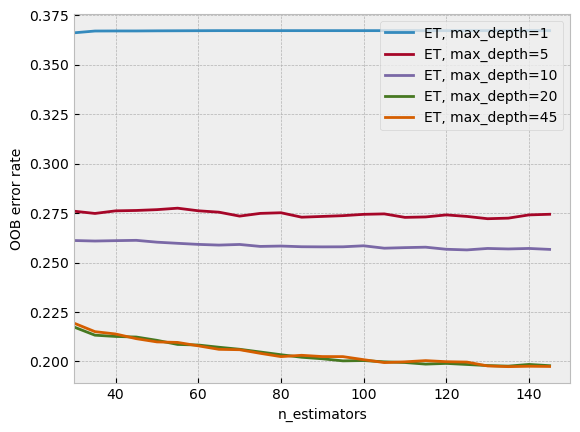

In [181]:
# Plot how the oob scores of the classifiers change as the number of estimators grows.
# ExtraTrees with different maximum depths.
ensemble_clfs = [
    ('ET, max_depth=1', ExtraTreesClassifier(warm_start=True, oob_score=True, bootstrap=True,
                                               random_state=SEED, max_depth=1)),
    ('ET, max_depth=5', ExtraTreesClassifier(warm_start=True, oob_score=True,bootstrap=True,
                                               random_state=SEED, max_depth=5)),
    ('ET, max_depth=10', ExtraTreesClassifier(warm_start=True, oob_score=True,bootstrap=True,
                                               random_state=SEED, max_depth=10)),
    ('ET, max_depth=20', ExtraTreesClassifier(warm_start=True, oob_score=True,bootstrap=True,
                                               random_state=SEED, max_depth=25)),
    ('ET, max_depth=45', ExtraTreesClassifier(warm_start=True, oob_score=True,bootstrap=True,
                                               random_state=SEED, max_depth=50)),
]

plot_oob_error_rate(ensemble_clfs, X_train_sc_rfe, y_train)

The last two values gives us a low OOB error rate, however, we should be careful when choosing the values from the range 20 to 40, as it may lead to overfitting.

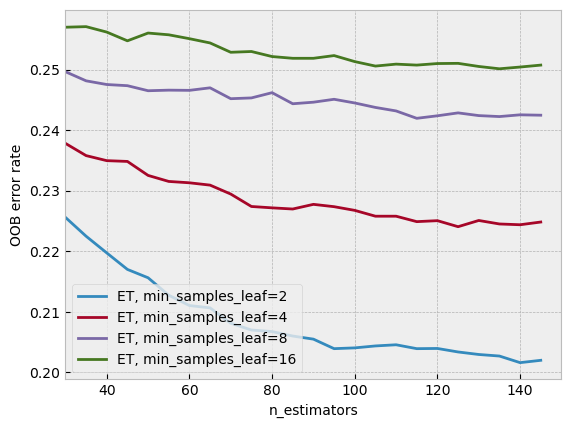

In [182]:
# Plot how the oob scores of the classifiers change as the number of estimators grows.
# ExtraTrees with different min_samples_leaf.
ensemble_clfs = [
    ('ET, min_samples_leaf=2', ExtraTreesClassifier(warm_start=True, oob_score=True,
                                    bootstrap=True,random_state=SEED, min_samples_leaf=2)),
    ('ET, min_samples_leaf=4', ExtraTreesClassifier(warm_start=True, oob_score=True,
                                    bootstrap=True,random_state=SEED, min_samples_leaf=4)),
    ('ET, min_samples_leaf=8', ExtraTreesClassifier(warm_start=True, oob_score=True,
                                    bootstrap=True,random_state=SEED, min_samples_leaf=8)),
    ('ET, min_samples_leaf=16', ExtraTreesClassifier(warm_start=True, oob_score=True,
                                    bootstrap=True,random_state=SEED, min_samples_leaf=16)),
]
plot_oob_error_rate(ensemble_clfs, X_train_sc_rfe, y_train)

The `min_samples_leaf=2` seems to perform much better than any other values.

#### __Fine-Tuning the Model__

In [183]:
et_clf = ExtraTreesClassifier(random_state=SEED, )

param_grid = {
    'max_depth':[20,30,40],
    'min_samples_split':[2,4],
    'min_samples_leaf':[2,4],
    'max_features':[10,15,20],
#     'n_estimators':[300],
}

tuning_et = GridSearchCV(et_clf, param_grid, cv=cv, n_jobs=-1, scoring='accuracy',
                         return_train_score=True)
tuning_et.fit(X_train_sc_rfe, y_train)

GridSearchCV(cv=StratifiedKFold(n_splits=10, random_state=19, shuffle=True),
             estimator=ExtraTreesClassifier(random_state=19), n_jobs=-1,
             param_grid={'max_depth': [20, 30, 40],
                         'max_features': [10, 15, 20],
                         'min_samples_leaf': [2, 4],
                         'min_samples_split': [2, 4]},
             return_train_score=True, scoring='accuracy')

In [184]:
best_et = tuning_et.best_estimator_
best_et

ExtraTreesClassifier(max_depth=40, max_features=20, min_samples_leaf=2,
                     random_state=19)

Let's see how the best ET so far will perform if we try to increase the `n_estimators` hyperparameter (We haven't specified this parameter in `param_grid` earlier and haven't let the `GridSearchCV` take care of it on its own due to computational and time complexity. Instead we'll tune it manually to prevent long computations).

In [185]:
# Generate ExtraTrees models with different n_estimators.
n_trees = [10,50,100,200,300,500]
models= dict()

for n in n_trees:
    model = ExtraTreesClassifier(**best_et.get_params())
    model.n_estimators = n
    models[str(n)] = model
    
results = evaluate_models(X_train_sc_rfe, y_train, X_val_sc_rfe, y_val, models)
plot_boxplot_summary(results, color=None, xlabel='n_estimators', 
                     ylabel='Accuracy', title='Exploring n_estimators (Best ET)')

>> 10: 0.7534 (+/- 0.0067)
>> 50: 0.7685 (+/- 0.0070)
>> 100: 0.7737 (+/- 0.0062)
>> 200: 0.7732 (+/- 0.0084)
>> 300: 0.7741 (+/- 0.0074)
>> 500: 0.7750 (+/- 0.0076)


In [186]:
best_et.n_estimators = 200
best_et.fit(X_train_sc_rfe, y_train)

ExtraTreesClassifier(max_depth=40, max_features=20, min_samples_leaf=2,
                     n_estimators=200, random_state=19)

In [187]:
tr_acc = cross_val_score(best_et, X_train_sc_rfe, y_train, cv=cv,scoring='accuracy').mean().round(4)
val_acc = cross_val_score(best_et, X_val_sc_rfe, y_val, cv=cv,scoring='accuracy').mean().round(4)

print("Train accuracy: {}\nValid accuracy: {}".format(tr_acc, val_acc))

Train accuracy: 0.8038
Valid accuracy: 0.7732


#### __Learning Curves__

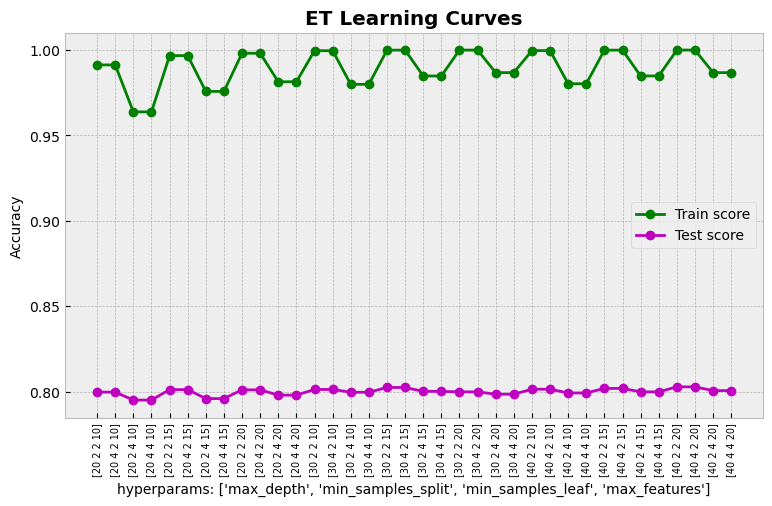

In [188]:
cv_res = pd.DataFrame(tuning_et.cv_results_)

plt.figure(figsize=(9,5))
plot_scores_vs_params(cv_res, title='ET Learning Curves',
                      param_names=['max_depth', 'min_samples_split','min_samples_leaf',
                                   'max_features'] )

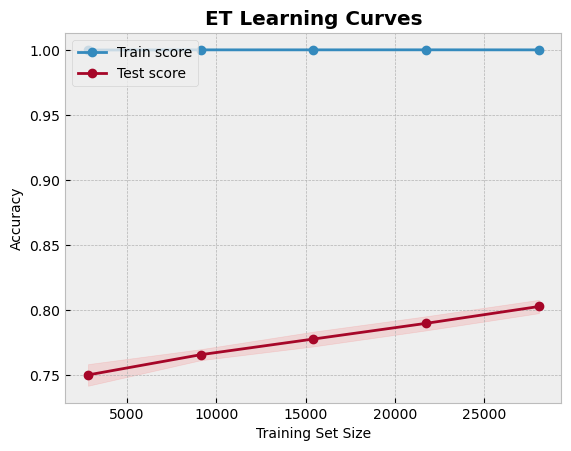

In [189]:
plot_learning_curves(best_et, X_train_sc_rfe, y_train, cv=cv,  
                     title='ET Learning Curves', train_sizes=np.linspace(0.1,1.,5))

#### __Confusion Matrix and the ROC Curve__

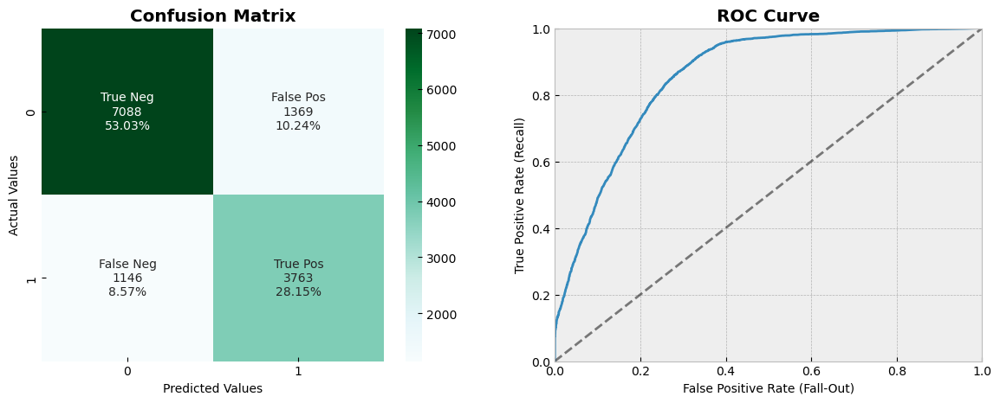

In [190]:
# Calculate the confusion matrix
conf_mx = confusion_matrix(y_val, best_et.predict(X_val_sc_rfe))

# Get the scores of all instances in the validation set.
y_scores = cross_val_predict(best_et, X_val_sc_rfe, y_val, cv=cv,
                             method='predict_proba')[:,1]
# Calculate the fpr and tpr
fpr,tpr, thresholds = roc_curve(y_val, y_scores)

# Plot the confusion matrix and the ROC curve.
plt.figure(figsize=(14,5))

plt.subplot(121)
plot_confusion_matrix(conf_mx, cmap='BuGn')
plt.title('Confusion Matrix')

plt.subplot(122)
plot_roc_curve(fpr, tpr)

In [191]:
roc_auc_score(y_val, best_et.predict(X_val_sc_rfe))

0.8023367490045202

#### __Precision/Recall Curves__

Recall 0.744
Precision 0.673


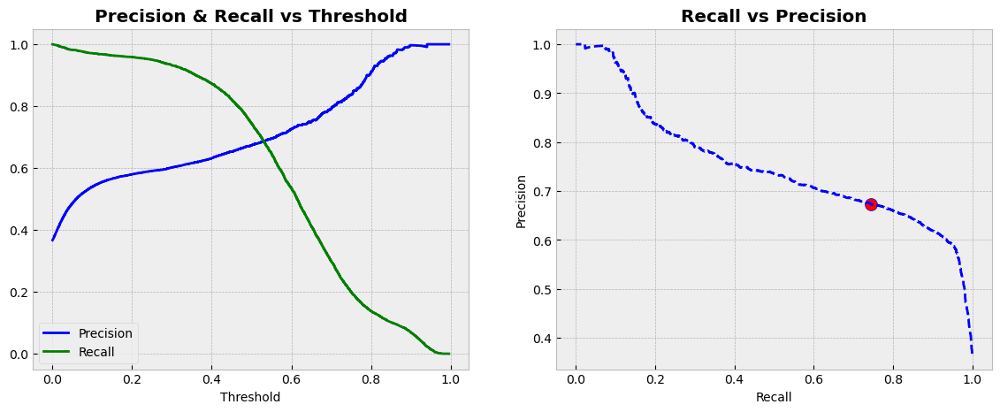

In [192]:
# Calculate precisions, recalls for each threshold.
precisions, recalls, thresholds = precision_recall_curve(y_val, y_scores)

# Get the recall and precision of a model.
val_recall = cross_val_score(best_et, X_val_sc_rfe, y_val, scoring='recall', cv=cv).mean()
val_prec = cross_val_score(best_et, X_val_sc_rfe, y_val, scoring='precision', cv=cv).mean()
print('Recall {}'.format(val_recall.round(3)))
print('Precision {}'.format(val_prec.round(3)))

# Plot the curves
plt.figure(figsize=(14,5))
plt.subplot(121)
plot_precision_recall_vs_threshold(precisions, recalls, thresholds)

plt.subplot(122)
plot_precision_vs_recall(precisions, recalls)
plt.scatter([val_recall], [val_prec], c='r', s=100, edgecolor='b');

In [193]:
print(classification_report(y_val, best_et.predict(X_val_sc_rfe),))

              precision    recall  f1-score   support

           0       0.86      0.84      0.85      8457
           1       0.73      0.77      0.75      4909

    accuracy                           0.81     13366
   macro avg       0.80      0.80      0.80     13366
weighted avg       0.81      0.81      0.81     13366



Alright, we got the accuracy of 77.32% for the tuned ET, which is slightly higher than for baseline ET (76.53%). However, we got high recall alongside high precision, so let's try to increase the accuracy now.

#### __Adjusting the Threshold__

The default threshold value for `ExtraTreesClassifier` in scikit-learn is 0.5, so we'll try changing it around in attempt to maximize the accuracy and recall.

In [194]:
class CustomExtraTreesClassifier(CustomThresholdMixin, ExtraTreesClassifier):
    """
    Classifier that inherits from ExtraTreesClassifier and adds a custom threshold parameter.
    """
    def __init__(self, max_depth, min_samples_leaf, n_estimators, random_state=SEED, threshold=0.5, **kwargs):
        super().__init__(threshold=threshold)
        ExtraTreesClassifier.__init__(self, max_depth=max_depth, min_samples_leaf=min_samples_leaf, 
                                      n_estimators=n_estimators, random_state=random_state)
        
    def predict_proba(self, X):
        return super().predict_proba(X)
    
    def predict(self, X):
        return super().predict(X)

__Max Accuracy Threshold__

In [195]:
# Define a model with the custom threshold parameter.
et_no_threshold = CustomExtraTreesClassifier(**best_et.get_params()).fit(X_train_sc_rfe, y_train)

# Calculate the highest accuracy possible for the model.
threshold, max_accuracy, max_recall, max_prec = et_no_threshold\
    .threshold_from_optimal_accuracy(X_val_sc_rfe, y_val)

threshold, max_accuracy, max_recall, max_prec

(0.4982205180305837, 0.7747269190483316, 0.774088409044612, 0.6663159740487463)

In [196]:
# A model with the threshold that gives the highest accuracy.
et_threshold = CustomExtraTreesClassifier(threshold=threshold, 
                                          **best_et.get_params()).fit(X_train_sc_rfe, y_train)

# Check the scores.
tr_acc = cross_val_score(et_threshold, X_train_sc_rfe, y_train, cv=cv, 
                         scoring='accuracy').mean().round(4)
val_acc =  cross_val_score(et_threshold, X_val_sc_rfe, y_val, cv=cv, 
                           scoring='accuracy').mean().round(4)
rec = cross_val_score(et_threshold, X_val_sc_rfe, y_val, cv=cv, 
                      scoring='recall').mean().round(3)

print(f"Training accuracy (recall={rec}): {tr_acc}\nValidation accuracy (recall={rec}): {val_acc}")

Training accuracy (recall=0.774): 0.8013
Validation accuracy (recall=0.774): 0.7747


__Custom Recall Threshold__

In [197]:
desired_recall = .82

# Calculate the threshold a model should have to reach the desired recall.
threshold_custom_recall, prec_custom_recall = et_no_threshold\
    .threshold_from_desired_recall(X_val_sc_rfe, y_val, desired_recall=desired_recall)
threshold_custom_recall, prec_custom_recall

(0.4810269310043307, 0.7123893805309734)

In [198]:
# A model with the threshold that guarantees the desired recall.
et_recall_threshold = CustomExtraTreesClassifier(threshold=threshold_custom_recall, 
                                 **best_et.get_params()).fit(X_train_sc_rfe, y_train)

# Compare the scores.
train_acc = cross_val_score(et_recall_threshold, X_train_sc_rfe, y_train, cv=cv, 
                            scoring='accuracy').mean().round(4)
val_acc = cross_val_score(et_recall_threshold, X_val_sc_rfe, y_val, cv=cv, 
                          scoring='accuracy').mean().round(4)

print(f"Training accuracy (recall={desired_recall}): {train_acc}")
print(f"Validation accuracy (recall={desired_recall}): {val_acc}")

Training accuracy (recall=0.82): 0.8006
Validation accuracy (recall=0.82): 0.7723


__Comparison__

Text(0.5, 1.0, 'Confusion Matrix (Recall  Threshold)')

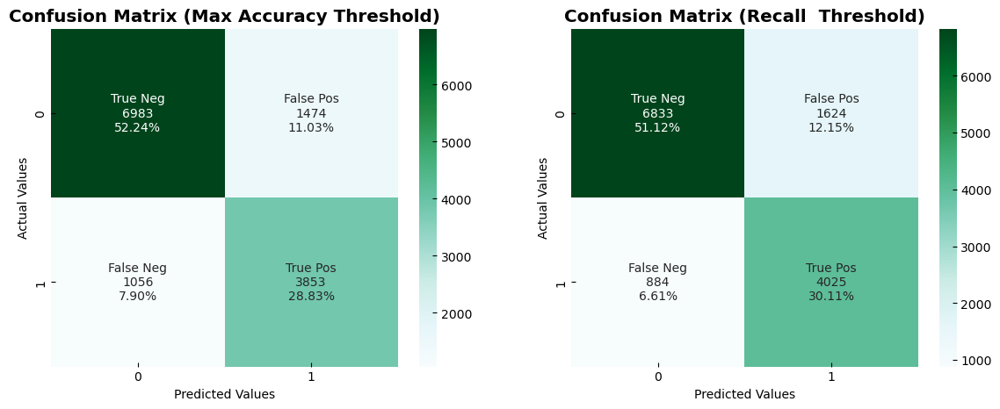

In [199]:
plt.figure(figsize=(14,5))
plt.subplot(121)
conf_mx = confusion_matrix(y_val, et_threshold.predict(X_val_sc_rfe))
plot_confusion_matrix(conf_mx, cmap='BuGn')
plt.title('Confusion Matrix (Max Accuracy Threshold)')

plt.subplot(122)
conf_mx = confusion_matrix(y_val, et_recall_threshold.predict(X_val_sc_rfe))
plot_confusion_matrix(conf_mx, cmap='BuGn')
plt.title('Confusion Matrix (Recall  Threshold)')

The max accuracy result looks much better, because it increases recall and accuracy at the same time, whilst the recall threshold gives us only a higher recall. So we'll pick the first one to be our final model.

#### Test Results

In [200]:
cross_val_score(et_threshold, X_test_sc_rfe, y_test, cv=cv, scoring='accuracy').mean().round(4)

0.7713

In [201]:
test_results = test_results.append({
    'Model':'Extra-Trees', 
    'Accuracy': cross_val_score(et_threshold, X_test_sc_rfe, y_test, cv=cv, 
                                scoring='accuracy').mean().round(4)*100,
    'Recall': cross_val_score(et_threshold, X_test_sc_rfe, y_test, cv=cv, 
                              scoring='recall').mean().round(3),
    'Precision': cross_val_score(et_threshold, X_test_sc_rfe, y_test, cv=cv, 
                                 scoring='precision').mean().round(3),
    'ROC AUC': roc_auc_score(y_test, et_threshold.predict(X_test_sc_rfe)).round(3)
}, ignore_index=True)
test_results

,Model,Accuracy,Recall,Precision,ROC AUC
0,Logistic Regression,74.53,0.714,0.637,0.739
1,SGD,74.65,0.767,0.628,0.748
2,KNN,76.56,0.741,0.661,0.794
3,CART,73.52,0.725,0.619,0.747
4,AdaBoost,75.43,0.708,0.653,0.753
5,Random Forest,77.34,0.732,0.677,0.794
6,Extra-Trees,77.13,0.760,0.665,0.805


<a id="bagging"></a>
# 6.8. Bagging Classifier

One way to get a diverse set of classifiers is to use the same training algorithm for every predictor, but to train them on differenet random subset of the training set. When the sampling is performed with replacement (training instances are sampled several times not only across multiple estimators, but for the same predictor too), this approach is called _bagging_. Generally, the ensemble of the classifiers tends to give better results than just each individual classifier. 

With bagging, we can as well use the _oob score_ to evaluate the the performance of the ensemble.

Hyperparameters: `n_estimators`, `max_features`, `bootstrap`.



In [202]:
bag_clf = BaggingClassifier(random_state=SEED)

#### __Recursive Feature Elimination (RFE)__

In [203]:
# Generate models with base estimator being CART and different number of features.
models=dict()
for i in range(10,25):
    rfe = RFE(estimator=DecisionTreeClassifier(random_state=SEED), n_features_to_select=i)
    models[str(i)] = Pipeline(steps=[('feat_select',rfe), ('model',bag_clf)])
    
# evaluate the models on the validation set.
results = evaluate_models(X_train_sc, y_train, X_val_sc, y_val, models)
plot_boxplot_summary(results, color=None, xlabel='features selected', 
            ylabel='Accuracy', title='Exploring n_features_to_select (RFE for BaggingClassifier)')

>> 10: 0.7400 (+/- 0.0074)
>> 11: 0.7424 (+/- 0.0101)
>> 12: 0.7427 (+/- 0.0112)
>> 13: 0.7441 (+/- 0.0074)
>> 14: 0.7431 (+/- 0.0100)
>> 15: 0.7458 (+/- 0.0105)
>> 16: 0.7458 (+/- 0.0102)
>> 17: 0.7448 (+/- 0.0090)
>> 18: 0.7503 (+/- 0.0125)
>> 19: 0.7471 (+/- 0.0137)
>> 20: 0.7476 (+/- 0.0103)
>> 21: 0.7454 (+/- 0.0084)
>> 22: 0.7448 (+/- 0.0109)
>> 23: 0.7494 (+/- 0.0128)
>> 24: 0.7464 (+/- 0.0111)


The `n_features_to_select=18` and `n_features_to_select=23` look pretty decent, so we'll use one of these.

In [204]:
# Reduce the dimensionality of the data.
rfe = RFE(estimator=DecisionTreeClassifier(random_state=SEED),
          n_features_to_select=18).fit(X_train_sc, y_train)
X_train_sc_rfe, X_val_sc_rfe = rfe.transform(X_train_sc), rfe.transform(X_val_sc)
X_test_sc_rfe = rfe.transform(X_test_sc)

bag_clf.fit(X_train_sc_rfe, y_train)

BaggingClassifier(random_state=19)

In [205]:
tr_acc = cross_val_score(bag_clf, X_train_sc_rfe, y_train, cv=cv,scoring='accuracy').mean().round(4)
val_acc = cross_val_score(bag_clf, X_val_sc_rfe, y_val, cv=cv,scoring='accuracy').mean().round(4)

print("Train accuracy: {}\nValid accuracy: {}".format(tr_acc, val_acc))

Train accuracy: 0.782
Valid accuracy: 0.7483


#### __Exploring the hyperparameters__

In [206]:
# Generate BaggingClassifier models with different maximum depths for a base estimator.
models = dict()
depths = [4,10,15,20]

for d in depths:
    models[str(d)] = BaggingClassifier(DecisionTreeClassifier(max_depth=d),random_state=SEED)
    
results = evaluate_models(X_train_sc_rfe, y_train, X_val_sc_rfe, y_val, models)
plot_boxplot_summary(results, color=None, xlabel='max_depth', 
                    ylabel='Accuracy', title='Exploring max_depth (BaggingClassifier)')

>> 4: 0.7439 (+/- 0.0103)
>> 10: 0.7531 (+/- 0.0076)
>> 15: 0.7565 (+/- 0.0080)
>> 20: 0.7473 (+/- 0.0115)


In [207]:
# Generate BaggingClassifier models with different maximum features for a base estimator.
models = dict()
max_features = np.arange(6,19,1)

for feat in max_features:
    models[str(feat)] = BaggingClassifier(DecisionTreeClassifier(max_features=feat),
                                          random_state=SEED)
    
results = evaluate_models(X_train_sc_rfe, y_train, X_val_sc_rfe, y_val, models)
plot_boxplot_summary(results, color=None, xlabel='max_features', 
                    ylabel='Accuracy', title='Exploring max_features (BaggingClassifier)')

>> 6: 0.7470 (+/- 0.0109)
>> 7: 0.7416 (+/- 0.0126)
>> 8: 0.7480 (+/- 0.0056)
>> 9: 0.7510 (+/- 0.0130)
>> 10: 0.7464 (+/- 0.0107)
>> 11: 0.7449 (+/- 0.0088)
>> 12: 0.7454 (+/- 0.0132)
>> 13: 0.7396 (+/- 0.0075)
>> 14: 0.7519 (+/- 0.0048)
>> 15: 0.7441 (+/- 0.0091)
>> 16: 0.7472 (+/- 0.0099)
>> 17: 0.7455 (+/- 0.0125)
>> 18: 0.7483 (+/- 0.0134)


#### __Fine-Tuning__

In [208]:
bag_clf = BaggingClassifier(DecisionTreeClassifier(random_state=SEED), n_jobs=-1, random_state=SEED)

param_grid = {
    'base_estimator__max_depth':[8,10,15,20],
    'base_estimator__min_samples_leaf':[2,4,6],
    'base_estimator__max_features':[10,18],
    'max_features':[10,15],
    'bootstrap':[True, False],
}

tuning_bag = GridSearchCV(bag_clf, param_grid, scoring='accuracy', n_jobs=-1, cv=cv,
                          return_train_score=True)
tuning_bag.fit(X_train_sc_rfe, y_train)

GridSearchCV(cv=StratifiedKFold(n_splits=10, random_state=19, shuffle=True),
             estimator=BaggingClassifier(base_estimator=DecisionTreeClassifier(random_state=19),
                                         n_jobs=-1, random_state=19),
             n_jobs=-1,
             param_grid={'base_estimator__max_depth': [8, 10, 15, 20],
                         'base_estimator__max_features': [10, 18],
                         'base_estimator__min_samples_leaf': [2, 4, 6],
                         'bootstrap': [True, False], 'max_features': [10, 15]},
             return_train_score=True, scoring='accuracy')

In [209]:
best_bag = tuning_bag.best_estimator_
best_bag.n_estimators = 300
best_bag.fit(X_train_sc_rfe, y_train)

BaggingClassifier(base_estimator=DecisionTreeClassifier(max_depth=20,
                                                        max_features=10,
                                                        min_samples_leaf=6,
                                                        random_state=19),
                  bootstrap=False, max_features=15, n_estimators=300, n_jobs=-1,
                  random_state=19)

In [210]:
tr_acc = cross_val_score(best_bag, X_train_sc_rfe,y_train,cv=cv,scoring='accuracy').mean().round(4)
val_acc = cross_val_score(best_bag, X_val_sc_rfe, y_val,cv=cv,scoring='accuracy').mean().round(4)

print("Train accuracy: {}\nValid accuracy: {}".format(tr_acc, val_acc))

Train accuracy: 0.7982
Valid accuracy: 0.7753


#### __Learning Curves__

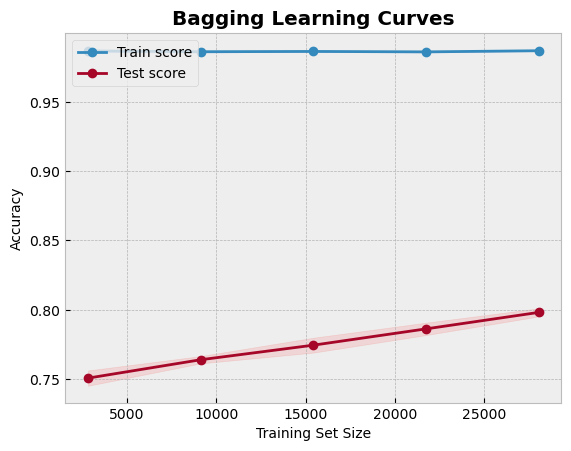

In [211]:
plot_learning_curves(best_bag, X_train_sc_rfe, y_train, cv=cv,  
                     title='Bagging Learning Curves', train_sizes=np.linspace(0.1,1.,5))

#### __Confusion Matrix and the ROC Curve__

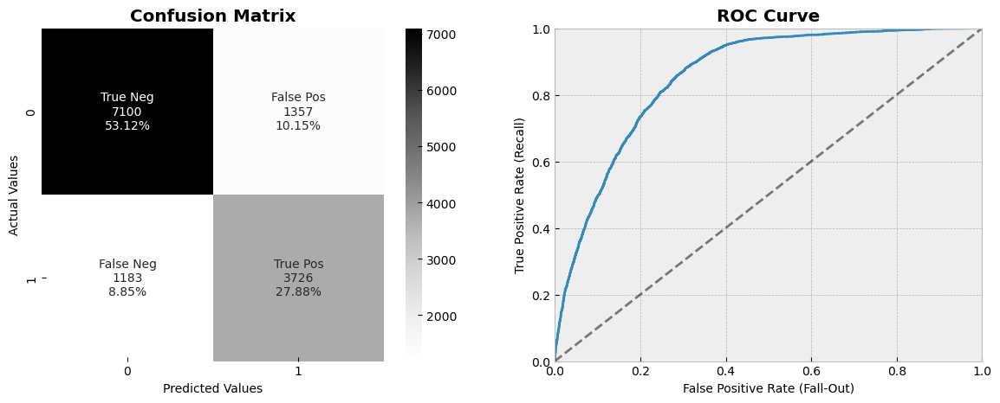

In [212]:
# Calculate the confusion matrix
conf_mx = confusion_matrix(y_val, best_bag.predict(X_val_sc_rfe))

# Get the scores of all instances in the validation set.
y_scores = cross_val_predict(best_bag, X_val_sc_rfe, y_val, cv=cv,
                             method='predict_proba')[:,1]
# Calculate the fpr and tpr
fpr,tpr, thresholds = roc_curve(y_val, y_scores)

# Plot the confusion matrix and the ROC curve.
plt.figure(figsize=(14,5))

plt.subplot(121)
plot_confusion_matrix(conf_mx, cmap='Greys')
plt.title('Confusion Matrix')

plt.subplot(122)
plot_roc_curve(fpr, tpr)

In [213]:
roc_auc_score(y_val, best_bag.predict(X_val_sc_rfe))

0.7992776321411039

#### __Precision/Recall Curves__

Recall 0.726
Precision 0.683


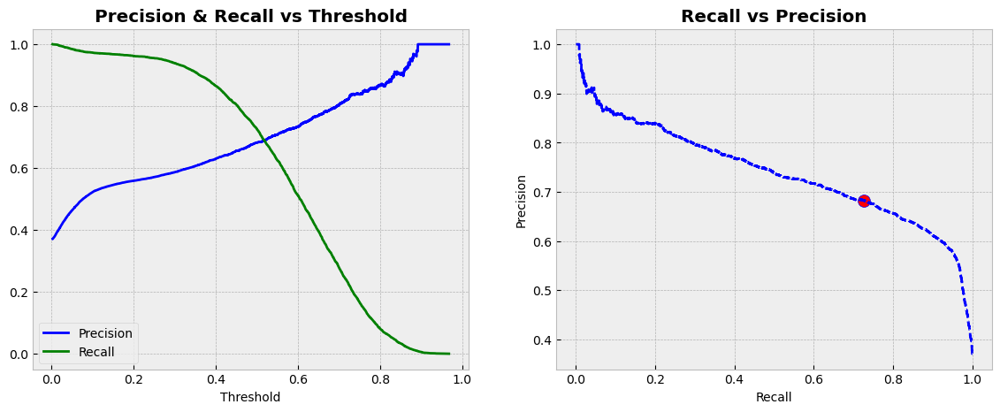

In [214]:
# Calculate precisions, recalls.
precisions, recalls, thresholds = precision_recall_curve(y_val, y_scores)

# Get the recall and precision of a model.
val_recall = cross_val_score(best_bag, X_val_sc_rfe, y_val, scoring='recall', cv=cv).mean()
val_prec = cross_val_score(best_bag, X_val_sc_rfe, y_val, scoring='precision', cv=cv).mean()
print('Recall {}'.format(val_recall.round(3)))
print('Precision {}'.format(val_prec.round(3)))

# Plot the curves
plt.figure(figsize=(14,5))
plt.subplot(121)
plot_precision_recall_vs_threshold(precisions, recalls, thresholds)

plt.subplot(122)
plot_precision_vs_recall(precisions, recalls)
plt.scatter([val_recall], [val_prec], c='r', s=100, edgecolor='b');

#### __Test Results__

In [215]:
cross_val_score(best_bag, X_test_sc_rfe, y_test, cv=cv, scoring='accuracy').mean().round(4)

0.763

In [216]:
test_results = test_results.append({
    'Model':'Bagging', 
    'Accuracy': cross_val_score(best_bag, X_test_sc_rfe, y_test, cv=cv, 
                                scoring='accuracy').mean().round(4)*100,
    'Recall': cross_val_score(best_bag, X_test_sc_rfe, y_test, cv=cv, 
                              scoring='recall').mean().round(3),
    'Precision': cross_val_score(best_bag, X_test_sc_rfe, y_test, cv=cv, 
                                 scoring='precision').mean().round(3),
    'ROC AUC': roc_auc_score(y_test, best_bag.predict(X_test_sc_rfe)).round(3)
}, ignore_index=True)
test_results

,Model,Accuracy,Recall,Precision,ROC AUC
0,Logistic Regression,74.53,0.714,0.637,0.739
1,SGD,74.65,0.767,0.628,0.748
2,KNN,76.56,0.741,0.661,0.794
3,CART,73.52,0.725,0.619,0.747
4,AdaBoost,75.43,0.708,0.653,0.753
5,Random Forest,77.34,0.732,0.677,0.794
6,Extra-Trees,77.13,0.760,0.665,0.805
7,Bagging,76.30,0.710,0.667,0.796


<a id="conclude"></a>
# 7. Conclusions

In this work we've been trying to build a model that correctly classifies smokers and non-smokers using the data from regular health check-ups. We've made an attempt at fine-tuning a couple of classifiers specified in the table below. Unfortunately, we couldn't cross the accuracy threshold of 80% (as of this version of notebook), __the highest accuracy that was reached is 77.34% using Random Forest model at 0.732 recall and 0.677 precision.__ This model turns out to perform better than any other in the table, though all the accuracies actually are roughly in the range from 73% to 78%.

That said, __Random Forest__ outperforms any other model, followed right after by Extra Trees, KNN, and Bagging Classifier.

In [217]:
test_results.sort_values(by='Accuracy', ascending=False).set_index('Model').style.background_gradient(cmap='coolwarm')

,Accuracy,Recall,Precision,ROC AUC
Model,,,,
Random Forest,77.340000,0.732000,0.677000,0.794000
Extra-Trees,77.130000,0.760000,0.665000,0.805000
KNN,76.560000,0.741000,0.661000,0.794000
Bagging,76.300000,0.710000,0.667000,0.796000
AdaBoost,75.430000,0.708000,0.653000,0.753000
SGD,74.650000,0.767000,0.628000,0.748000
Logistic Regression,74.530000,0.714000,0.637000,0.739000
CART,73.520000,0.725000,0.619000,0.747000


<a id="limits_future"></a>
# 8. Limitations and Future Work

First of all, it should be mentioned that, as for any work of mine, there is a lot that could have been done differently and thus would have given much better results. In this project, some steps are obviously not shown to save the reader's time and also to decrease the runtime of this notebook. Due to the same reasons I restrained myself from using greater numbers for n_estimators parameter to get better results when I was sure I could or when choosing the base estimators for RFE and so forth. I haven't explored every possible technique for increasing the accuracy of any model in this project, because it was not essentially my goal. Of course, other techniques could be used for the model of interest, but I will leave the explanation and the use of these methods to other publications/notebooks/etc. I was trying to find out which models should be chosen to be further on explored for this particular dataset, not to focus on any particular model.

Basically, this work is still in progress since I have not yet touched more advanced models or made use of outlier detection technique mentioned in spot-checking at all. Also, the notebook could be made more concise. That aside, let me give you a quick overview of things that I was planning to do:

* Check the performance of more advanced models such as Boosting/Stacking, XGBoost, Light GBM, NN.
* Explore outlier detection techniques.
* Explore more feature selection techniques.
* and more..?

Feel free to leave any comments, suggestions concerning this project. Thank you.